# Simple Linear Regression

In [1]:
import numpy as np
import tensorflow as tf
import statsmodels.api as sm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import unipy.dataset.api as dm

/home/pydemia/apps/anaconda3/envs/Tensorflow/lib/python3.5/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [2]:
dm.init()

['adult', 'titanic', 'winequality_white', 'air_quality', 'nutrients', 'german_credit_scoring_fars2008', 'anscombe', 'births_small', 'iris', 'births_big', 'car90', 'tips', 'winequality_red', 'cars']


In [3]:
#dm.init()
#data = dm.load('winequality_red')
data = dm.load('winequality_red')
data

Dataset : winequality_red


,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
5,7.4,0.660,0.00,1.8,0.075,13.0,40.0,0.99780,3.51,0.56,9.4,5
6,7.9,0.600,0.06,1.6,0.069,15.0,59.0,0.99640,3.30,0.46,9.4,5
7,7.3,0.650,0.00,1.2,0.065,15.0,21.0,0.99460,3.39,0.47,10.0,7
8,7.8,0.580,0.02,2.0,0.073,9.0,18.0,0.99680,3.36,0.57,9.5,7
9,7.5,0.500,0.36,6.1,0.071,17.0,102.0,0.99780,3.35,0.80,10.5,5


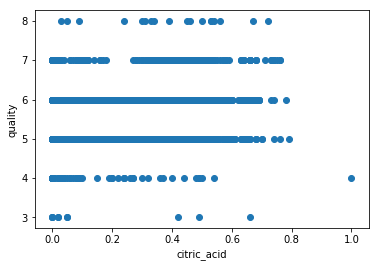

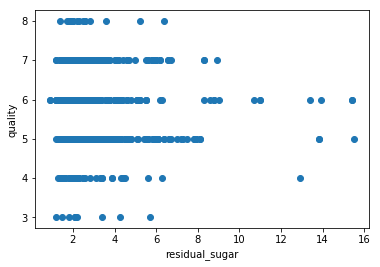

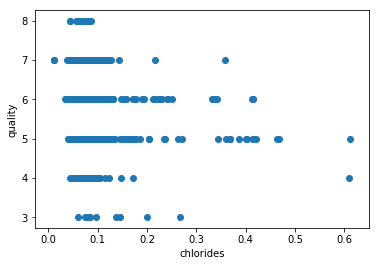

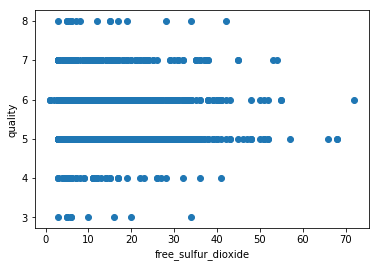

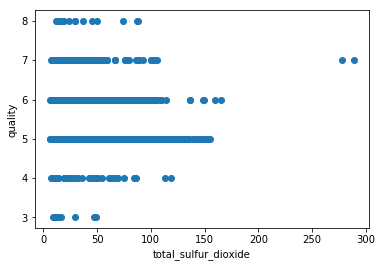

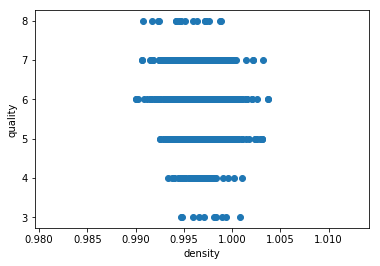

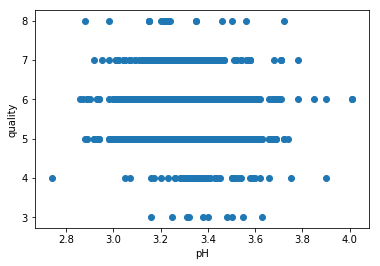

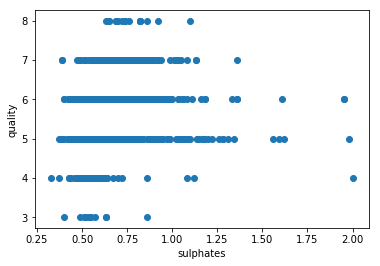

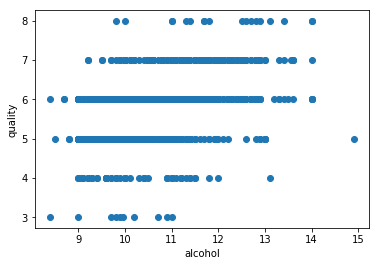

In [9]:
for _ in data.columns[2:-1]:
    x = data[_]
    y = data['quality']
    plt.scatter(x, y)
    plt.xlabel(_)
    plt.ylabel('quality')
    plt.show()

In [5]:
data.corr()

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,pH,sulphates,alcohol,quality
fixed_acidity,1.000000,-0.256131,0.671703,0.114777,0.093705,-0.153794,-0.113181,0.668047,-0.682978,0.183006,-0.061668,0.124052
volatile_acidity,-0.256131,1.000000,-0.552496,0.001918,0.061298,-0.010504,0.076470,0.022026,0.234937,-0.260987,-0.202288,-0.390558
citric_acid,0.671703,-0.552496,1.000000,0.143577,0.203823,-0.060978,0.035533,0.364947,-0.541904,0.312770,0.109903,0.226373
residual_sugar,0.114777,0.001918,0.143577,1.000000,0.055610,0.187049,0.203028,0.355283,-0.085652,0.005527,0.042075,0.013732
chlorides,0.093705,0.061298,0.203823,0.055610,1.000000,0.005562,0.047400,0.200632,-0.265026,0.371260,-0.221141,-0.128907
free_sulfur_dioxide,-0.153794,-0.010504,-0.060978,0.187049,0.005562,1.000000,0.667666,-0.021946,0.070377,0.051658,-0.069408,-0.050656
total_sulfur_dioxide,-0.113181,0.076470,0.035533,0.203028,0.047400,0.667666,1.000000,0.071269,-0.066495,0.042947,-0.205654,-0.185100
density,0.668047,0.022026,0.364947,0.355283,0.200632,-0.021946,0.071269,1.000000,-0.341699,0.148506,-0.496180,-0.174919
pH,-0.682978,0.234937,-0.541904,-0.085652,-0.265026,0.070377,-0.066495,-0.341699,1.000000,-0.196648,0.205633,-0.057731
sulphates,0.183006,-0.260987,0.312770,0.005527,0.371260,0.051658,0.042947,0.148506,-0.196648,1.000000,0.093595,0.251397


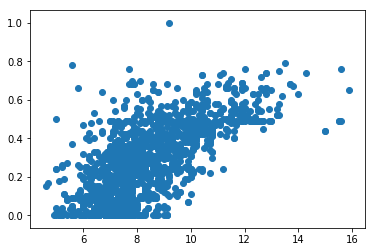

In [6]:
x = data['fixed_acidity']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('fixed_acidity')
plt.ylabel('citric_acid')
plt.show()

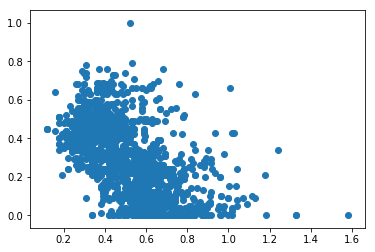

In [7]:
x = data['volatile_acidity']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('volatile_acidity')
plt.ylabel('citric_acid')
plt.show()

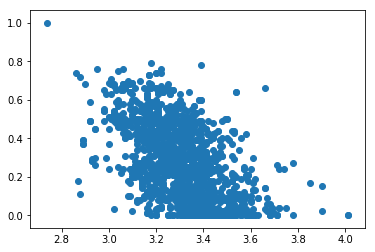

In [8]:
x = data['pH']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('pH')
plt.ylabel('citric_acid')
plt.show()

## Linear Regression with `statsmodel`

In [9]:
rowFlag = int(data.shape[0] * 7 /10)
colFlag = int(data.shape[1])
trainSet = data.iloc[:rowFlag, :]
testSet  = data.iloc[rowFlag:, :]

trainX0 = trainSet[['fixed_acidity']].values
trainX1 = trainSet[['fixed_acidity', 'volatile_acidity']].values
trainX2 = trainSet[['fixed_acidity', 'volatile_acidity', 'pH']].values

trainY = trainSet[['citric_acid']].values
testY  = testSet[['citric_acid']].values

ols_trainX1 = trainX1.copy()
ols_trainX1 = sm.add_constant(ols_trainX1)

est = sm.OLS(trainY, ols_trainX1).fit()
est.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.610
Model:                            OLS   Adj. R-squared:                  0.609
Method:                 Least Squares   F-statistic:                     871.7
Date:                Mon, 26 Jun 2017   Prob (F-statistic):          9.71e-229
Time:                        05:50:31   Log-Likelihood:                 746.75
No. Observations:                1119   AIC:                            -1488.
Df Residuals:                    1116   BIC:                            -1472.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0281      0.025     -1.144      0.253      -0.076       0.020
x1             0.0637      0.002     29.576      0.000       0.059       0.068
x2            -0.4378      0.022    -20.272      0.000      -0.480      -0.395
==============================================================================
Omnibus:                      177.067   Durbin-Watson:                   1.546
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              419.872
Skew:                           0.869   Prob(JB):                     6.70e-92
Kurtosis:                       5.446   Cond. No.                         72.0
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

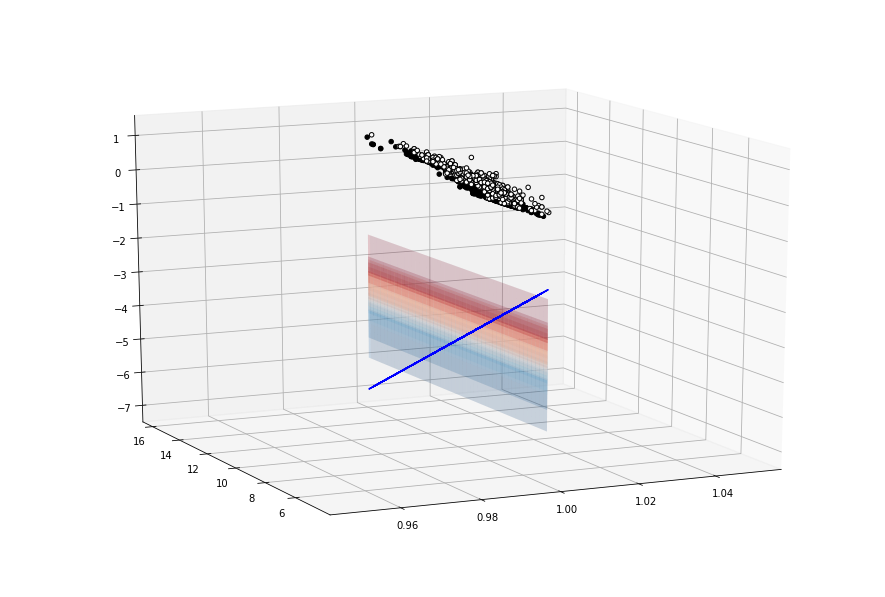

In [10]:
x0 = ols_trainX1.T[0]
x1 = ols_trainX1.T[1]

Z = est.params[0] + est.params[1] * x0 + est.params[2] * x1

fig = plt.figure(figsize=(12, 8))
ax = Axes3D(fig, azim=-115, elev=15)
#ax = fig.add_subplot(111, projection='3d')

x0 = ols_trainX1.T[0]
x1 = ols_trainX1.T[1]
xx0, xx1 = np.meshgrid(np.linspace(x0.min(), x0.max(), len(x0)), 
                       np.linspace(x1.min(), x1.max(), len(x1)))

Z0 = est.params[0] + est.params[1] * xx0 + est.params[2] * xx1
Z1 = est.params[0] + est.params[1] * x0 + est.params[2] * x1
surf = ax.plot_surface(xx0, xx1, Z1, cmap=plt.cm.RdBu_r, alpha=.1, linewidth=0)

resid = trainY.T[0] - est.predict(ols_trainX1)
ax.scatter(x0[resid >= 0], x1[resid >= 0], trainY[resid >= 0], color='black', alpha=1.0, facecolor='white')
ax.scatter(x0[resid < 0], x1[resid < 0], trainY[resid < 0], color='black', alpha=1.0)
ax.plot(x0, x1, Z1, color='blue', label='parametric curve')

plt.show()

---
## Start

In [10]:
learning_rate = .01
training_epochs = 10000  #
display_step = 100

In [11]:
rowFlag = int(data.shape[0] * 7 /10)
colFlag = int(data.shape[1])
trainSet = data.iloc[:rowFlag, :]
testSet  = data.iloc[rowFlag:, :]

trainX0 = trainSet[['fixed_acidity']].values
trainX1 = trainSet[['fixed_acidity', 'volatile_acidity']].values
trainX2 = trainSet[['fixed_acidity', 'volatile_acidity', 'pH']].values

trainY = trainSet[['citric_acid']].values
testY  = testSet[['citric_acid']].values

nDim0 = trainX0.shape[1]
nDim1 = trainX1.shape[1]
nDim2 = trainX2.shape[1]

In [12]:
print(trainX0.shape)
print(trainX1.shape)
print(trainX2.shape)
print(trainY.shape)

(1119, 1)
(1119, 2)
(1119, 3)
(1119, 1)


# Using `ndarray`, calculated by `tensorflow`

In [13]:
# Variables
trainX0
trainY

W0 = tf.Variable(tf.random_uniform([1], -1, 1), name='weight')
b0 = tf.Variable(tf.random_uniform([1], -1, 1), name='bias')

In [14]:
y_0 = trainX0 * W0 + b0
costFunc = tf.reduce_mean(tf.square(y_0 - trainY))  # Mean Squared Error

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model0 = optimizer.minimize(costFunc)

In [15]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        sess.run(model0)

        if step % display_step == 0:
            print(step, sess.run(W0), sess.run(b0))

0 [-0.34571189] [-0.24073453]
100 [ 0.05888571] [-0.20891589]
200 [ 0.06018655] [-0.22068141]
300 [ 0.06138609] [-0.23153077]
400 [ 0.06249222] [-0.24153523]
500 [ 0.06351221] [-0.25076064]
600 [ 0.06445278] [-0.25926772]
700 [ 0.0653201] [-0.26711228]
800 [ 0.06611987] [-0.27434587]
900 [ 0.06685738] [-0.28101629]
1000 [ 0.06753746] [-0.28716734]
1100 [ 0.06816457] [-0.29283932]
1200 [ 0.06874285] [-0.2980696]
1300 [ 0.06927609] [-0.30289257]
1400 [ 0.06976782] [-0.30734]
1500 [ 0.07022125] [-0.31144112]
1600 [ 0.07063942] [-0.31522322]
1700 [ 0.07102498] [-0.31871051]
1800 [ 0.07138053] [-0.32192627]
1900 [ 0.07170838] [-0.32489157]
2000 [ 0.0720107] [-0.32762593]
2100 [ 0.07228948] [-0.33014745]
2200 [ 0.07254656] [-0.33247256]
2300 [ 0.07278363] [-0.33461666]
2400 [ 0.07300222] [-0.33659375]
2500 [ 0.07320377] [-0.3384167]
2600 [ 0.07338964] [-0.34009784]
2700 [ 0.07356104] [-0.34164807]
2800 [ 0.07371909] [-0.3430776]
2900 [ 0.07386483] [-0.34439582]
3000 [ 0.07399924] [-0.3456114

### Using `tf.placeholder`

In [16]:
# Variables
trainX0
trainY

X0 = tf.placeholder(tf.float32, [None, nDim0])
Y_train = tf.placeholder(tf.float32, [None, 1])

W0 = tf.Variable(tf.random_uniform([nDim0, 1], -1, 1), name='weight')
b0 = tf.Variable(tf.random_uniform([1], -1, 1), name='bias')

In [17]:
y_pred = tf.add(tf.matmul(X0, W0), b0)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred)) /
                   tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model0 = optimizer.minimize(costFunc)

In [18]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X0: trainX0, Y_train: trainY}
        sess.run(model0, feed_dict=feedDict)

        if step % display_step == 0:
            print(step, sess.run(W0), sess.run(b0))

0 [[ 0.43311772]] [ 0.35647446]
100 [[ 0.00740659]] [ 0.25669122]
200 [[ 0.01271618]] [ 0.20866817]
300 [[ 0.0176123]] [ 0.16438483]
400 [[ 0.02212715]] [ 0.12354988]
500 [[ 0.02629043]] [ 0.08589477]
600 [[ 0.03012951]] [ 0.0511719]
700 [[ 0.03366964]] [ 0.01915296]
800 [[ 0.03693408]] [-0.01037261]
900 [[ 0.03994433]] [-0.03759899]
1000 [[ 0.04272016]] [-0.0627052]
1100 [[ 0.04527982]] [-0.08585633]
1200 [[ 0.04764018]] [-0.10720474]
1300 [[ 0.04981672]] [-0.12689063]
1400 [[ 0.05182377]] [-0.14504355]
1500 [[ 0.05367452]] [-0.16178289]
1600 [[ 0.05538117]] [-0.17721875]
1700 [[ 0.0569549]] [-0.19145255]
1800 [[ 0.0584061]] [-0.204578]
1900 [[ 0.05974428]] [-0.21668133]
2000 [[ 0.06097827]] [-0.22784215]
2100 [[ 0.06211615]] [-0.23813385]
2200 [[ 0.06316543]] [-0.2476242]
2300 [[ 0.06413301]] [-0.25637552]
2400 [[ 0.06502525]] [-0.26444536]
2500 [[ 0.06584796]] [-0.27188659]
2600 [[ 0.06660666]] [-0.27874857]
2700 [[ 0.06730624]] [-0.28507605]
2800 [[ 0.06795136]] [-0.29091087]
2900 

STEP:   0, MSE: 0.3017, R2: -6.6398
Weights: [[-0.03581749]], Bias: [ 0.11625034]


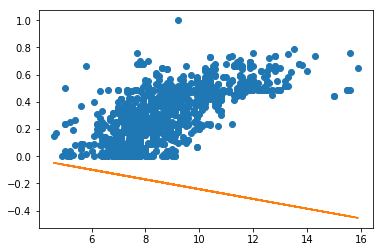

STEP: 100, MSE: 0.0292, R2: 0.2603
Weights: [[ 0.02638037]], Bias: [ 0.08508131]


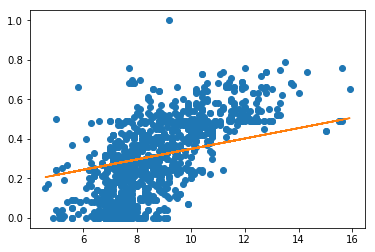

STEP: 200, MSE: 0.0280, R2: 0.2911
Weights: [[ 0.03021245]], Bias: [ 0.05042179]


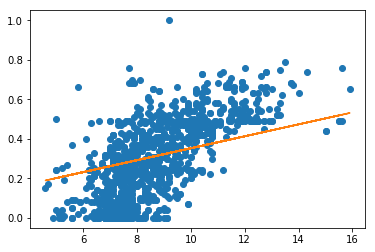

STEP: 300, MSE: 0.0270, R2: 0.3173
Weights: [[ 0.03374611]], Bias: [ 0.01846127]


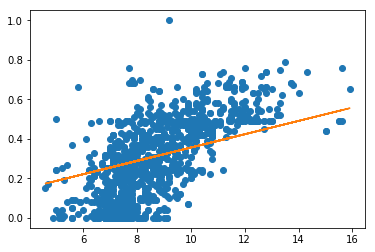

STEP: 400, MSE: 0.0261, R2: 0.3395
Weights: [[ 0.03700461]], Bias: [-0.01101044]


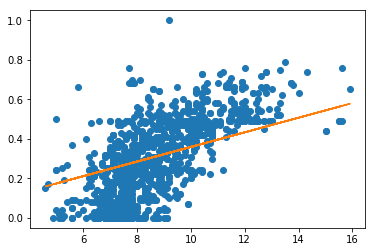

STEP: 500, MSE: 0.0253, R2: 0.3585
Weights: [[ 0.04000935]], Bias: [-0.03818715]


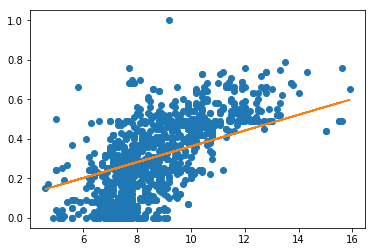

STEP: 600, MSE: 0.0247, R2: 0.3746
Weights: [[ 0.04278012]], Bias: [-0.06324758]


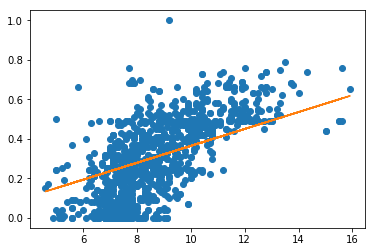

STEP: 700, MSE: 0.0242, R2: 0.3882
Weights: [[ 0.04533513]], Bias: [-0.08635651]


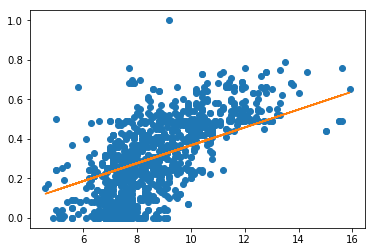

STEP: 800, MSE: 0.0237, R2: 0.3999
Weights: [[ 0.04769117]], Bias: [-0.10766596]


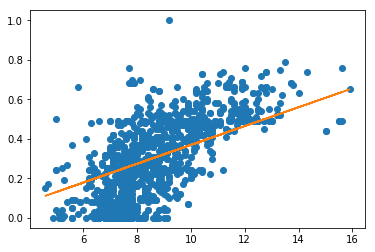

STEP: 900, MSE: 0.0233, R2: 0.4098
Weights: [[ 0.04986374]], Bias: [-0.12731597]


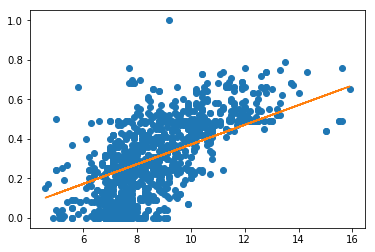

STEP: 1000, MSE: 0.0230, R2: 0.4182
Weights: [[ 0.05186713]], Bias: [-0.14543574]


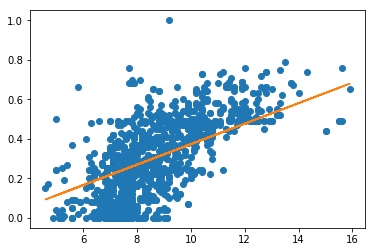

STEP: 1100, MSE: 0.0227, R2: 0.4254
Weights: [[ 0.05371451]], Bias: [-0.16214454]


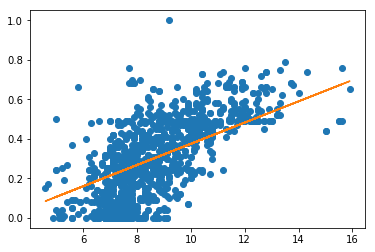

STEP: 1200, MSE: 0.0225, R2: 0.4314
Weights: [[ 0.05541804]], Bias: [-0.17755222]


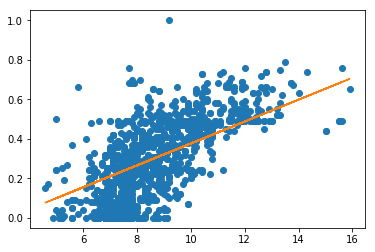

STEP: 1300, MSE: 0.0222, R2: 0.4366
Weights: [[ 0.05698891]], Bias: [-0.19176006]


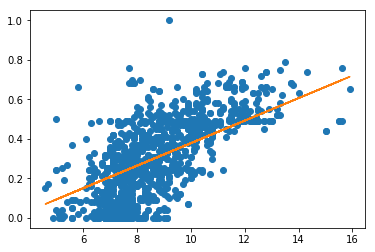

STEP: 1400, MSE: 0.0221, R2: 0.4410
Weights: [[ 0.05843745]], Bias: [-0.20486154]


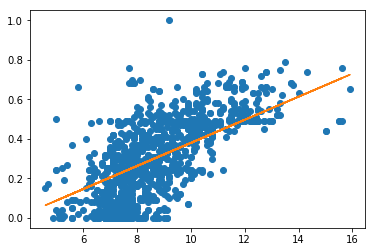

STEP: 1500, MSE: 0.0219, R2: 0.4448
Weights: [[ 0.0597732]], Bias: [-0.21694285]


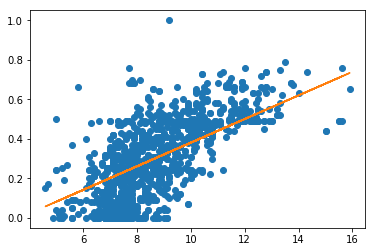

STEP: 1600, MSE: 0.0218, R2: 0.4479
Weights: [[ 0.06100493]], Bias: [-0.22808333]


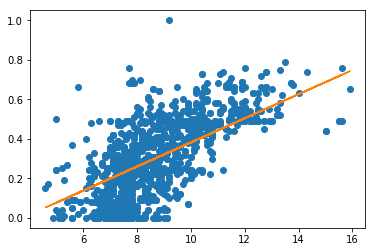

STEP: 1700, MSE: 0.0217, R2: 0.4506
Weights: [[ 0.06214075]], Bias: [-0.23835631]


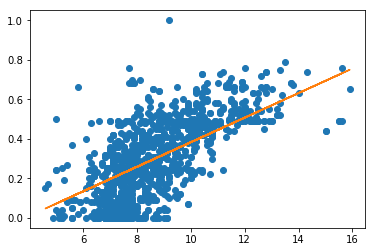

STEP: 1800, MSE: 0.0216, R2: 0.4529
Weights: [[ 0.0631881]], Bias: [-0.24782918]


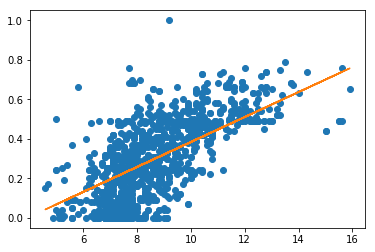

STEP: 1900, MSE: 0.0215, R2: 0.4549
Weights: [[ 0.06415391]], Bias: [-0.25656453]


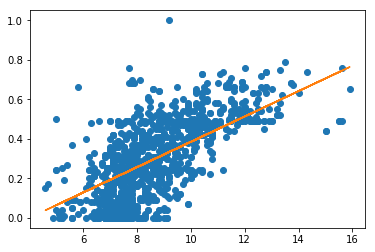

STEP: 2000, MSE: 0.0215, R2: 0.4566
Weights: [[ 0.0650445]], Bias: [-0.26461956]


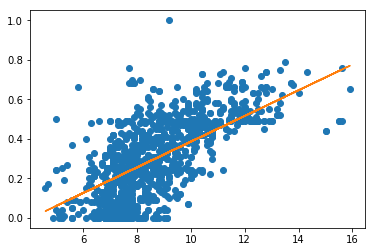

STEP: 2100, MSE: 0.0214, R2: 0.4580
Weights: [[ 0.06586578]], Bias: [-0.27204773]


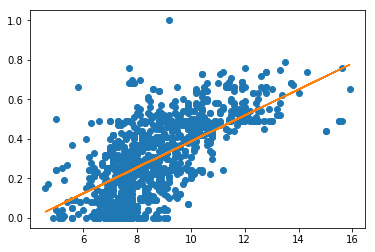

STEP: 2200, MSE: 0.0214, R2: 0.4592
Weights: [[ 0.06662308]], Bias: [-0.27889708]


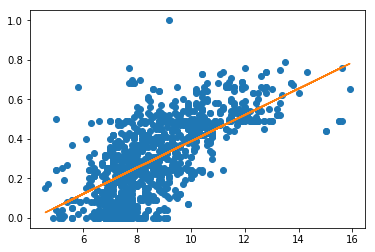

STEP: 2300, MSE: 0.0213, R2: 0.4602
Weights: [[ 0.0673214]], Bias: [-0.28521311]


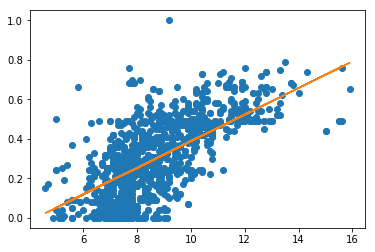

STEP: 2400, MSE: 0.0213, R2: 0.4611
Weights: [[ 0.06796534]], Bias: [-0.29103732]


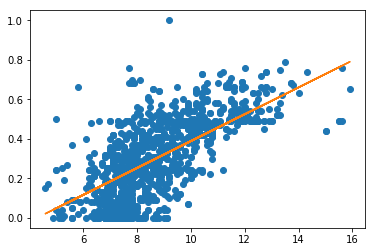

STEP: 2500, MSE: 0.0213, R2: 0.4618
Weights: [[ 0.06855913]], Bias: [-0.29640794]


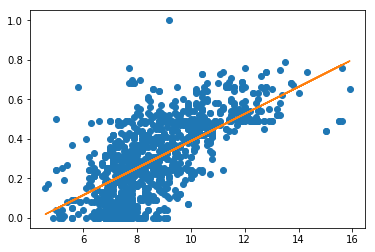

STEP: 2600, MSE: 0.0212, R2: 0.4624
Weights: [[ 0.0691067]], Bias: [-0.30136043]


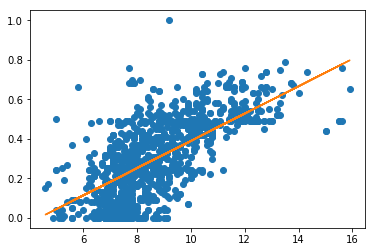

STEP: 2700, MSE: 0.0212, R2: 0.4630
Weights: [[ 0.06961161]], Bias: [-0.30592719]


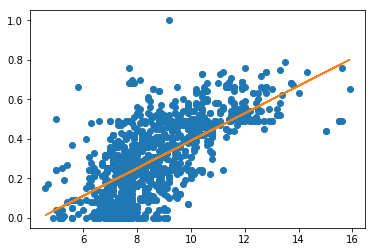

STEP: 2800, MSE: 0.0212, R2: 0.4634
Weights: [[ 0.0700772]], Bias: [-0.31013826]


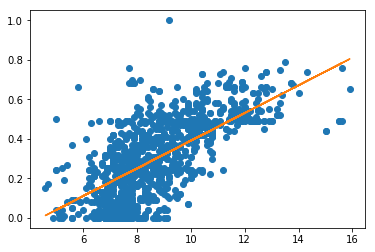

STEP: 2900, MSE: 0.0212, R2: 0.4638
Weights: [[ 0.07050656]], Bias: [-0.31402153]


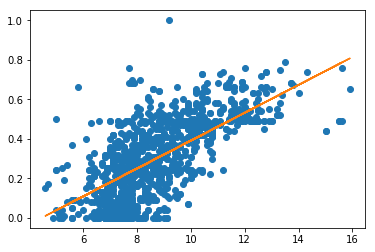

STEP: 3000, MSE: 0.0212, R2: 0.4641
Weights: [[ 0.07090243]], Bias: [-0.3176021]


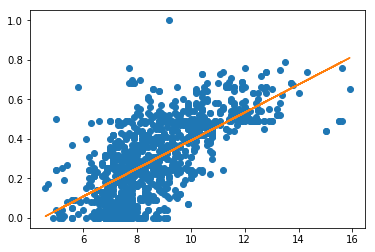

STEP: 3100, MSE: 0.0212, R2: 0.4644
Weights: [[ 0.07126752]], Bias: [-0.32090417]


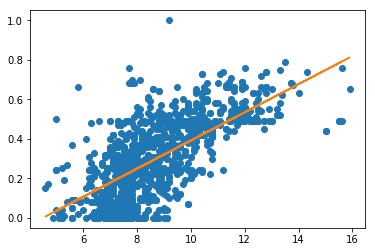

STEP: 3200, MSE: 0.0211, R2: 0.4647
Weights: [[ 0.07160417]], Bias: [-0.32394904]


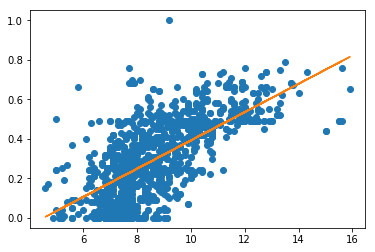

STEP: 3300, MSE: 0.0211, R2: 0.4649
Weights: [[ 0.07191461]], Bias: [-0.32675683]


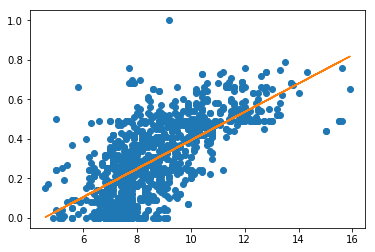

STEP: 3400, MSE: 0.0211, R2: 0.4650
Weights: [[ 0.07220087]], Bias: [-0.32934594]


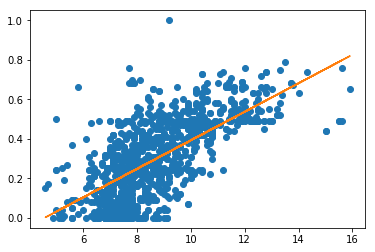

STEP: 3500, MSE: 0.0211, R2: 0.4652
Weights: [[ 0.07246485]], Bias: [-0.33173347]


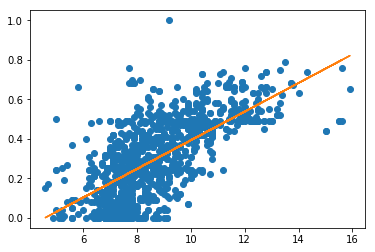

STEP: 3600, MSE: 0.0211, R2: 0.4653
Weights: [[ 0.07270826]], Bias: [-0.33393505]


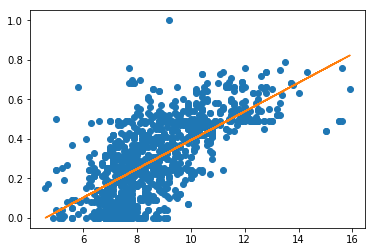

STEP: 3700, MSE: 0.0211, R2: 0.4654
Weights: [[ 0.07293272]], Bias: [-0.33596519]


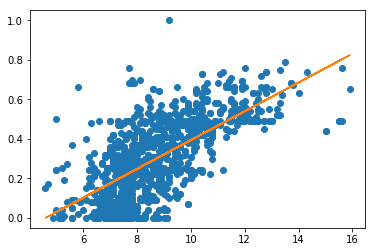

STEP: 3800, MSE: 0.0211, R2: 0.4655
Weights: [[ 0.07313971]], Bias: [-0.33783734]


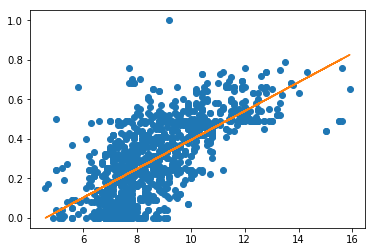

STEP: 3900, MSE: 0.0211, R2: 0.4656
Weights: [[ 0.07333057]], Bias: [-0.33956355]


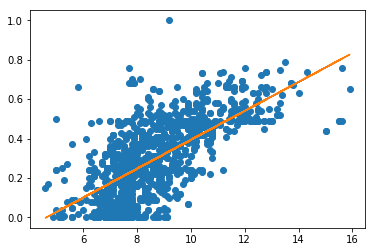

STEP: 4000, MSE: 0.0211, R2: 0.4656
Weights: [[ 0.07350656]], Bias: [-0.34115535]


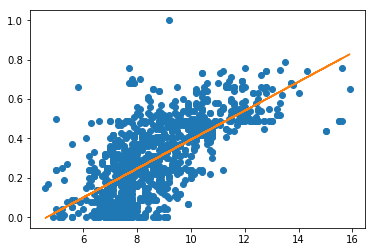

STEP: 4100, MSE: 0.0211, R2: 0.4657
Weights: [[ 0.07366885]], Bias: [-0.34262317]


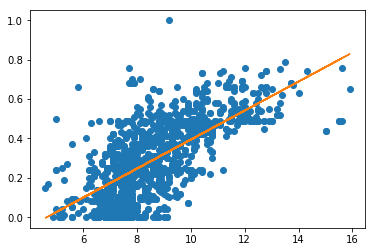

STEP: 4200, MSE: 0.0211, R2: 0.4657
Weights: [[ 0.0738185]], Bias: [-0.34397674]


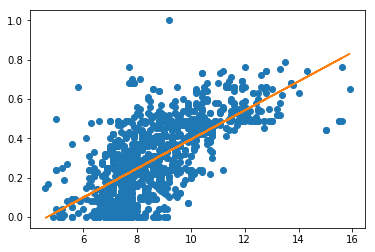

STEP: 4300, MSE: 0.0211, R2: 0.4658
Weights: [[ 0.0739565]], Bias: [-0.34522483]


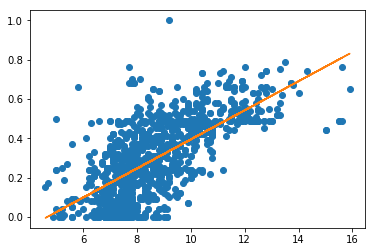

STEP: 4400, MSE: 0.0211, R2: 0.4658
Weights: [[ 0.07408375]], Bias: [-0.34637579]


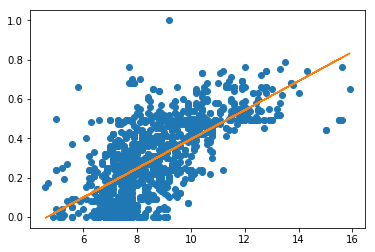

STEP: 4500, MSE: 0.0211, R2: 0.4658
Weights: [[ 0.0742011]], Bias: [-0.34743717]


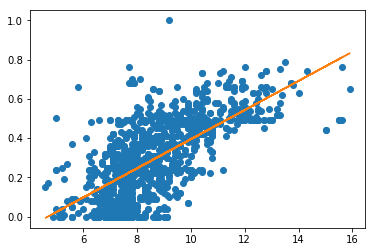

STEP: 4600, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.07430931]], Bias: [-0.34841591]


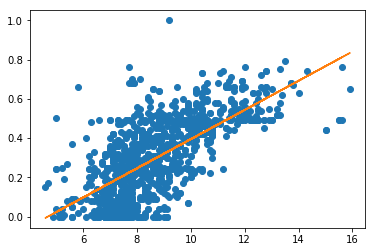

STEP: 4700, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.0744091]], Bias: [-0.34931841]


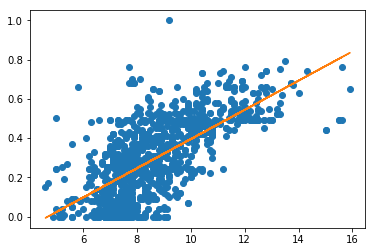

STEP: 4800, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.0745011]], Bias: [-0.35015059]


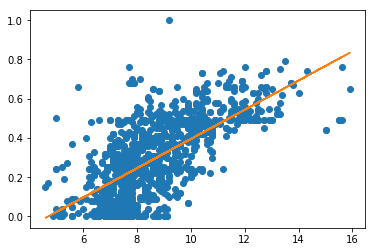

STEP: 4900, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.07458595]], Bias: [-0.35091799]


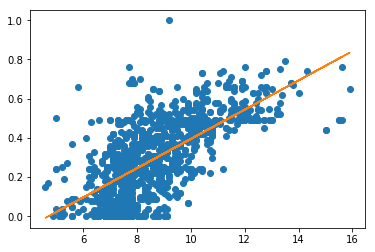

STEP: 5000, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.0746642]], Bias: [-0.35162568]


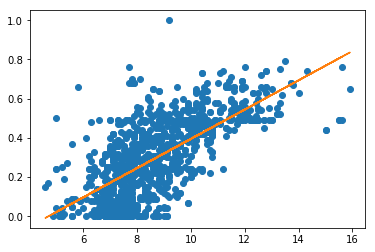

STEP: 5100, MSE: 0.0211, R2: 0.4659
Weights: [[ 0.07473634]], Bias: [-0.35227817]


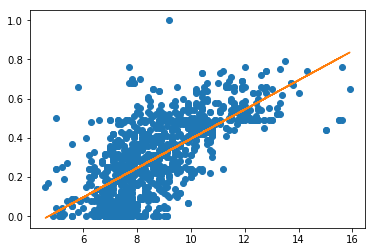

STEP: 5200, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07480287]], Bias: [-0.35287991]


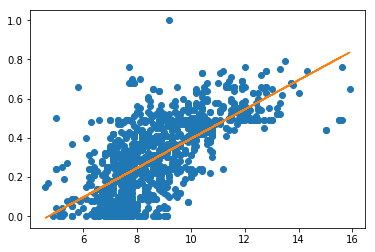

STEP: 5300, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07486422]], Bias: [-0.35343477]


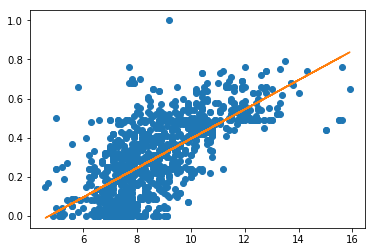

STEP: 5400, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.0749208]], Bias: [-0.35394648]


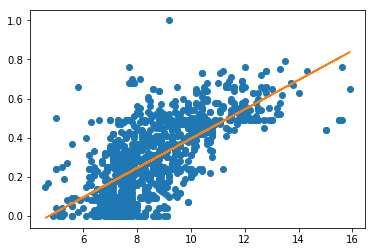

STEP: 5500, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07497296]], Bias: [-0.35441834]


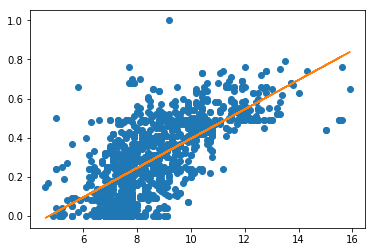

STEP: 5600, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07502106]], Bias: [-0.35485336]


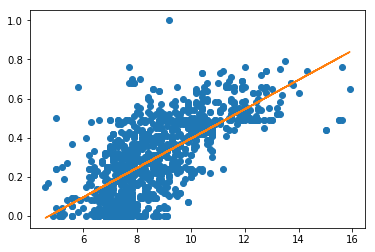

STEP: 5700, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07506542]], Bias: [-0.35525453]


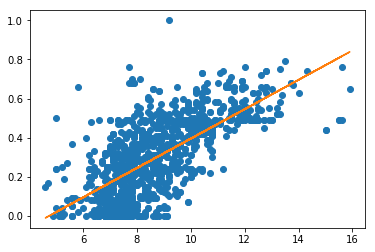

STEP: 5800, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07510632]], Bias: [-0.35562447]


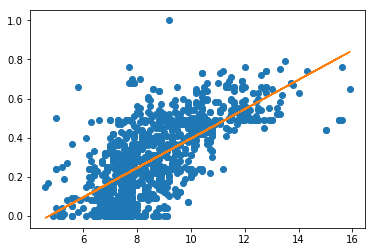

STEP: 5900, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07514404]], Bias: [-0.35596561]


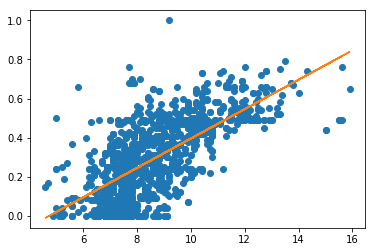

STEP: 6000, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07517882]], Bias: [-0.35628024]


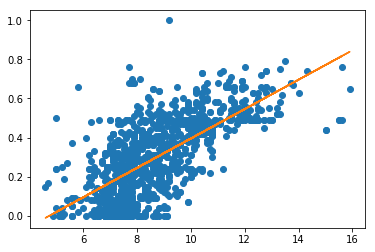

STEP: 6100, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.0752109]], Bias: [-0.35657033]


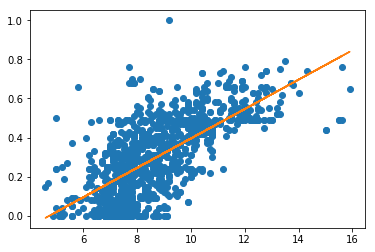

STEP: 6200, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07524046]], Bias: [-0.35683781]


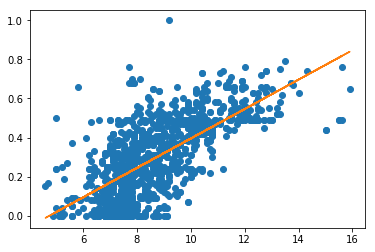

STEP: 6300, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07526775]], Bias: [-0.35708448]


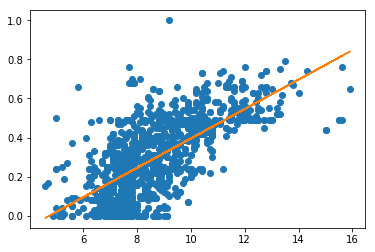

STEP: 6400, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07529289]], Bias: [-0.3573119]


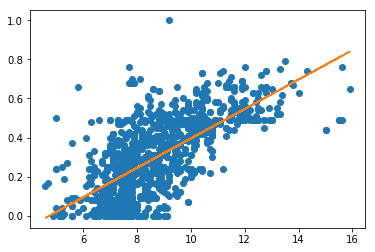

STEP: 6500, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07531608]], Bias: [-0.35752168]


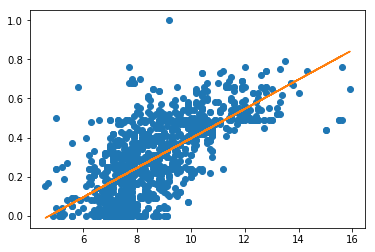

STEP: 6600, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07533746]], Bias: [-0.35771504]


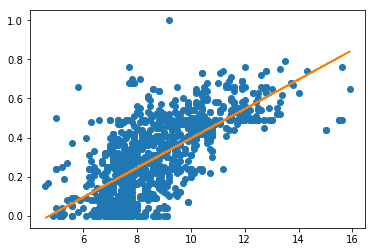

STEP: 6700, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07535719]], Bias: [-0.35789347]


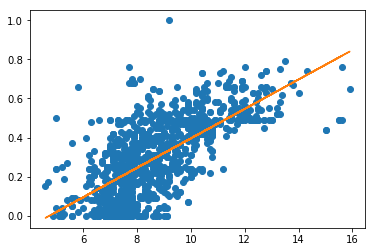

STEP: 6800, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07537536]], Bias: [-0.35805786]


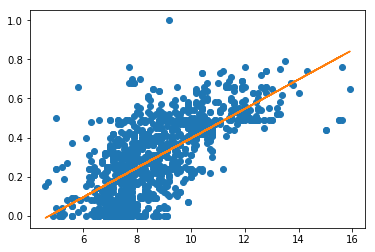

STEP: 6900, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07539213]], Bias: [-0.35820952]


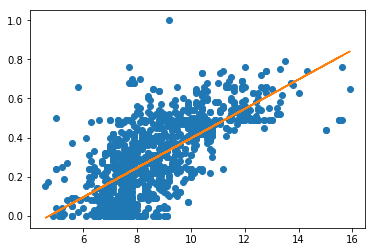

STEP: 7000, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07540759]], Bias: [-0.35834935]


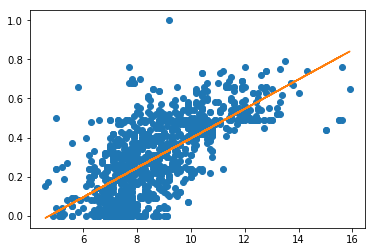

STEP: 7100, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07542186]], Bias: [-0.35847843]


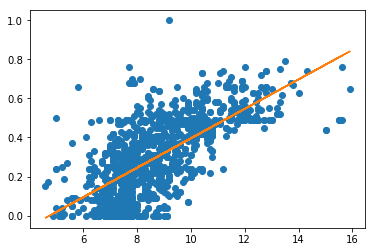

STEP: 7200, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.075435]], Bias: [-0.35859728]


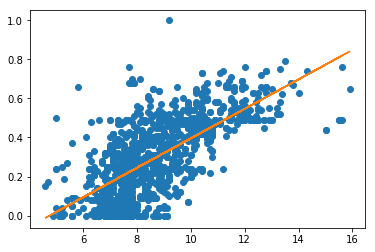

STEP: 7300, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07544713]], Bias: [-0.35870692]


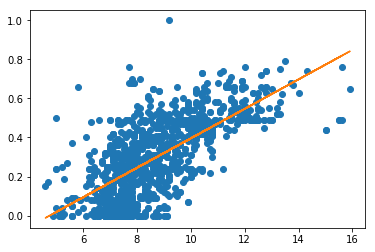

STEP: 7400, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.0754583]], Bias: [-0.35880807]


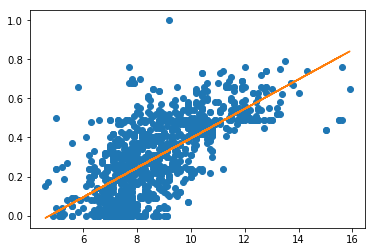

STEP: 7500, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07546861]], Bias: [-0.3589012]


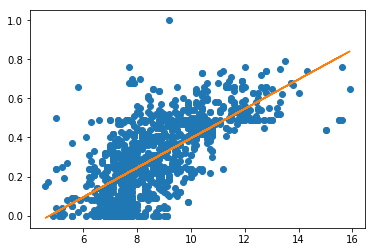

STEP: 7600, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07547811]], Bias: [-0.35898724]


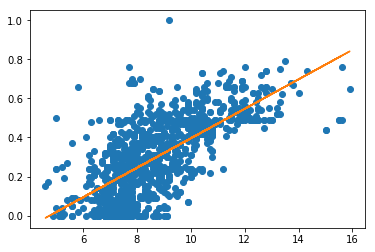

STEP: 7700, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07548689]], Bias: [-0.35906661]


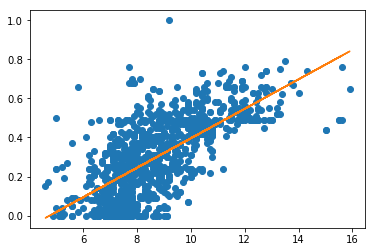

STEP: 7800, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07549497]], Bias: [-0.35913974]


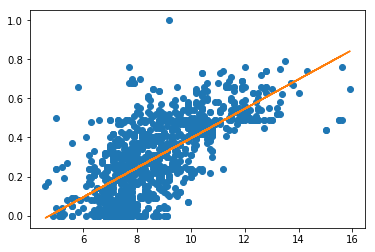

STEP: 7900, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07550242]], Bias: [-0.35920703]


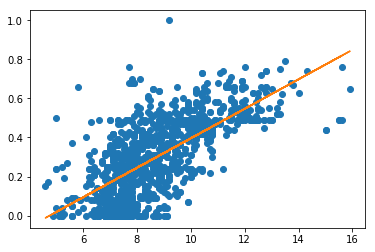

STEP: 8000, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07550928]], Bias: [-0.35926914]


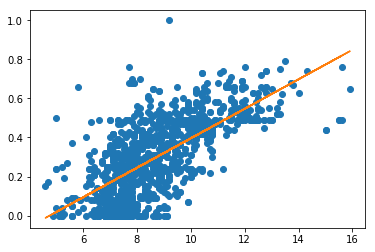

STEP: 8100, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07551565]], Bias: [-0.35932669]


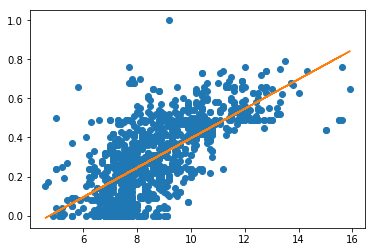

STEP: 8200, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07552147]], Bias: [-0.35937935]


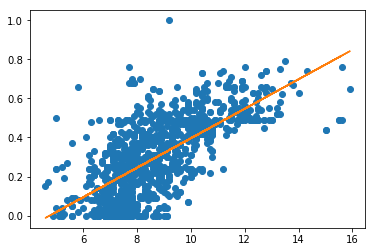

STEP: 8300, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07552687]], Bias: [-0.35942823]


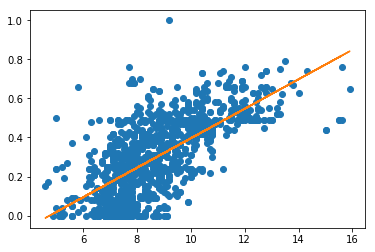

STEP: 8400, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07553186]], Bias: [-0.35947332]


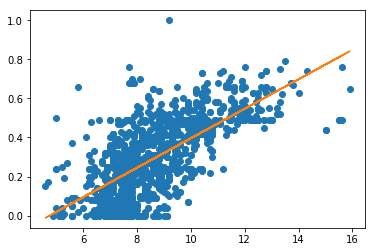

STEP: 8500, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07553642]], Bias: [-0.35951465]


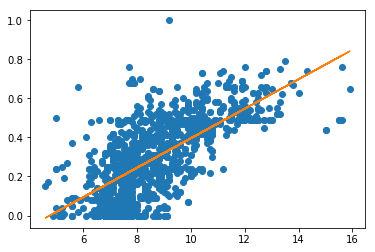

STEP: 8600, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07554065]], Bias: [-0.35955283]


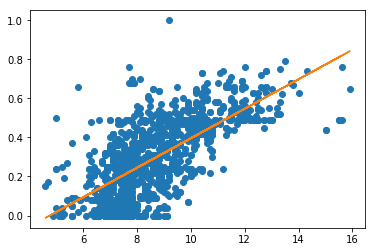

STEP: 8700, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07554455]], Bias: [-0.35958812]


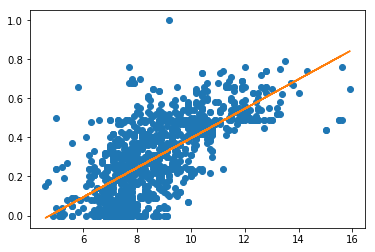

STEP: 8800, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07554816]], Bias: [-0.35962078]


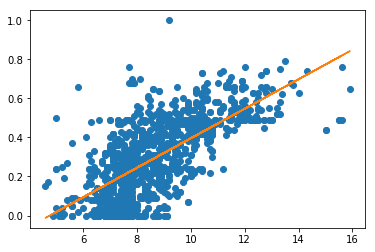

STEP: 8900, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07555145]], Bias: [-0.35965058]


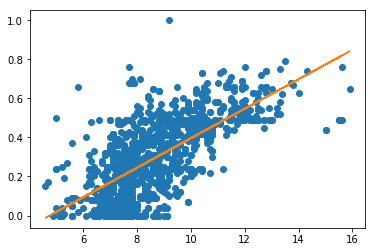

STEP: 9000, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07555449]], Bias: [-0.359678]


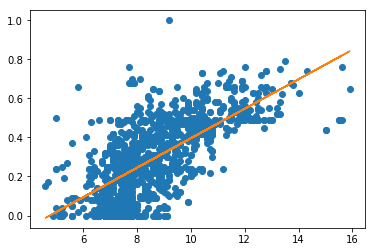

STEP: 9100, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07555731]], Bias: [-0.35970354]


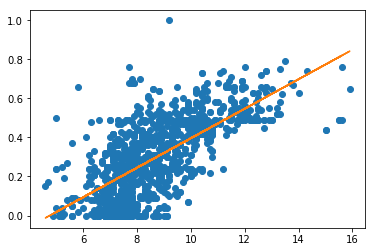

STEP: 9200, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07555995]], Bias: [-0.35972738]


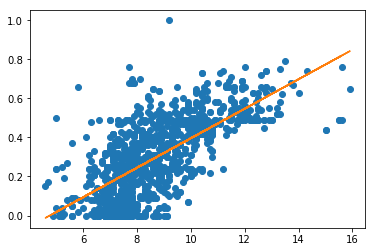

STEP: 9300, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07556229]], Bias: [-0.3597486]


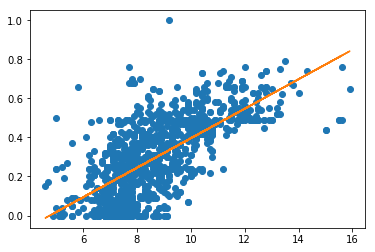

STEP: 9400, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07556456]], Bias: [-0.35976914]


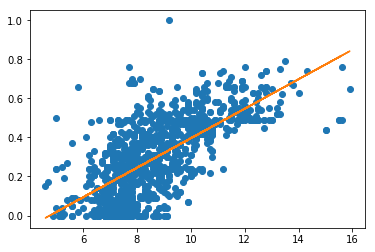

STEP: 9500, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07556654]], Bias: [-0.35978702]


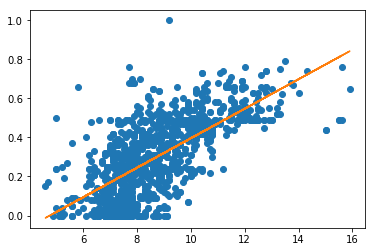

STEP: 9600, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.0755685]], Bias: [-0.35980469]


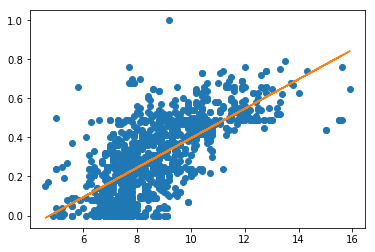

STEP: 9700, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07557014]], Bias: [-0.35981959]


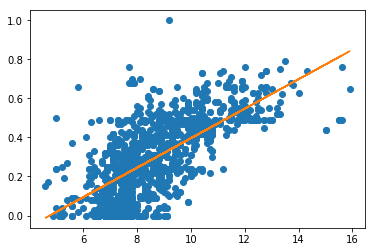

STEP: 9800, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07557179]], Bias: [-0.35983449]


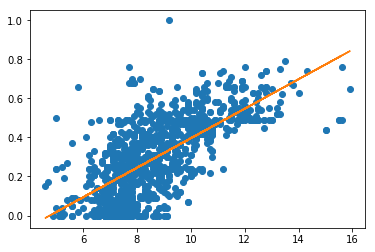

STEP: 9900, MSE: 0.0211, R2: 0.4660
Weights: [[ 0.07557324]], Bias: [-0.35984758]


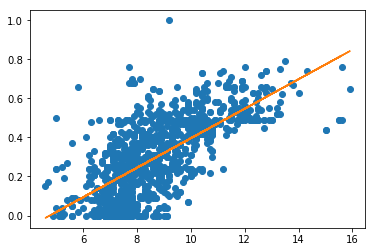

In [19]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X0: trainX0, Y_train: trainY}
        #sess.run(model0, feed_dict=feedDict)
        model0.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W0).reshape((1,1)), sess.run(b0))
            print(msg0)
            print(msg1)
            
            plt.plot(trainX0, trainY, 'o', label='STEP: {step}'.format(step=step))
            plt.plot(trainX0, sess.run(W0) * trainX0 + sess.run(b0))
            plt.show()

### Using `tf.placeholder`, 2 columns

In [20]:
# Variables
X1 = tf.placeholder(tf.float32, [None, nDim1])
Y_train = tf.placeholder(tf.float32, [None, 1])

W1 = tf.Variable(tf.random_normal([nDim1, 1]), name='weight')
b1 = tf.Variable(tf.random_normal([1]), name='bias')

In [21]:
y_pred = tf.add(tf.matmul(X1, W1), b1)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred)) / tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model1 = optimizer.minimize(costFunc)

STEP:   0, MSE: 70.0041, R2: -1771.6173
Weights: [[ 0.92552853  0.91974318]], Bias: [ 0.01494876]


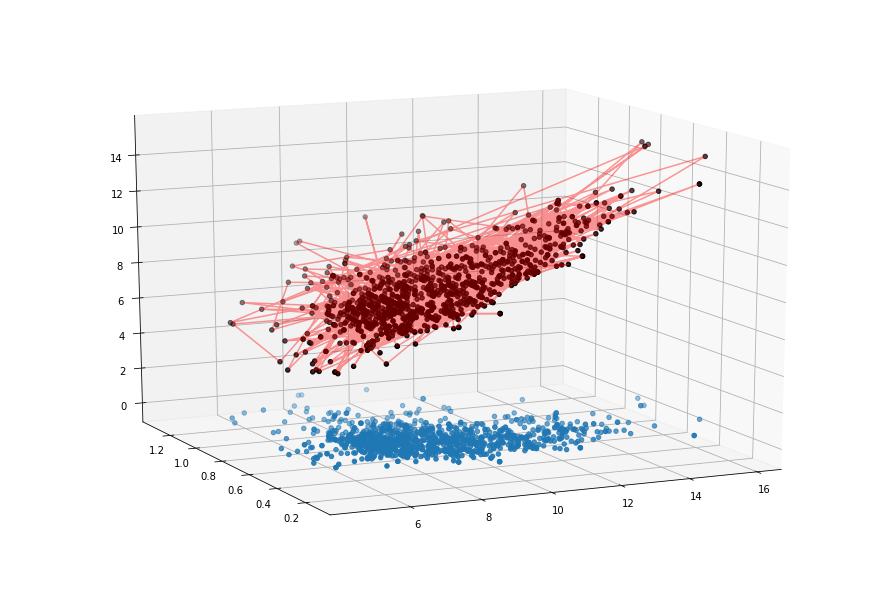

STEP: 100, MSE: 0.0807, R2: -1.0440
Weights: [[ 0.01098851  0.74180728]], Bias: [-0.15564056]


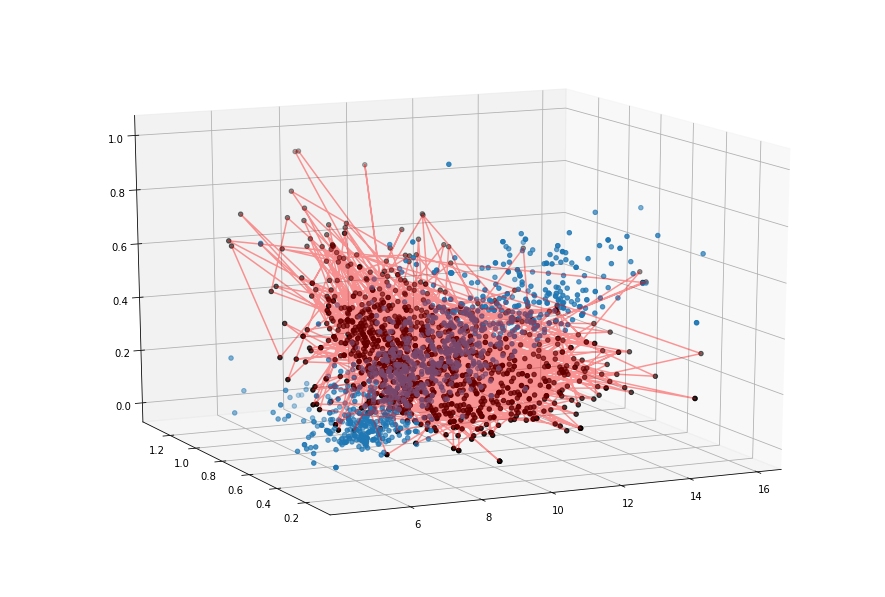

STEP: 200, MSE: 0.0655, R2: -0.6592
Weights: [[ 0.02333341  0.63263422]], Bias: [-0.21138646]


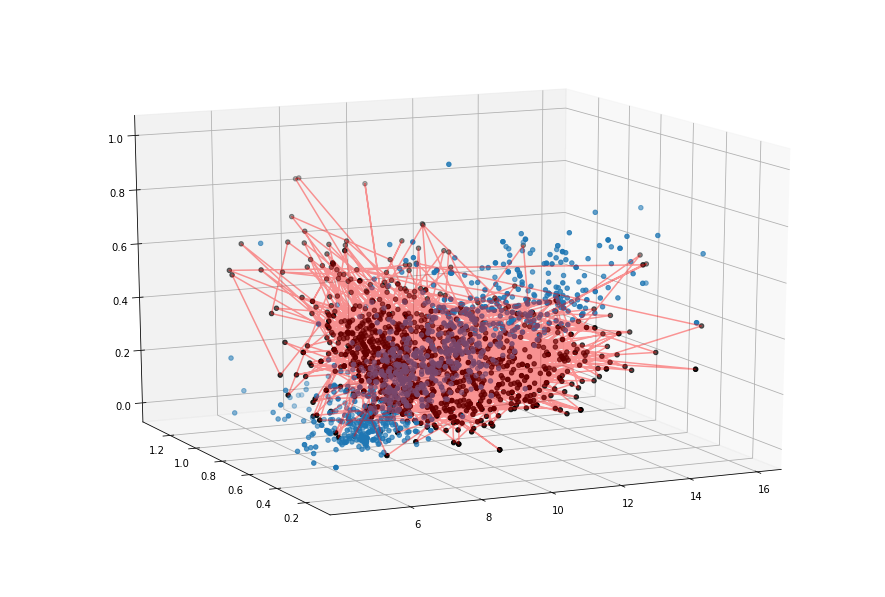

STEP: 300, MSE: 0.0543, R2: -0.3739
Weights: [[ 0.03375491  0.53735435]], Bias: [-0.25685152]


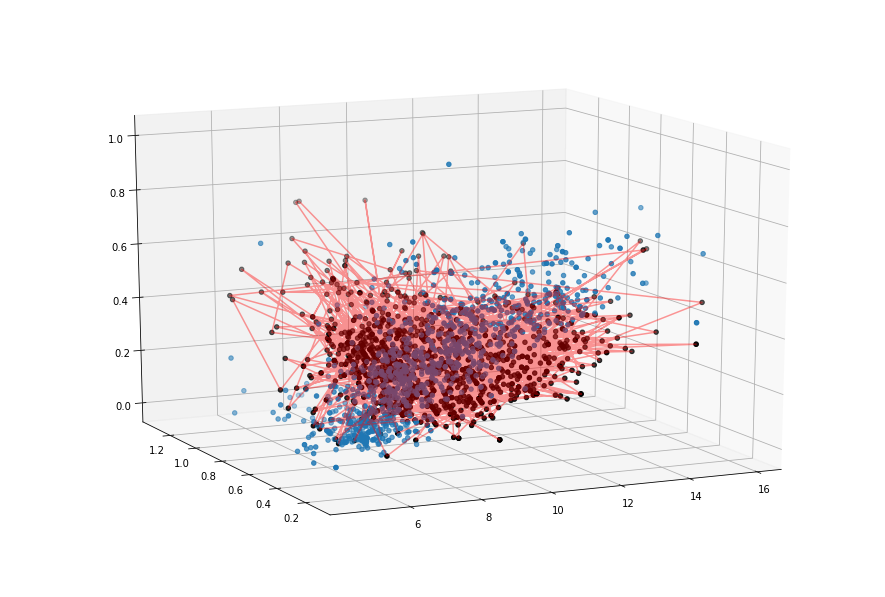

STEP: 400, MSE: 0.0459, R2: -0.1617
Weights: [[ 0.04253464  0.45402053]], Bias: [-0.29358569]


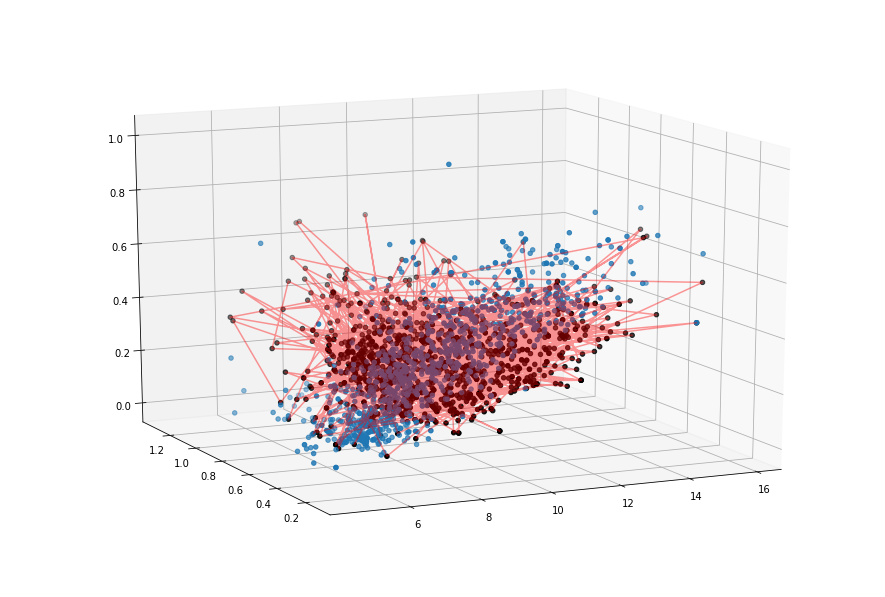

STEP: 500, MSE: 0.0396, R2: -0.0032
Weights: [[ 0.04991345  0.38096499]], Bias: [-0.32291317]


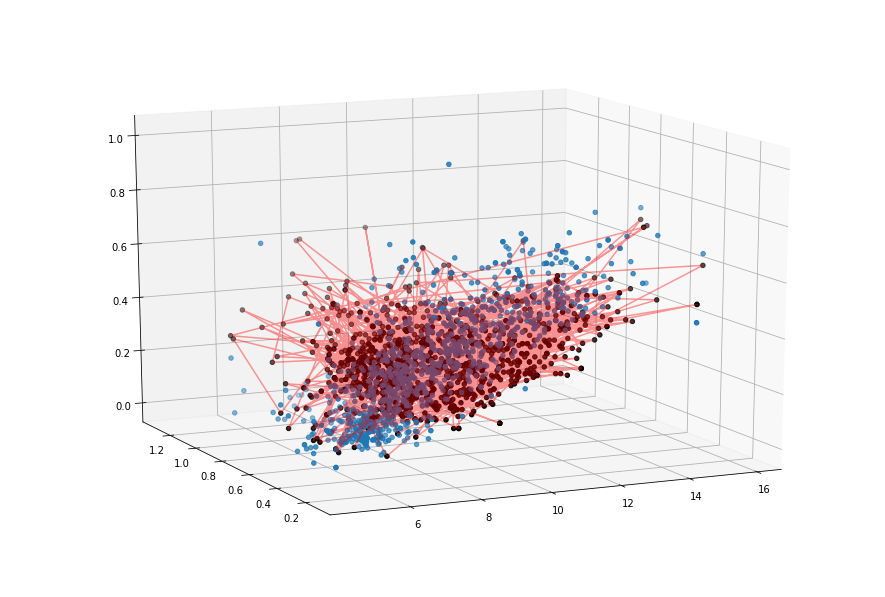

STEP: 600, MSE: 0.0349, R2: 0.1158
Weights: [[ 0.05609742  0.31675875]], Bias: [-0.34596592]


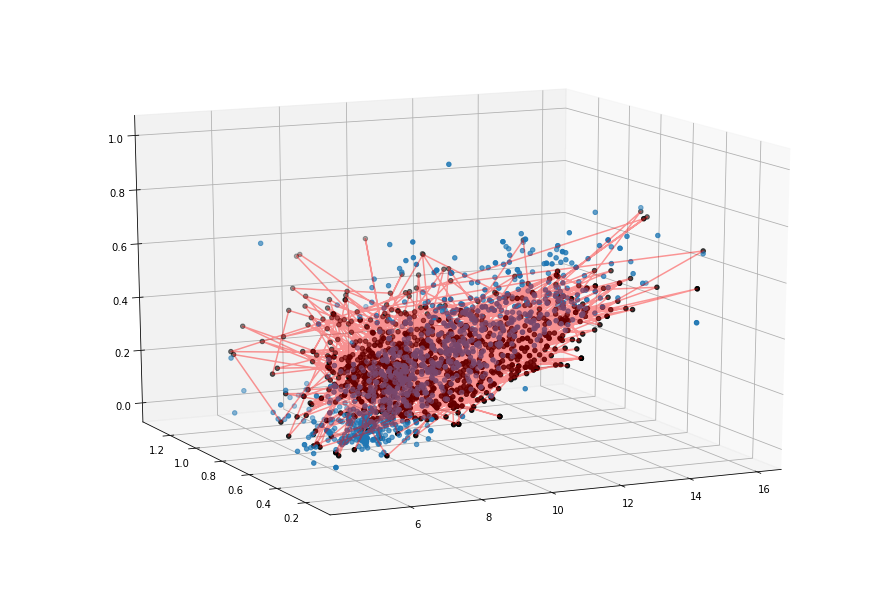

STEP: 700, MSE: 0.0314, R2: 0.2056
Weights: [[ 0.06126272  0.26017714]], Bias: [-0.36371014]


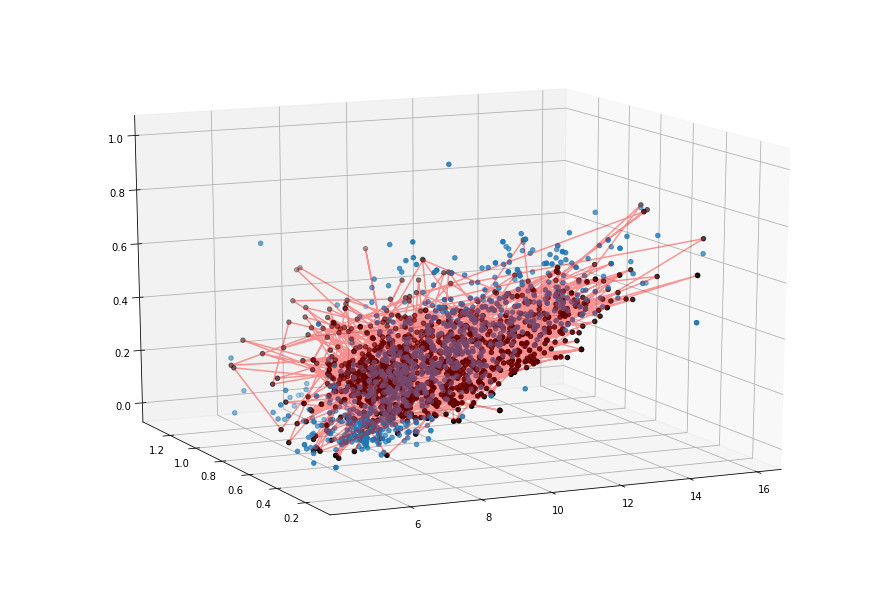

STEP: 800, MSE: 0.0287, R2: 0.2739
Weights: [[ 0.06556004  0.21017055]], Bias: [-0.37697124]


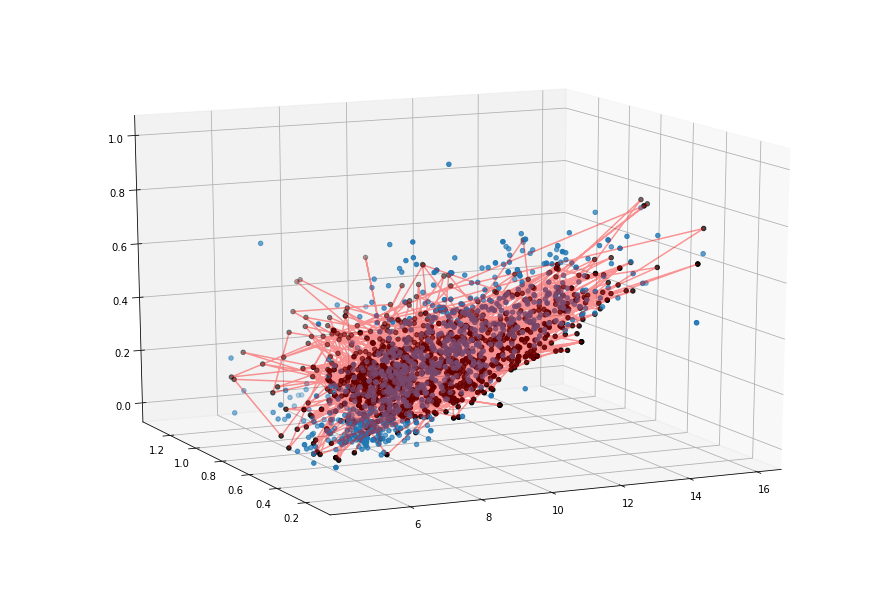

STEP: 900, MSE: 0.0266, R2: 0.3263
Weights: [[ 0.06911828  0.165839  ]], Bias: [-0.38645399]


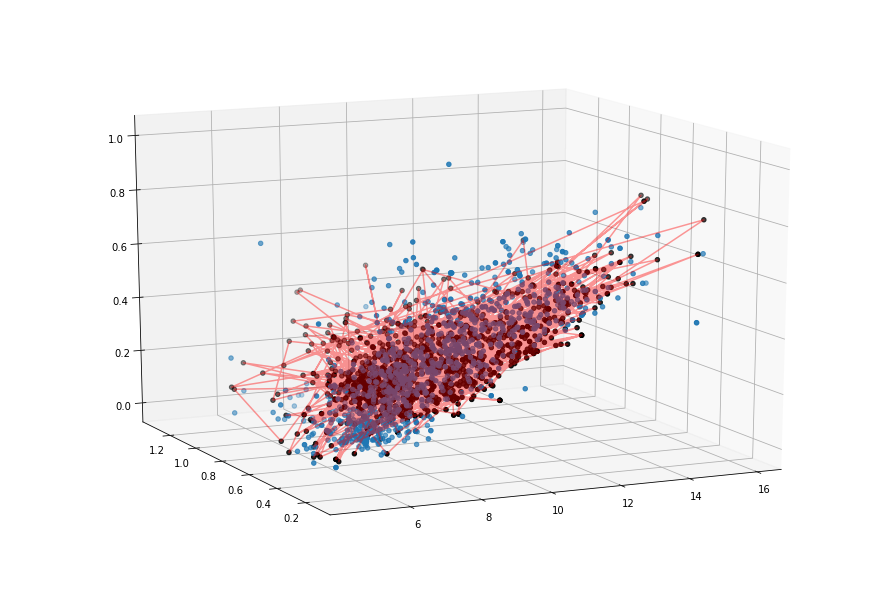

STEP: 1000, MSE: 0.0250, R2: 0.3669
Weights: [[ 0.07204756  0.12641107]], Bias: [-0.3927595]


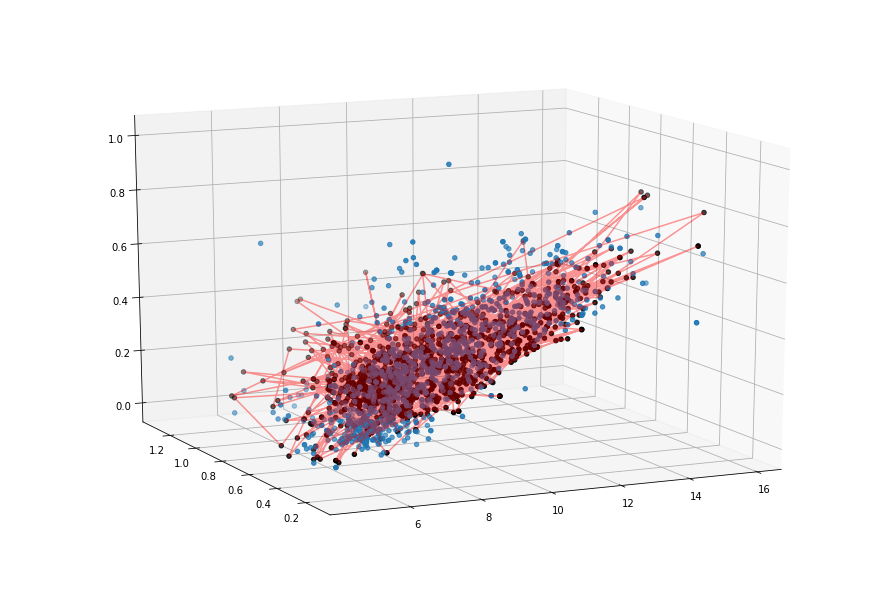

STEP: 1100, MSE: 0.0237, R2: 0.3988
Weights: [[ 0.07444205  0.09122489]], Bias: [-0.3964003]


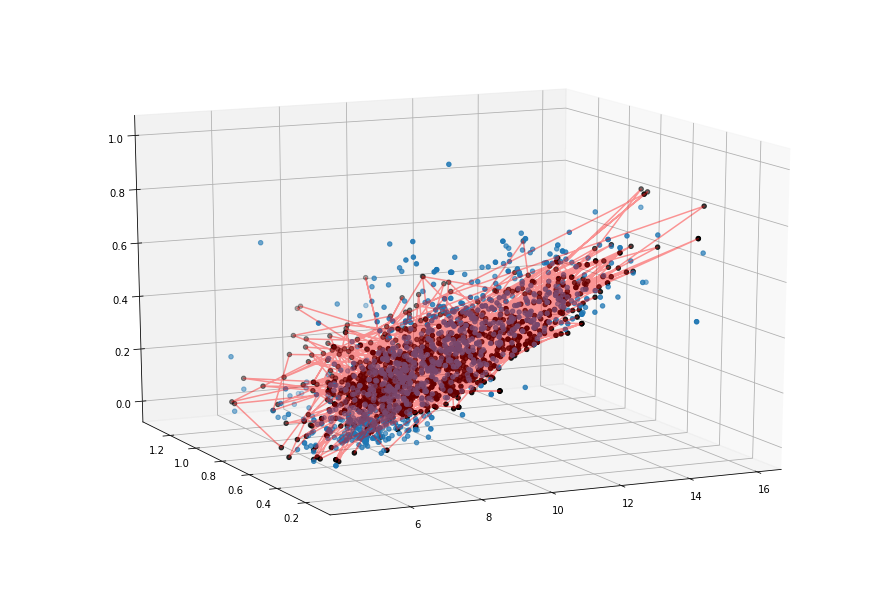

STEP: 1200, MSE: 0.0227, R2: 0.4241
Weights: [[ 0.07638224  0.05971274]], Bias: [-0.3978138]


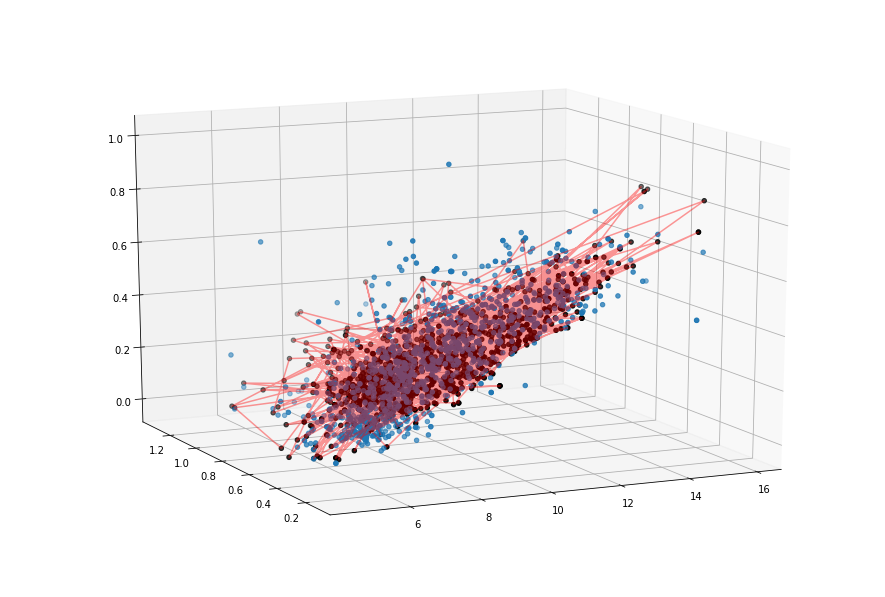

STEP: 1300, MSE: 0.0219, R2: 0.4445
Weights: [[ 0.07793693  0.03138736]], Bias: [-0.39737263]


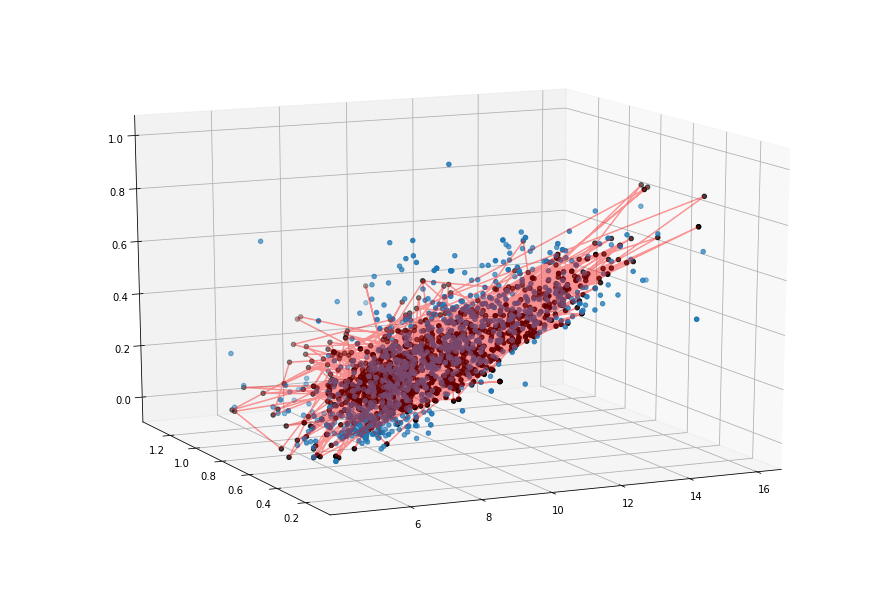

STEP: 1400, MSE: 0.0213, R2: 0.4612
Weights: [[ 0.0791649   0.00583046]], Bias: [-0.39539412]


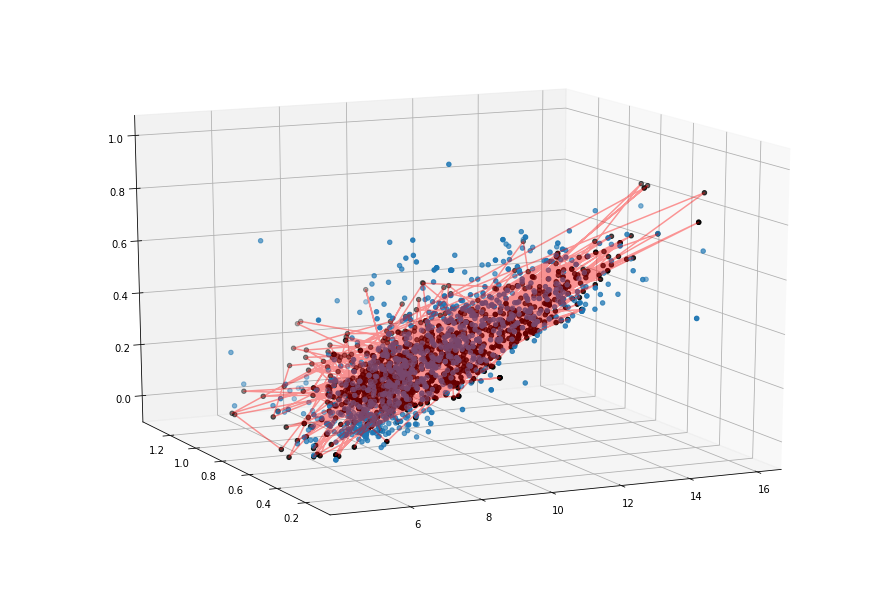

STEP: 1500, MSE: 0.0207, R2: 0.4750
Weights: [[ 0.08011635 -0.01731719]], Bias: [-0.39214846]


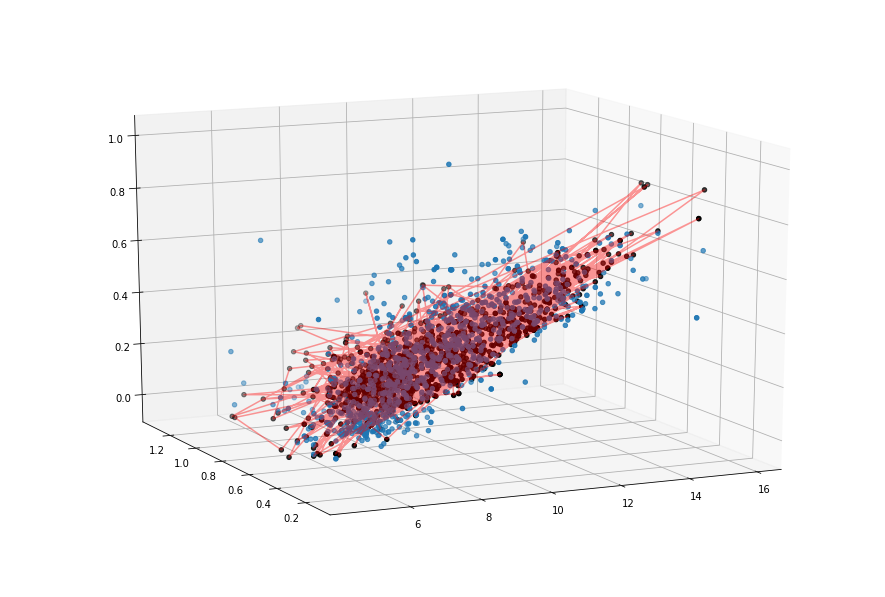

STEP: 1600, MSE: 0.0203, R2: 0.4867
Weights: [[ 0.08083415 -0.03836428]], Bias: [-0.38786522]


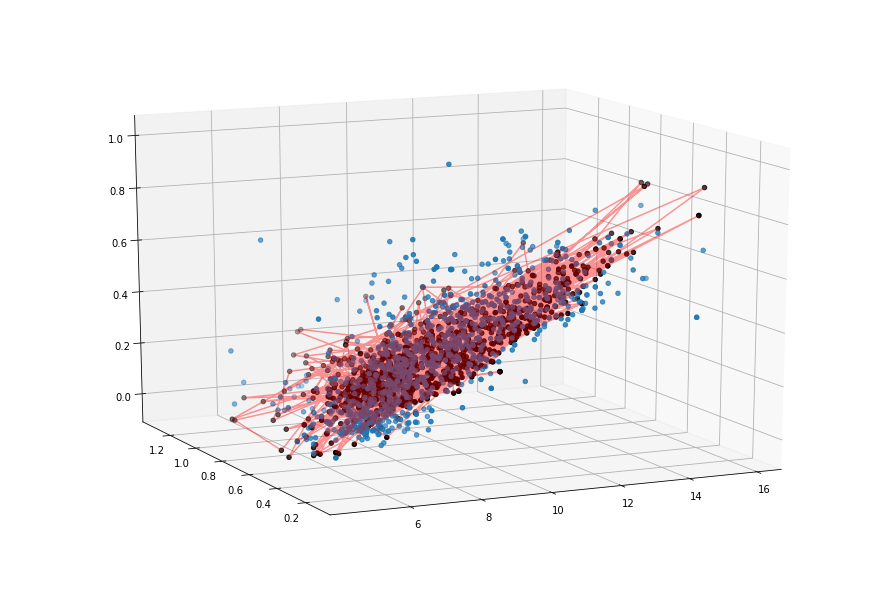

STEP: 1700, MSE: 0.0199, R2: 0.4967
Weights: [[ 0.08135493 -0.05757611]], Bias: [-0.3827399]


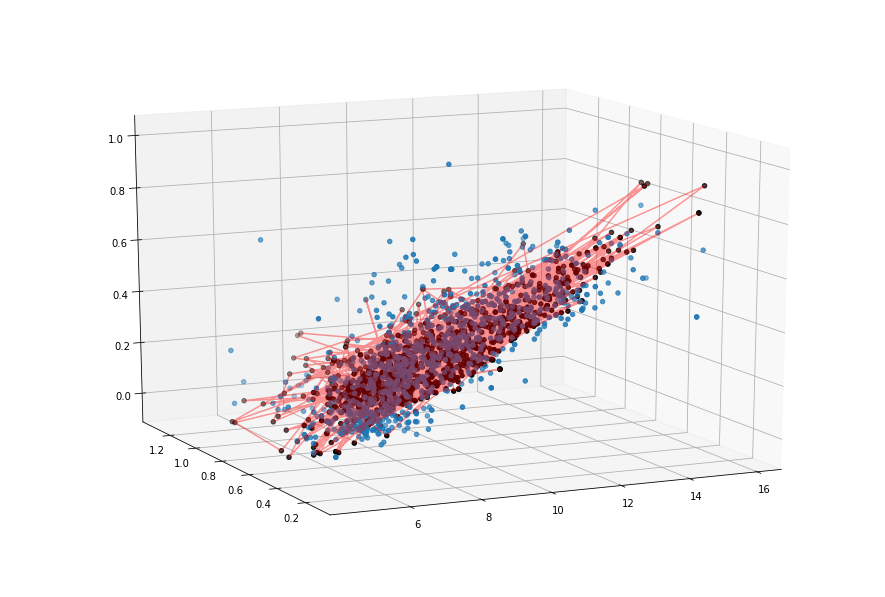

STEP: 1800, MSE: 0.0195, R2: 0.5055
Weights: [[ 0.08170988 -0.07518093]], Bias: [-0.3769376]


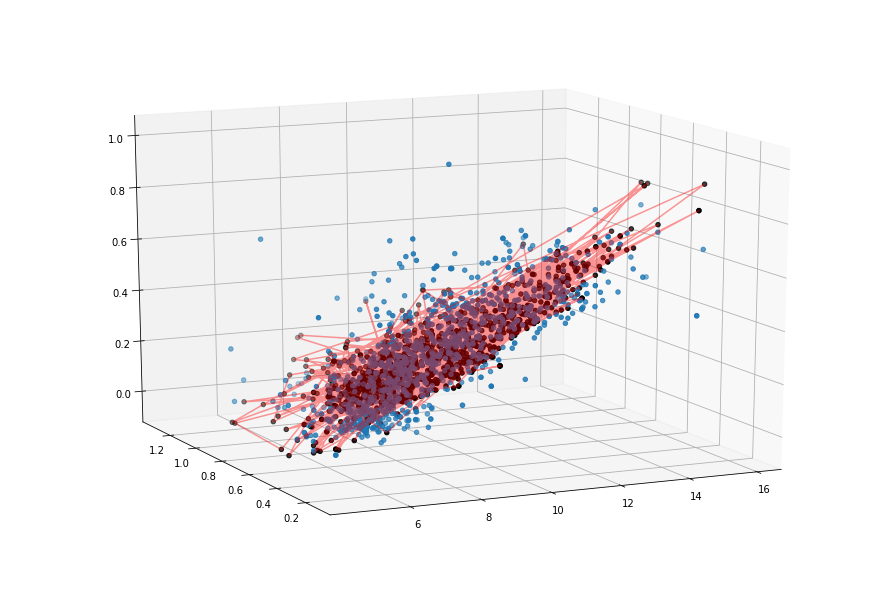

STEP: 1900, MSE: 0.0192, R2: 0.5131
Weights: [[ 0.08192568 -0.09137518]], Bias: [-0.37059912]


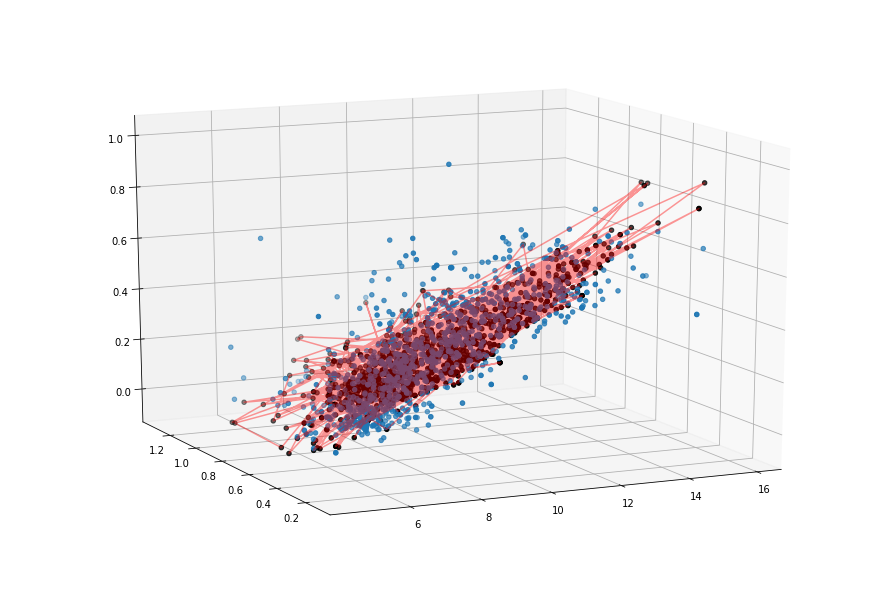

STEP: 2000, MSE: 0.0190, R2: 0.5199
Weights: [[ 0.08202506 -0.10632805]], Bias: [-0.36384326]


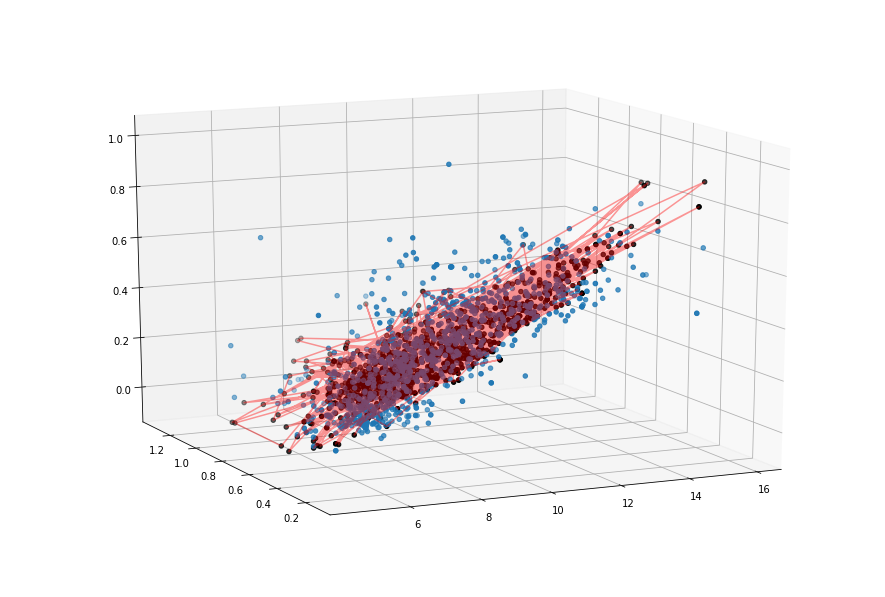

STEP: 2100, MSE: 0.0187, R2: 0.5261
Weights: [[ 0.08202738 -0.12018532]], Bias: [-0.3567706]


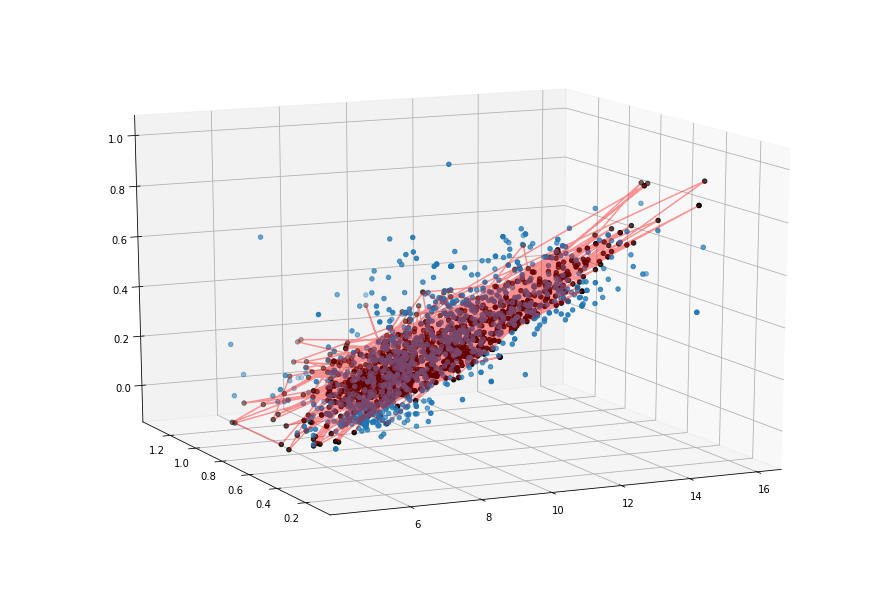

STEP: 2200, MSE: 0.0185, R2: 0.5316
Weights: [[ 0.08194911 -0.13307288]], Bias: [-0.34946573]


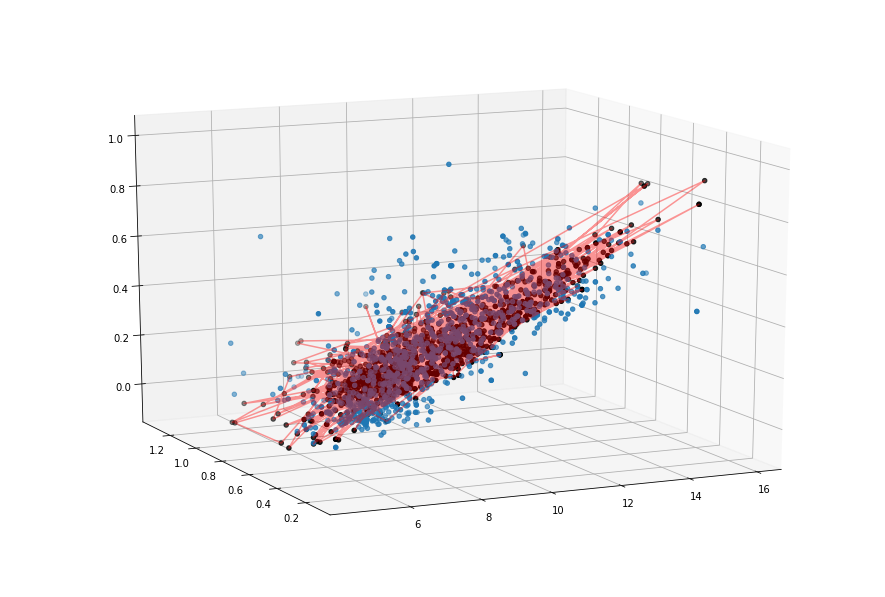

STEP: 2300, MSE: 0.0183, R2: 0.5367
Weights: [[ 0.08180431 -0.1450993 ]], Bias: [-0.34199995]


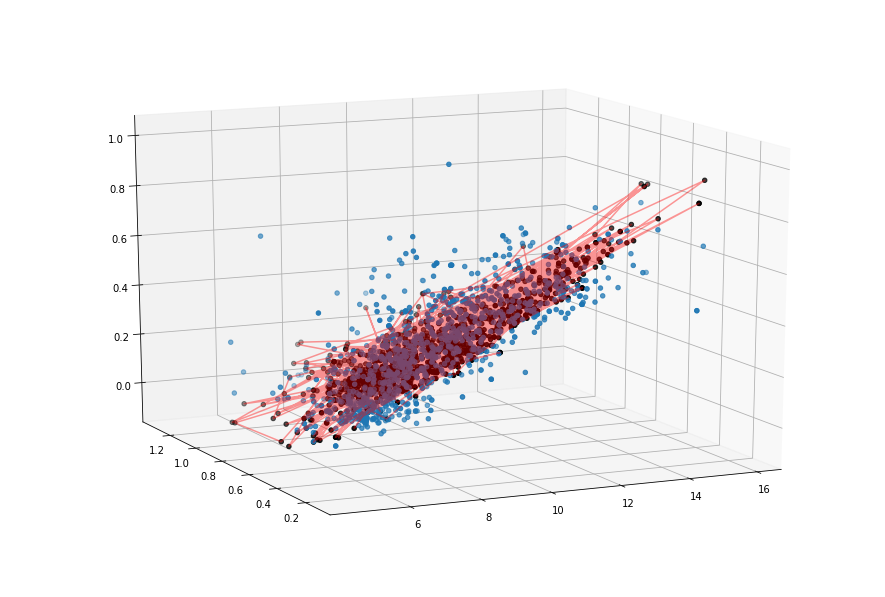

STEP: 2400, MSE: 0.0181, R2: 0.5414
Weights: [[ 0.08160495 -0.1563585 ]], Bias: [-0.33443344]


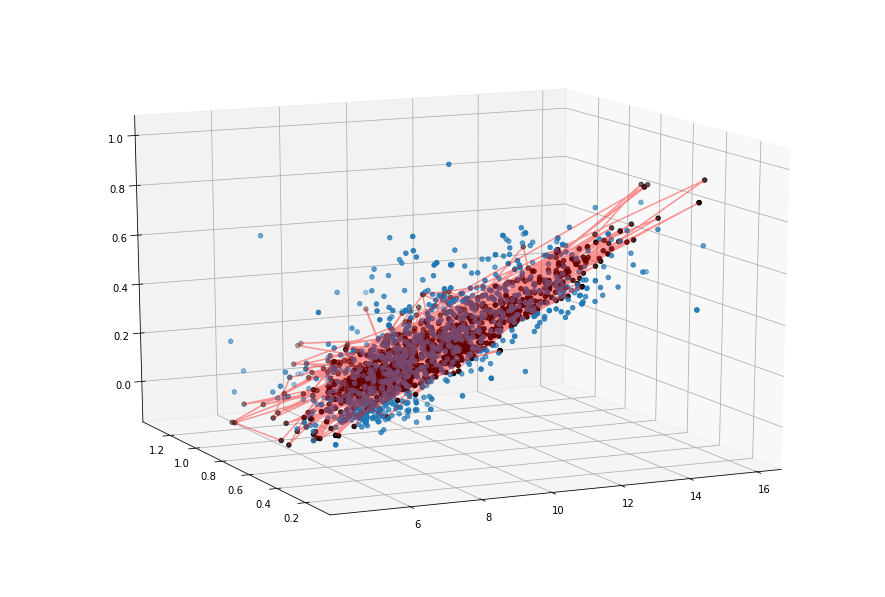

STEP: 2500, MSE: 0.0179, R2: 0.5457
Weights: [[ 0.08136116 -0.16693185]], Bias: [-0.32681635]


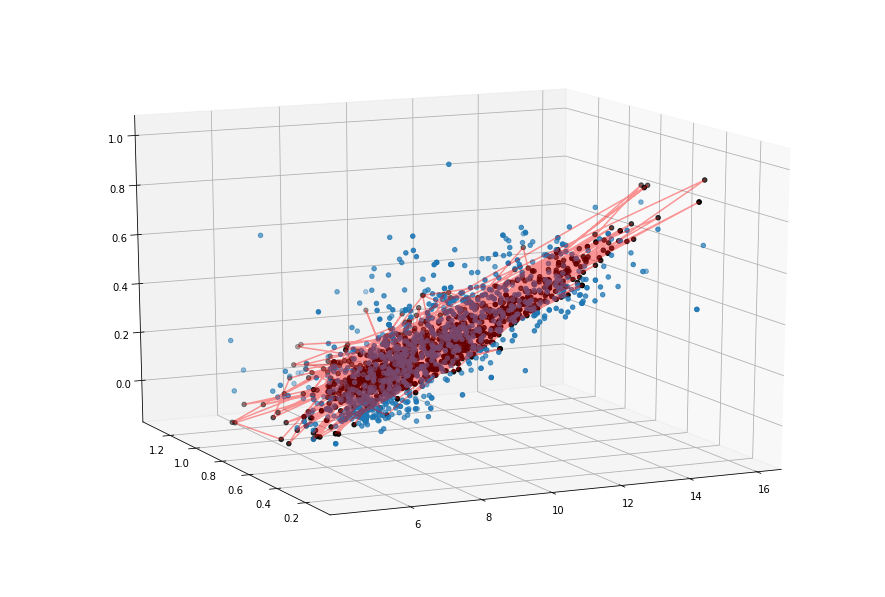

STEP: 2600, MSE: 0.0178, R2: 0.5496
Weights: [[ 0.08108153 -0.17688982]], Bias: [-0.31919017]


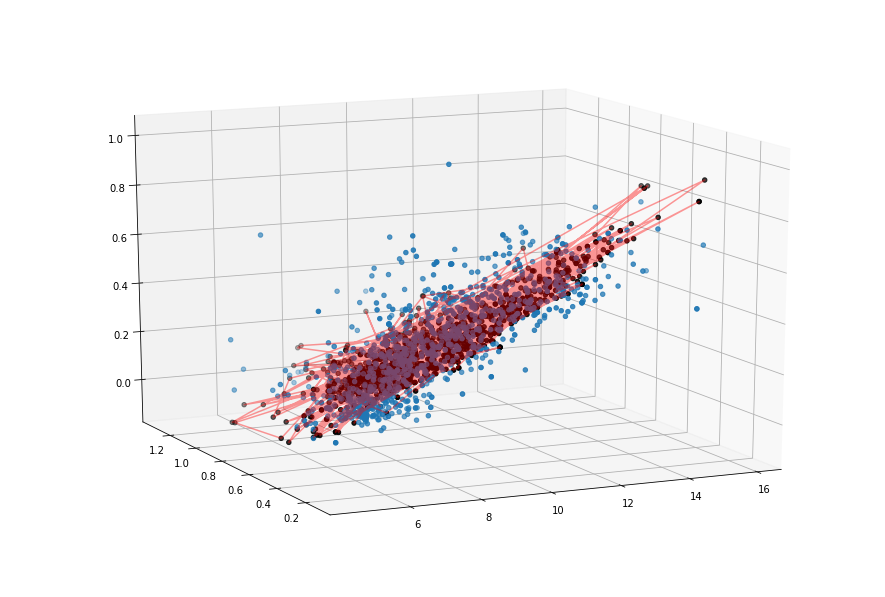

STEP: 2700, MSE: 0.0176, R2: 0.5533
Weights: [[ 0.08077345 -0.1862936 ]], Bias: [-0.3115904]


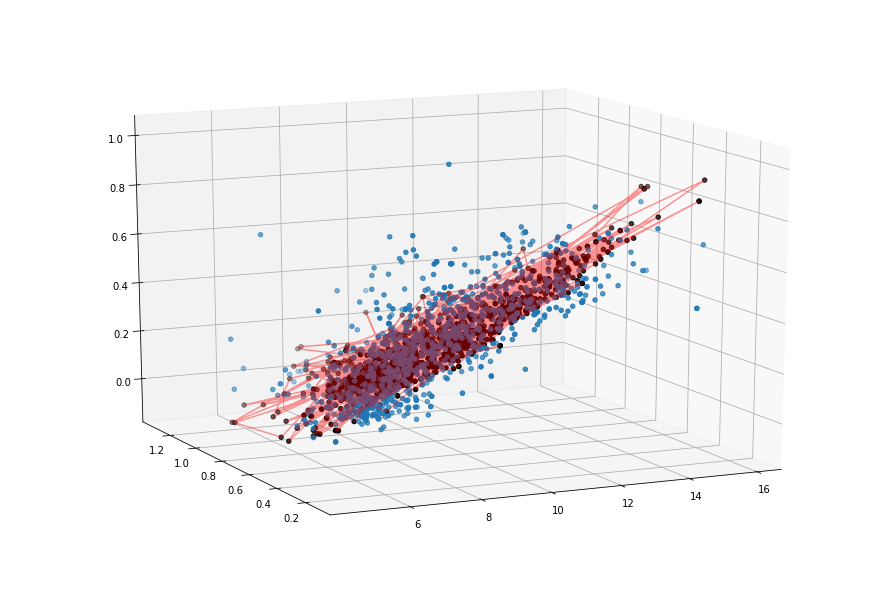

STEP: 2800, MSE: 0.0175, R2: 0.5568
Weights: [[ 0.08044306 -0.19519633]], Bias: [-0.30404541]


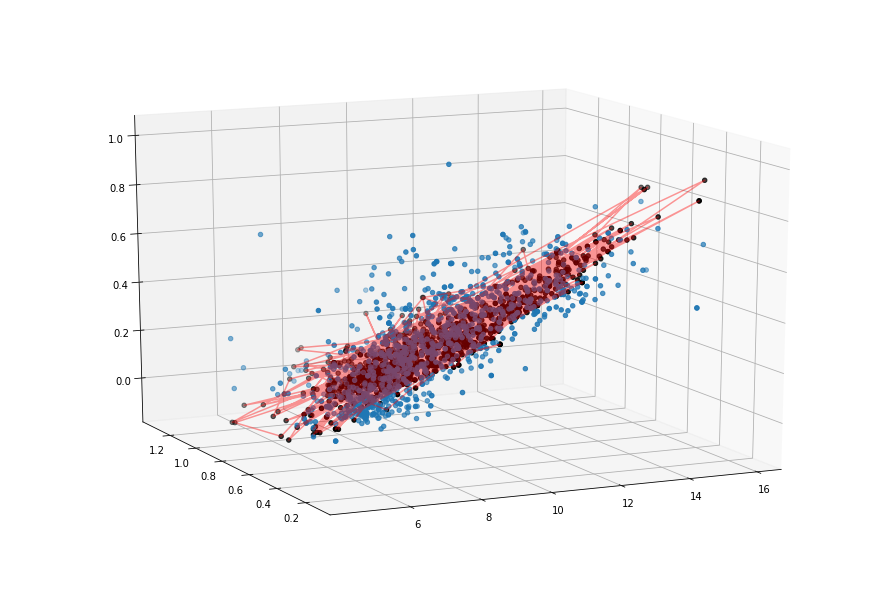

STEP: 2900, MSE: 0.0174, R2: 0.5600
Weights: [[ 0.0800956  -0.20364434]], Bias: [-0.29657882]


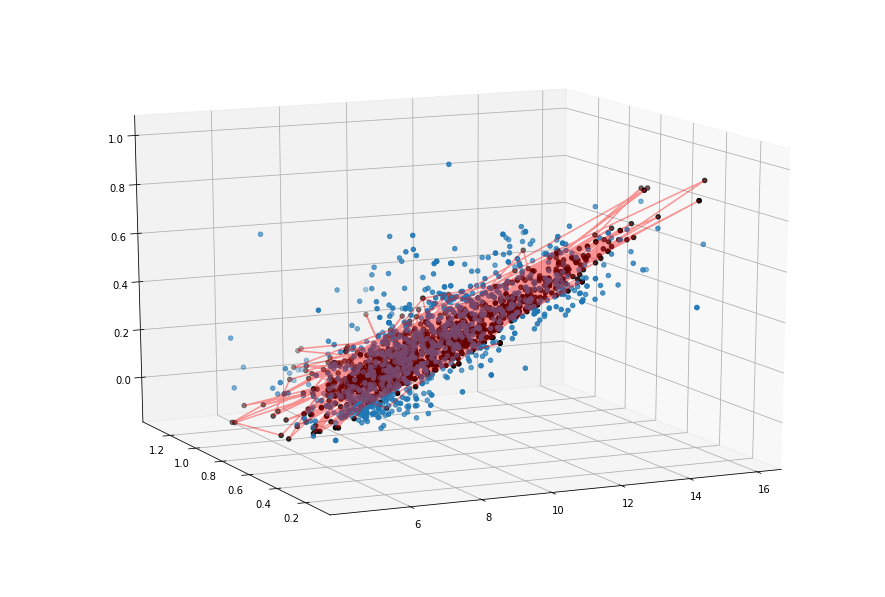

STEP: 3000, MSE: 0.0173, R2: 0.5630
Weights: [[ 0.0797355  -0.21167815]], Bias: [-0.28920996]


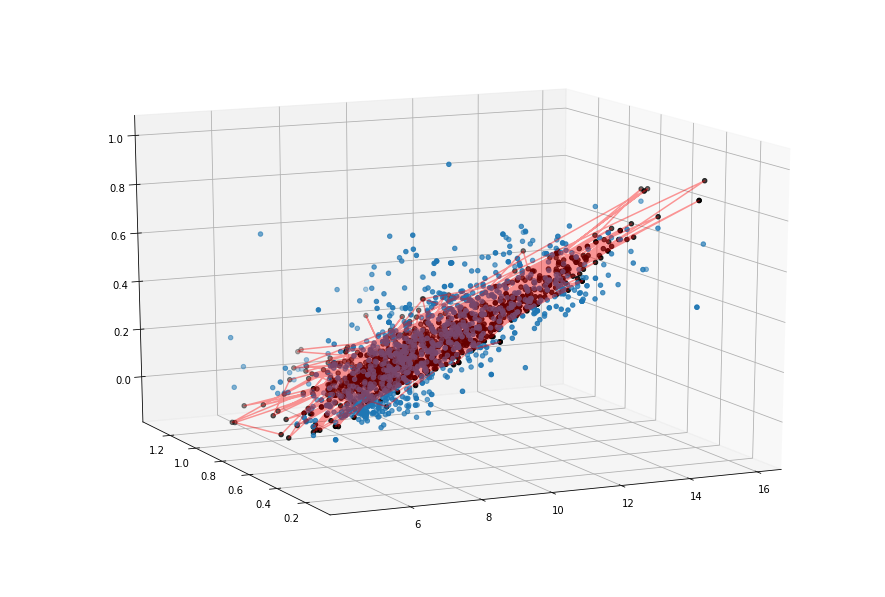

STEP: 3100, MSE: 0.0171, R2: 0.5659
Weights: [[ 0.07936648 -0.21933308]], Bias: [-0.28195429]


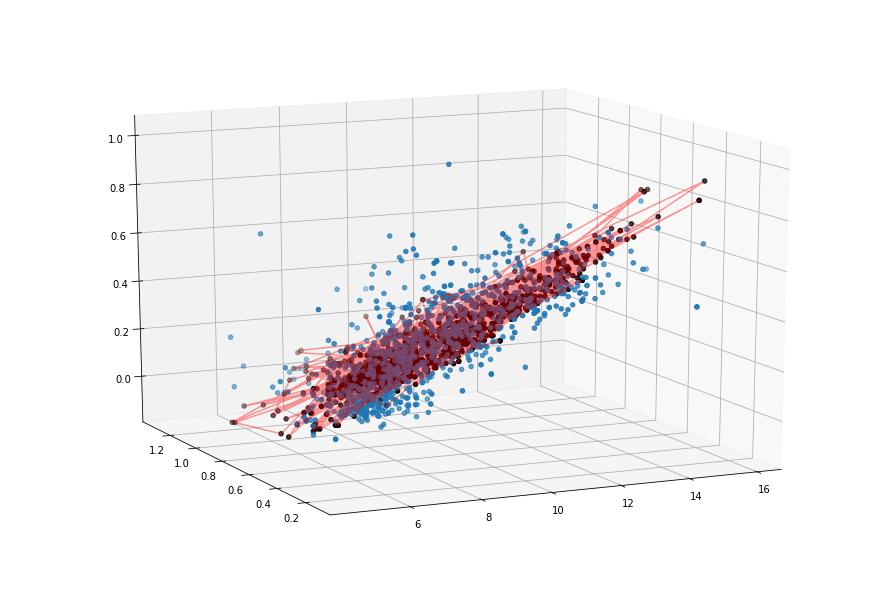

STEP: 3200, MSE: 0.0170, R2: 0.5685
Weights: [[ 0.07899165 -0.22664015]], Bias: [-0.27482432]


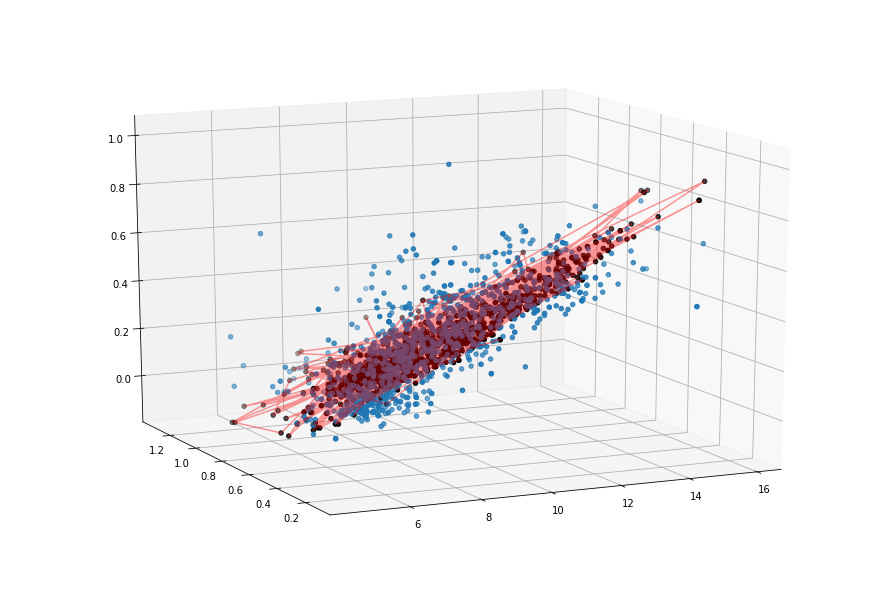

STEP: 3300, MSE: 0.0169, R2: 0.5710
Weights: [[ 0.07861365 -0.23362659]], Bias: [-0.26782972]


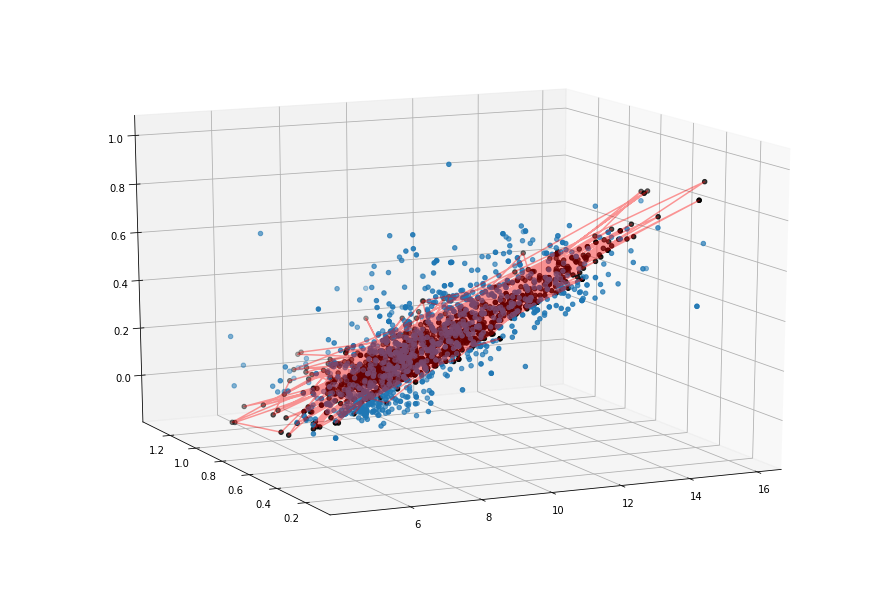

STEP: 3400, MSE: 0.0169, R2: 0.5733
Weights: [[ 0.07823467 -0.24031651]], Bias: [-0.26097801]


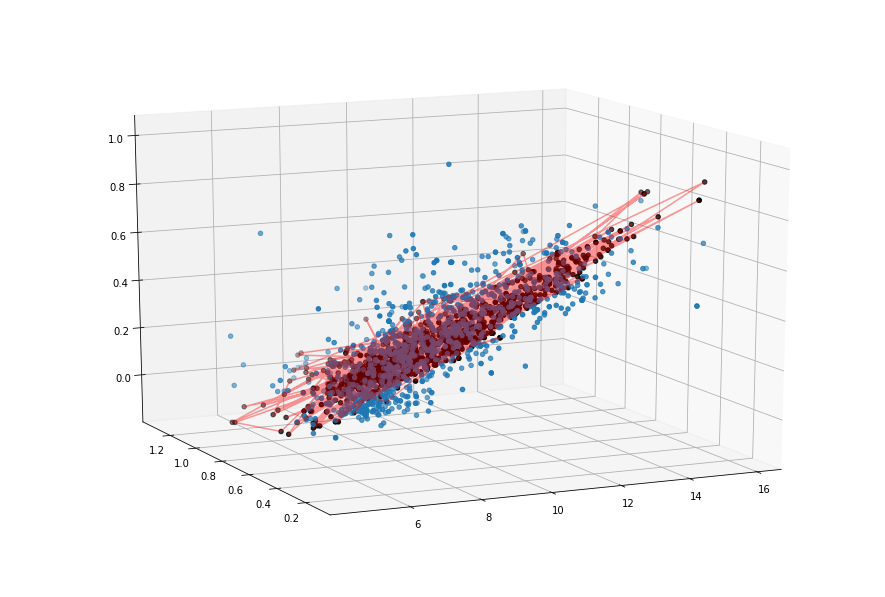

STEP: 3500, MSE: 0.0168, R2: 0.5755
Weights: [[ 0.0778565  -0.24673101]], Bias: [-0.25427473]


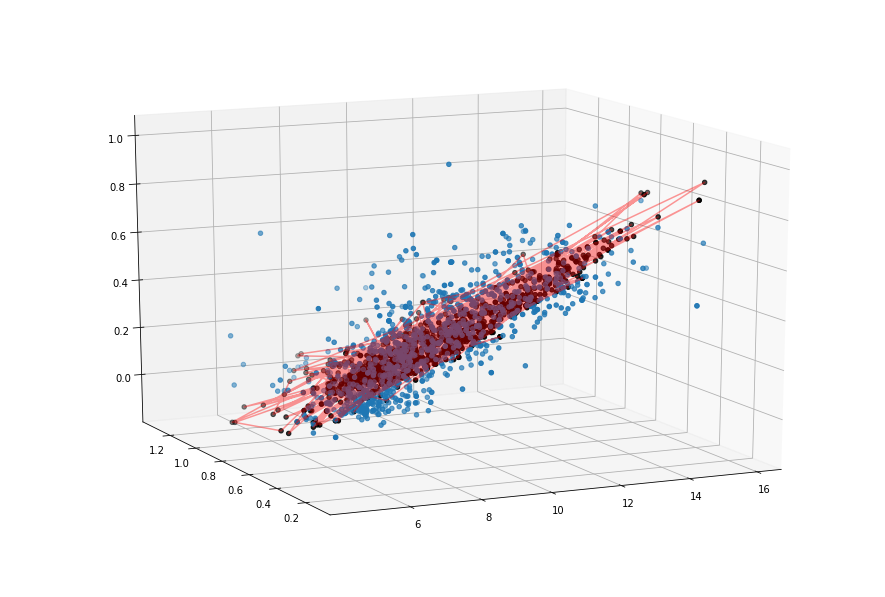

STEP: 3600, MSE: 0.0167, R2: 0.5775
Weights: [[ 0.0774807  -0.25288898]], Bias: [-0.24772421]


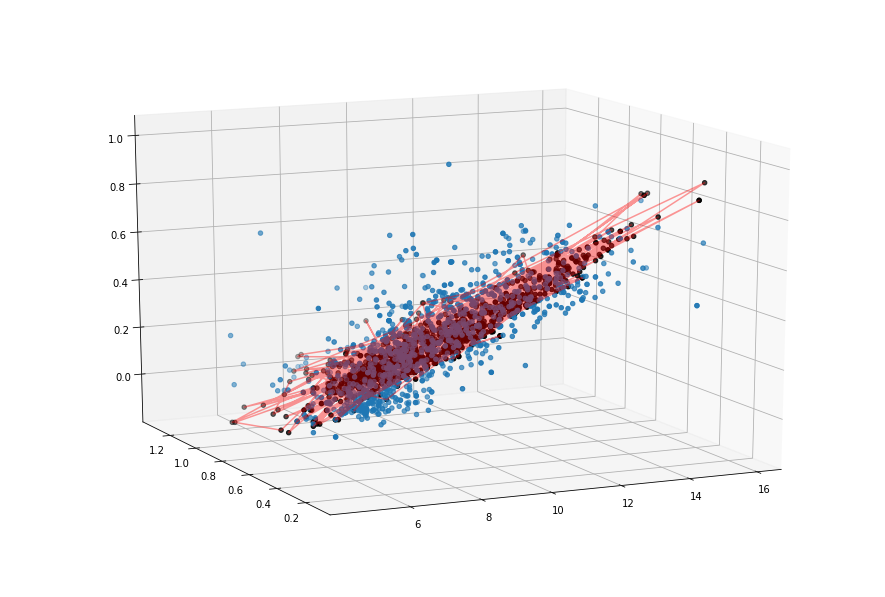

STEP: 3700, MSE: 0.0166, R2: 0.5795
Weights: [[ 0.0771085  -0.25880718]], Bias: [-0.2413289]


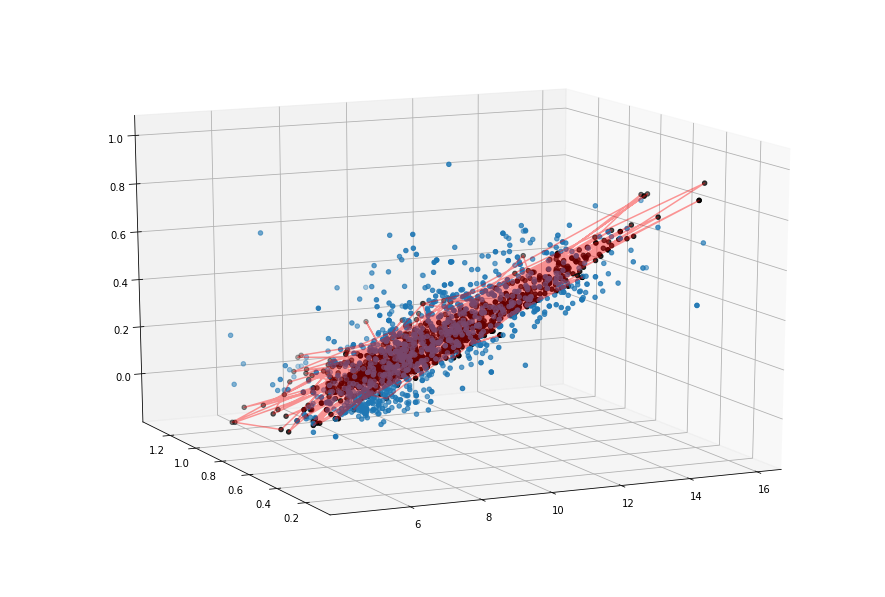

STEP: 3800, MSE: 0.0165, R2: 0.5813
Weights: [[ 0.0767409  -0.26450047]], Bias: [-0.23509033]


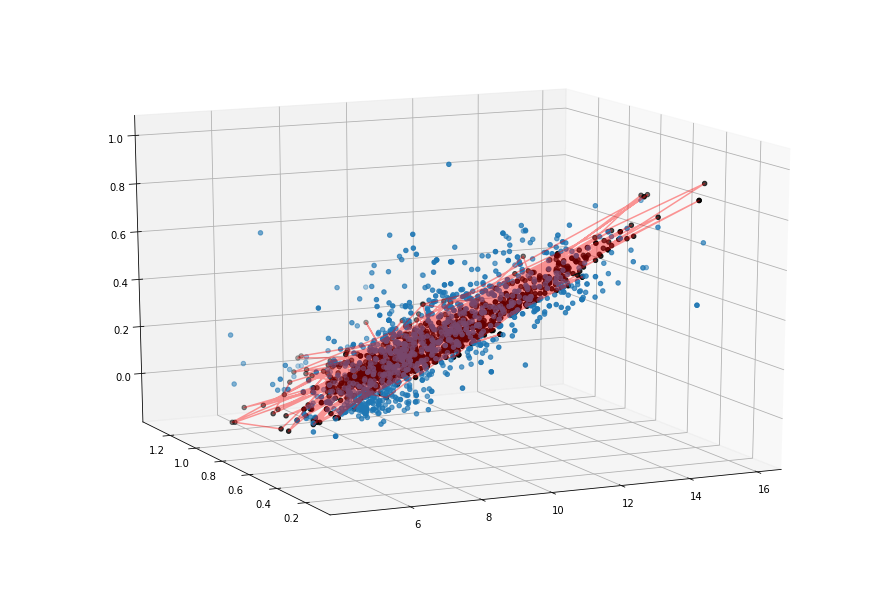

STEP: 3900, MSE: 0.0165, R2: 0.5830
Weights: [[ 0.07637873 -0.26998228]], Bias: [-0.22900909]


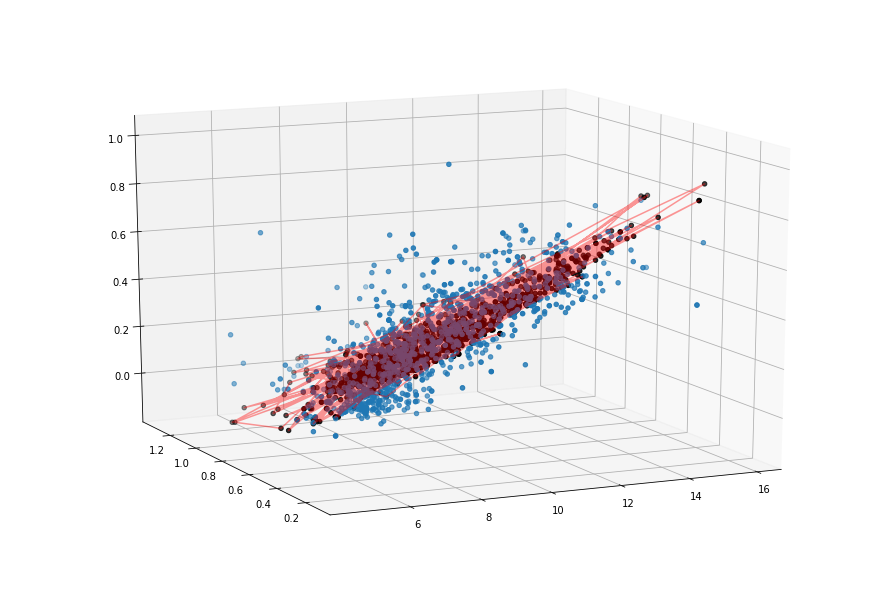

STEP: 4000, MSE: 0.0164, R2: 0.5846
Weights: [[ 0.07602264 -0.27526465]], Bias: [-0.22308496]


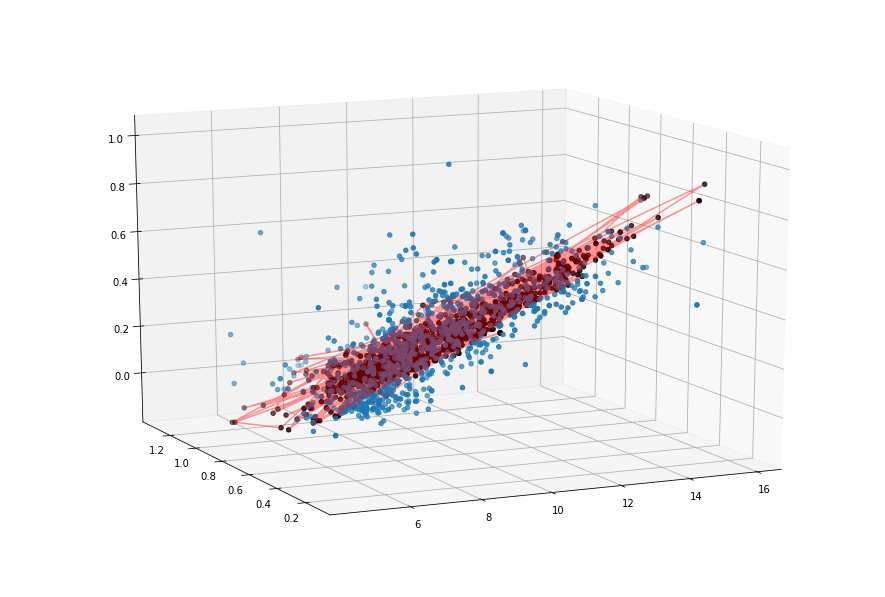

STEP: 4100, MSE: 0.0163, R2: 0.5861
Weights: [[ 0.07567316 -0.28035843]], Bias: [-0.21731716]


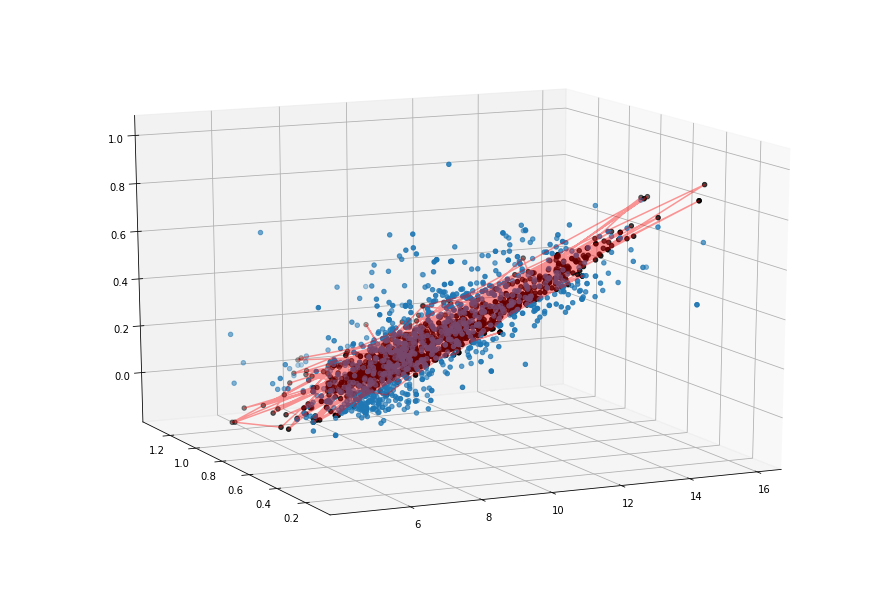

STEP: 4200, MSE: 0.0163, R2: 0.5875
Weights: [[ 0.07533068 -0.28527346]], Bias: [-0.21170418]


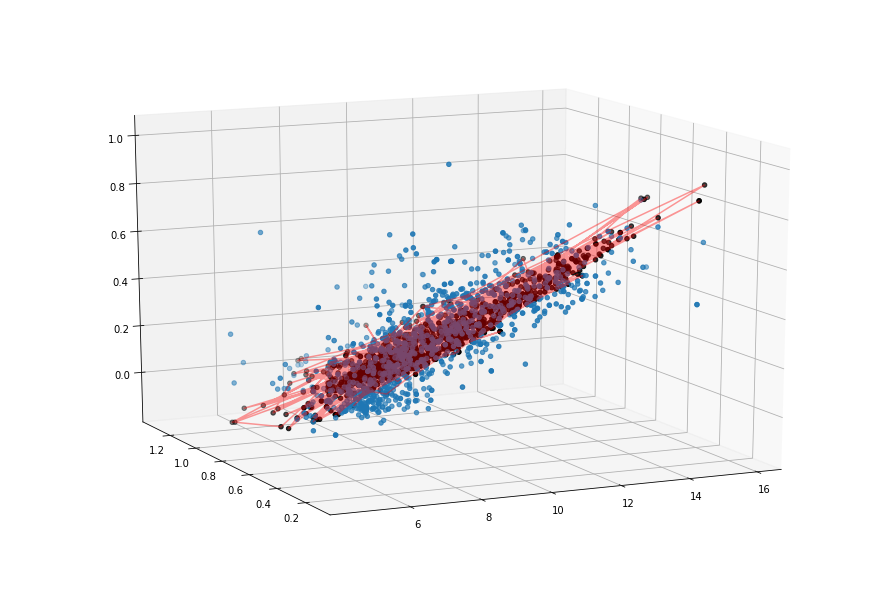

STEP: 4300, MSE: 0.0162, R2: 0.5888
Weights: [[ 0.07499551 -0.29001865]], Bias: [-0.20624423]


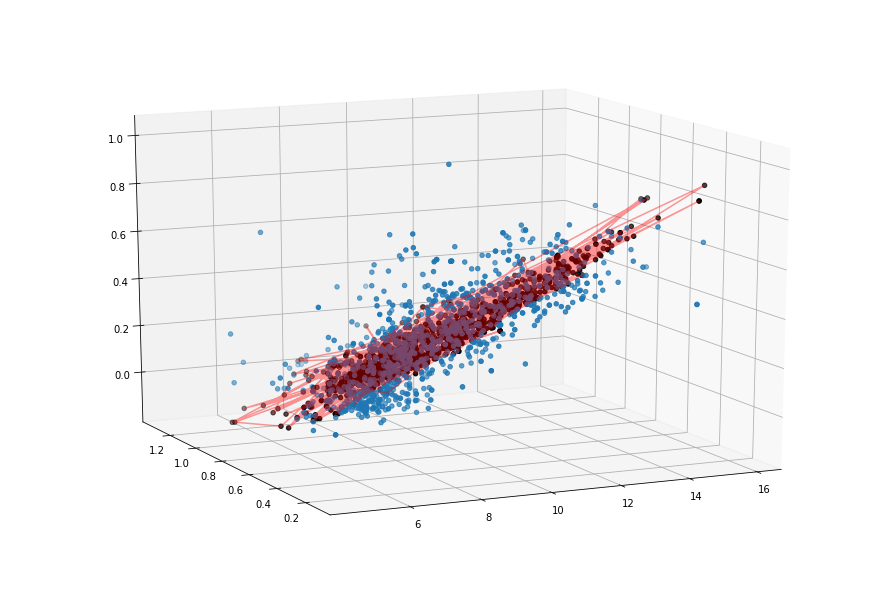

STEP: 4400, MSE: 0.0162, R2: 0.5901
Weights: [[ 0.07466791 -0.29460219]], Bias: [-0.20093544]


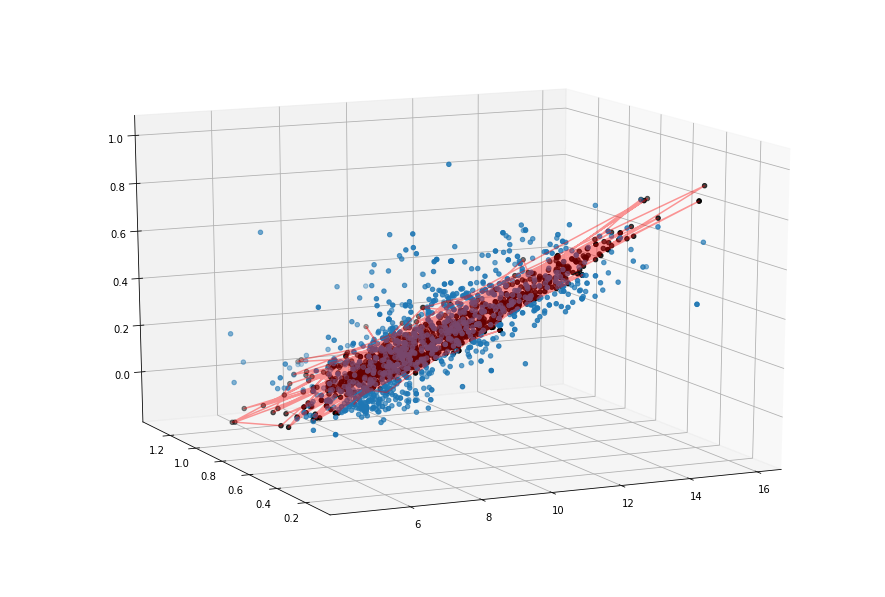

STEP: 4500, MSE: 0.0161, R2: 0.5912
Weights: [[ 0.07434795 -0.29903132]], Bias: [-0.19577482]


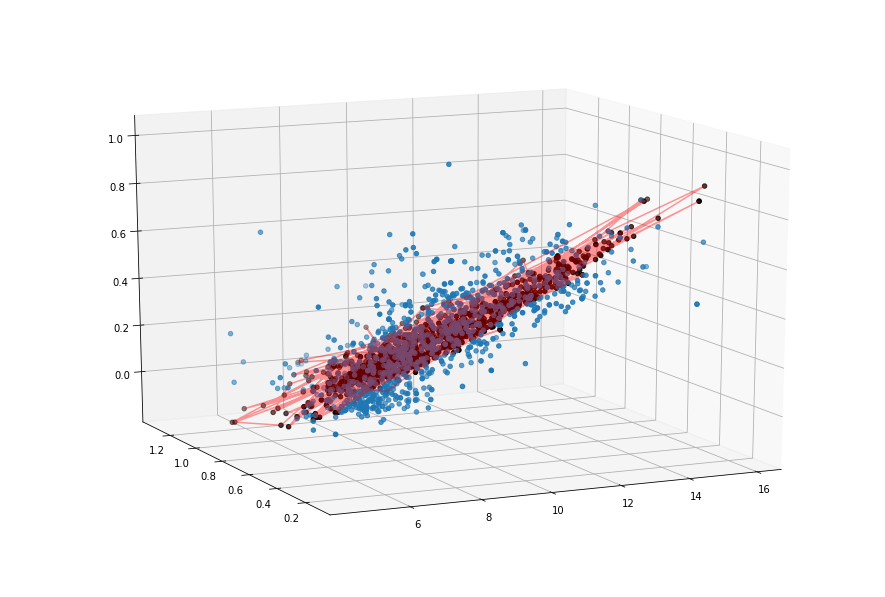

STEP: 4600, MSE: 0.0161, R2: 0.5923
Weights: [[ 0.07403577 -0.30331334]], Bias: [-0.19075979]


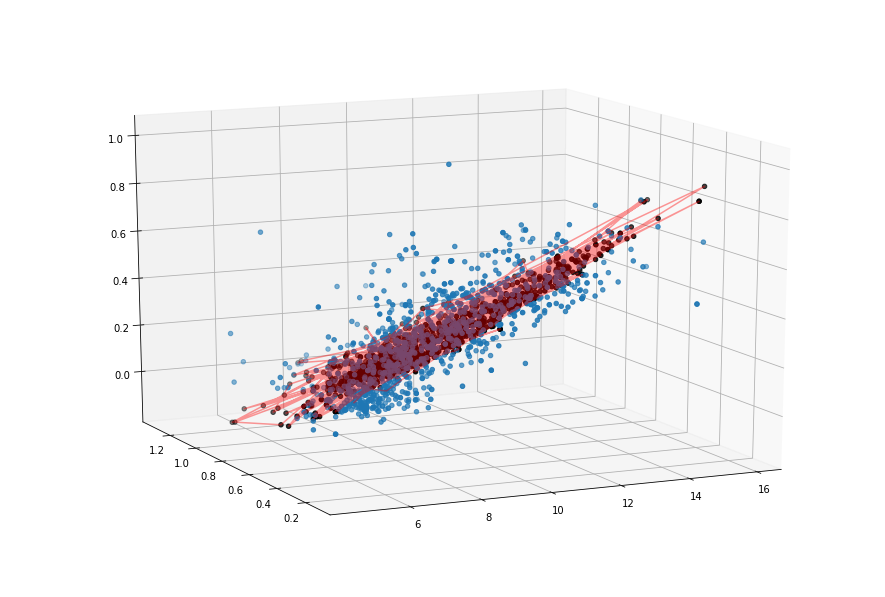

STEP: 4700, MSE: 0.0161, R2: 0.5934
Weights: [[ 0.0737314  -0.30745447]], Bias: [-0.18588756]


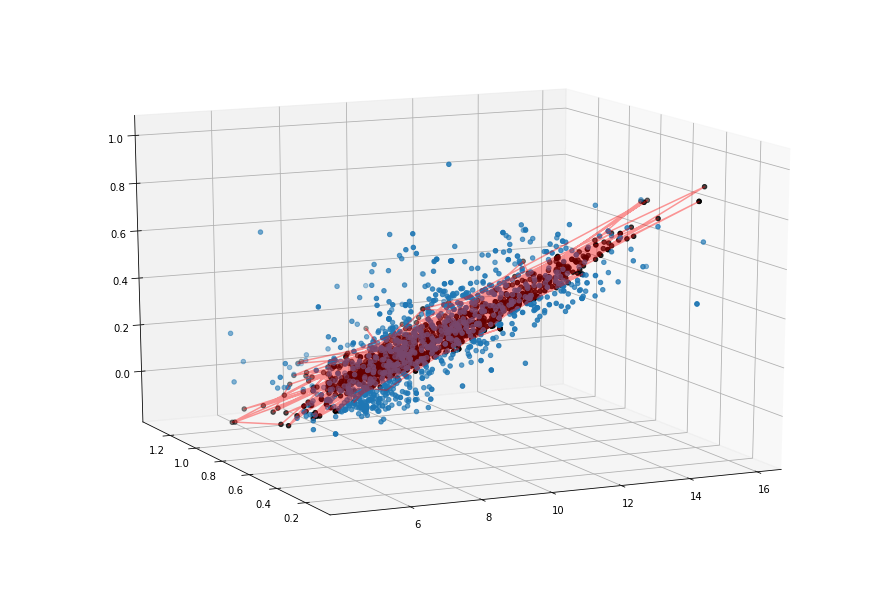

STEP: 4800, MSE: 0.0160, R2: 0.5943
Weights: [[ 0.07343484 -0.31146044]], Bias: [-0.18115516]


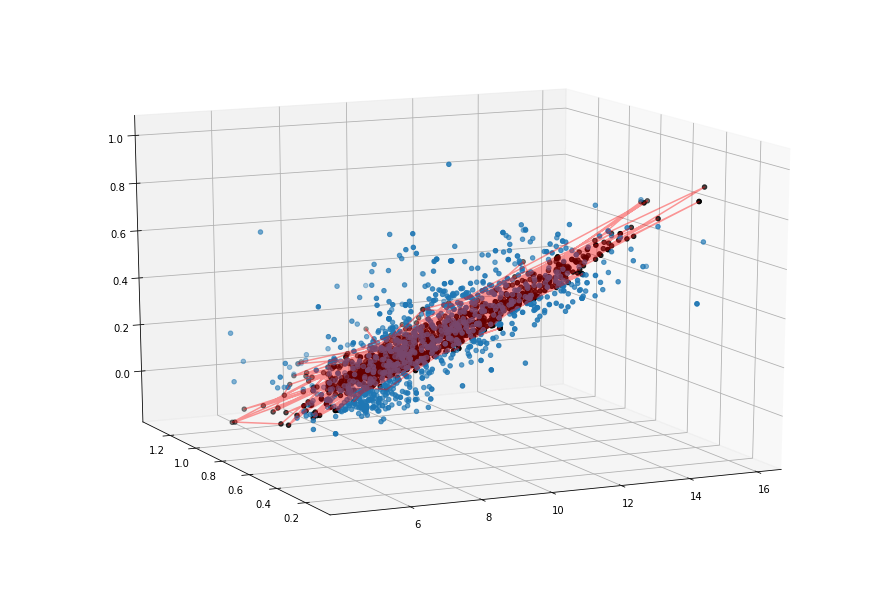

STEP: 4900, MSE: 0.0160, R2: 0.5953
Weights: [[ 0.07314606 -0.31533685]], Bias: [-0.17655948]


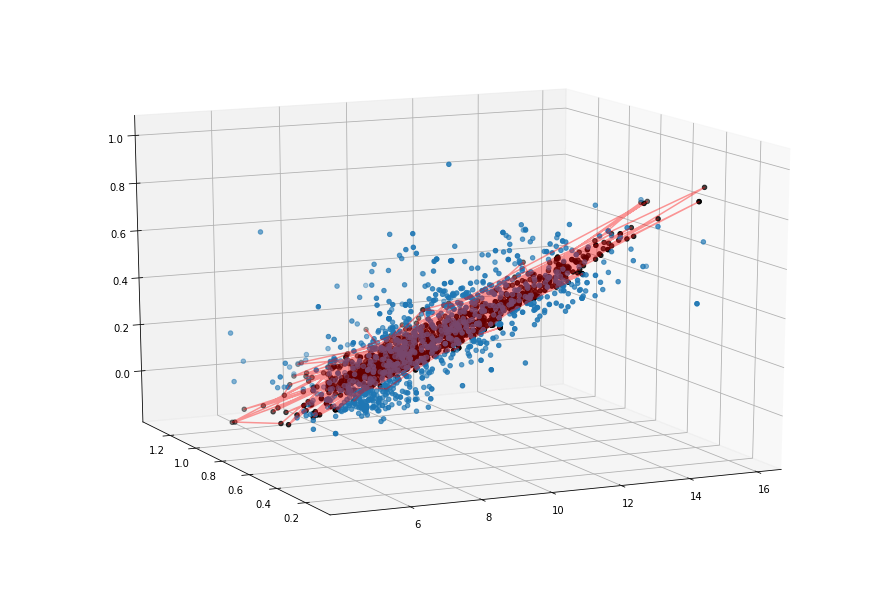

STEP: 5000, MSE: 0.0159, R2: 0.5961
Weights: [[ 0.072865   -0.31908882]], Bias: [-0.17209728]


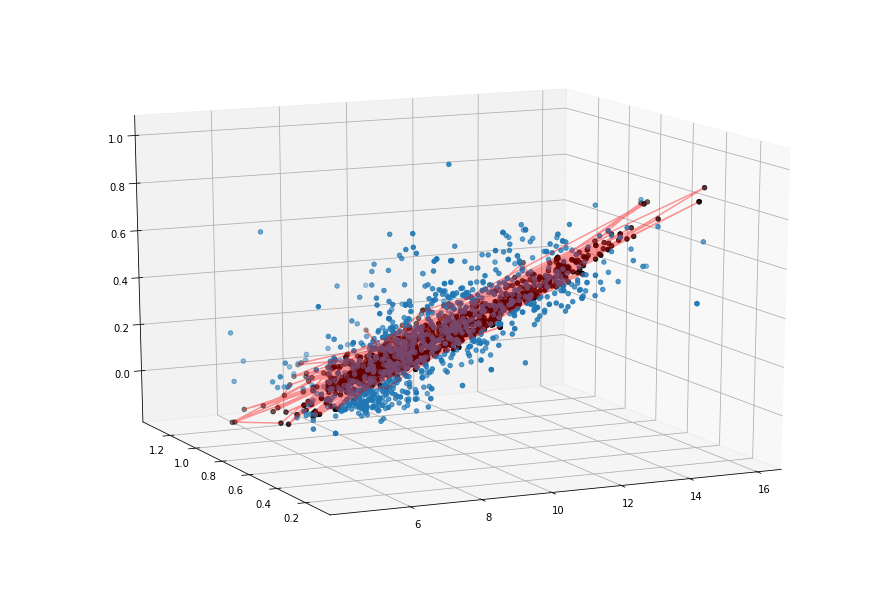

STEP: 5100, MSE: 0.0159, R2: 0.5969
Weights: [[ 0.07259158 -0.32272109]], Bias: [-0.16776538]


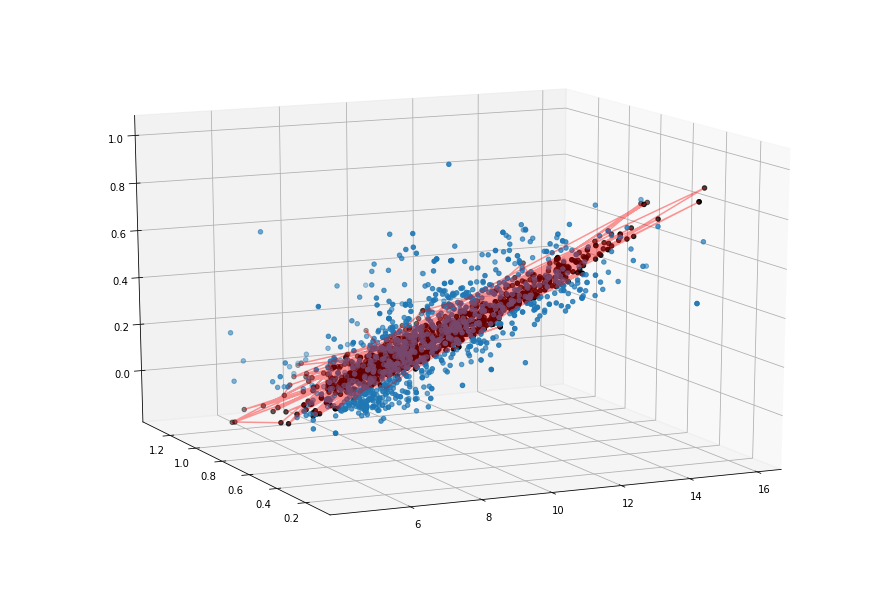

STEP: 5200, MSE: 0.0159, R2: 0.5977
Weights: [[ 0.07232568 -0.32623813]], Bias: [-0.16356051]


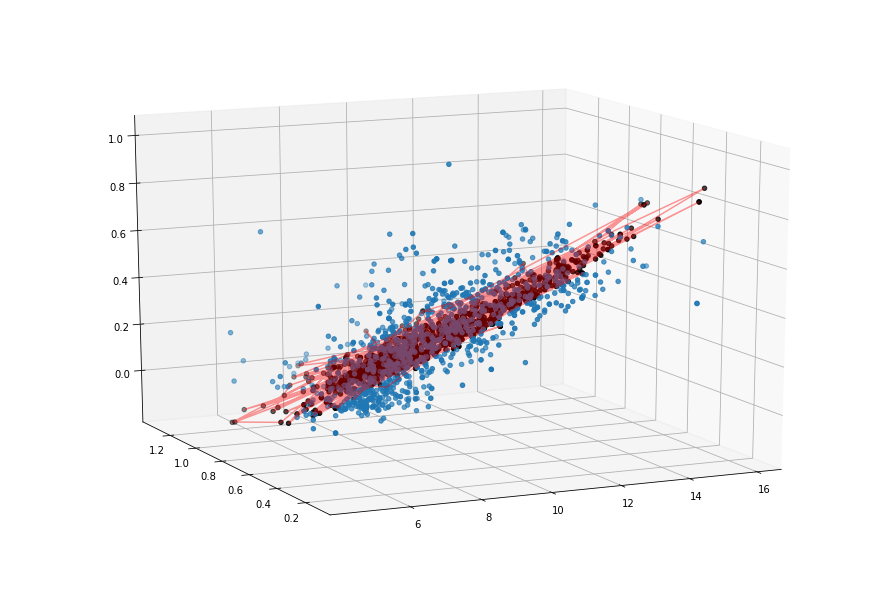

STEP: 5300, MSE: 0.0159, R2: 0.5984
Weights: [[ 0.07206719 -0.32964423]], Bias: [-0.15947947]


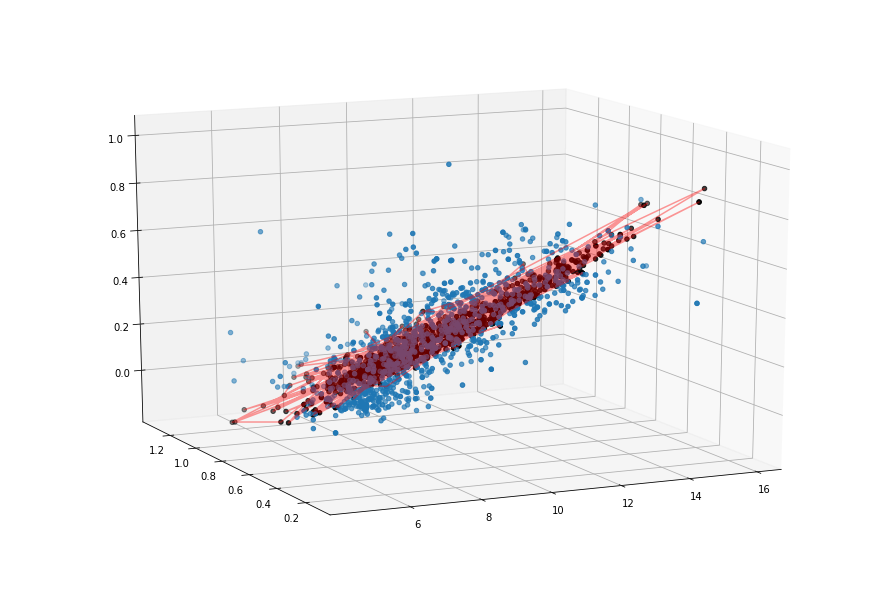

STEP: 5400, MSE: 0.0158, R2: 0.5991
Weights: [[ 0.07181598 -0.33294338]], Bias: [-0.15551893]


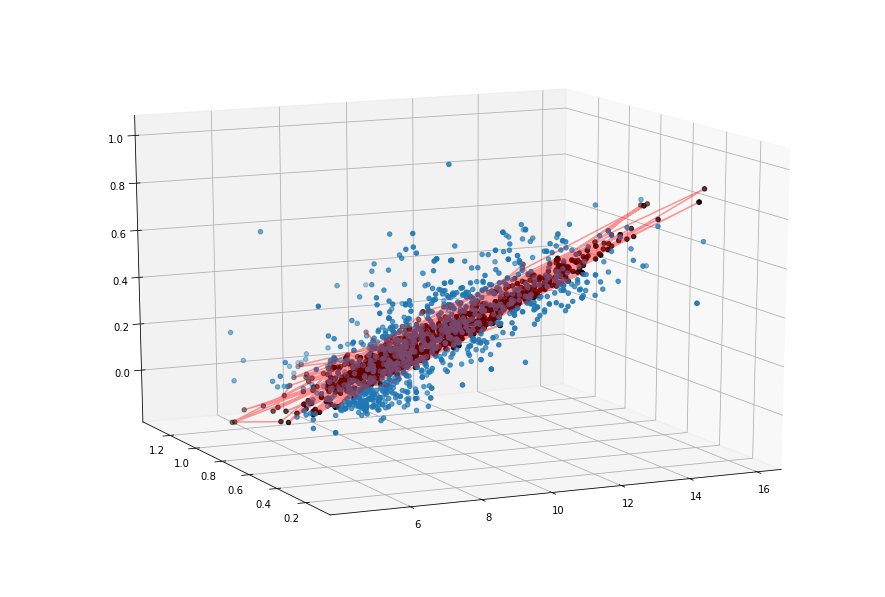

STEP: 5500, MSE: 0.0158, R2: 0.5997
Weights: [[ 0.07157191 -0.33613935]], Bias: [-0.15167582]


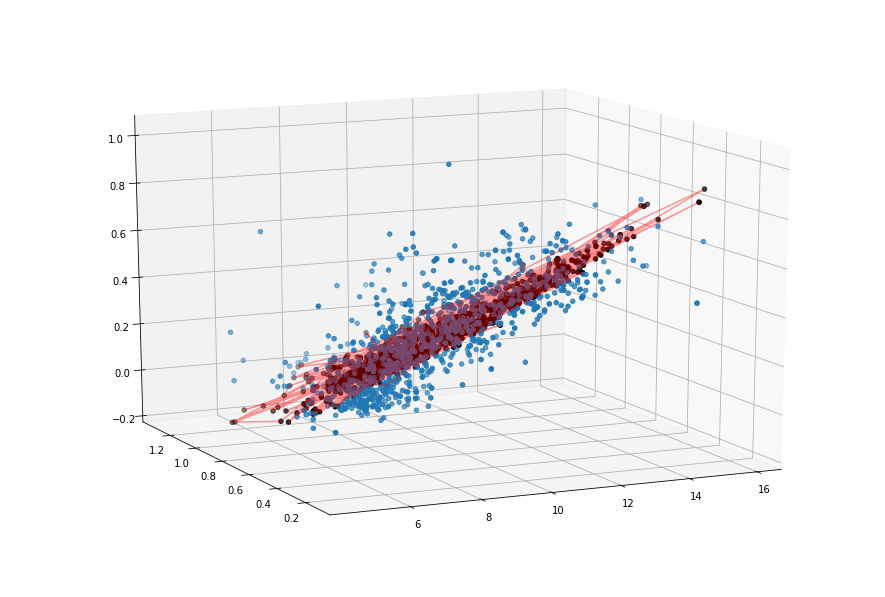

STEP: 5600, MSE: 0.0158, R2: 0.6003
Weights: [[ 0.07133483 -0.33923569]], Bias: [-0.14794691]


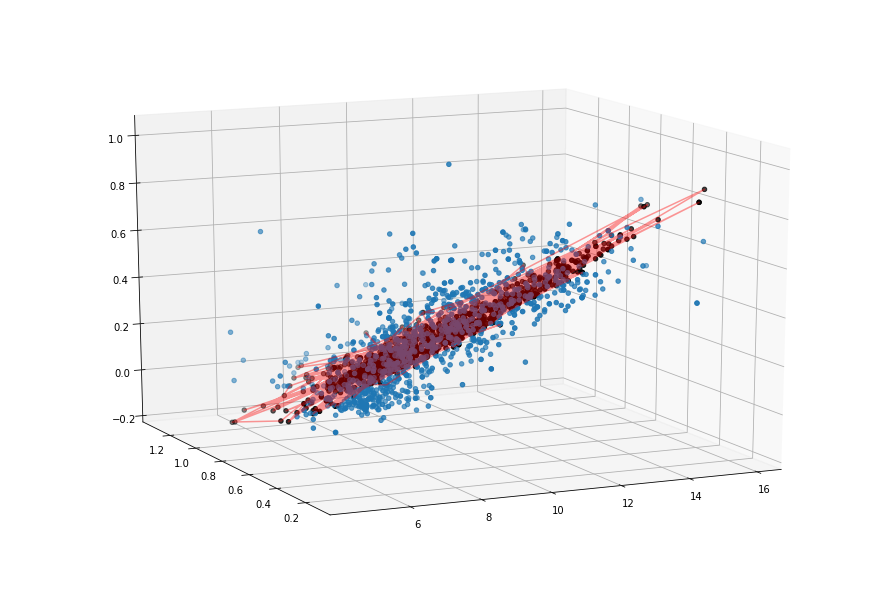

STEP: 5700, MSE: 0.0158, R2: 0.6009
Weights: [[ 0.07110459 -0.34223598]], Bias: [-0.144329]


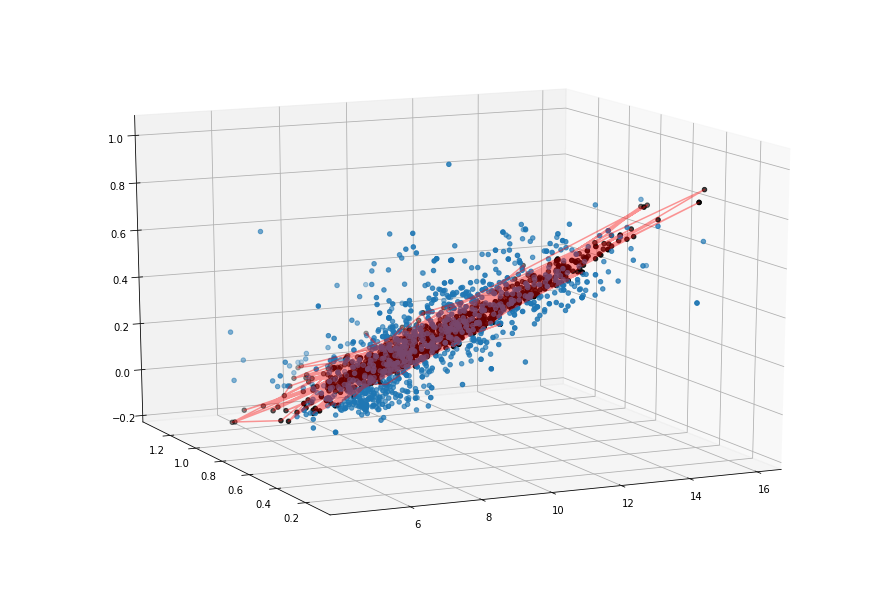

STEP: 5800, MSE: 0.0157, R2: 0.6014
Weights: [[ 0.07088102 -0.34514332]], Bias: [-0.14081903]


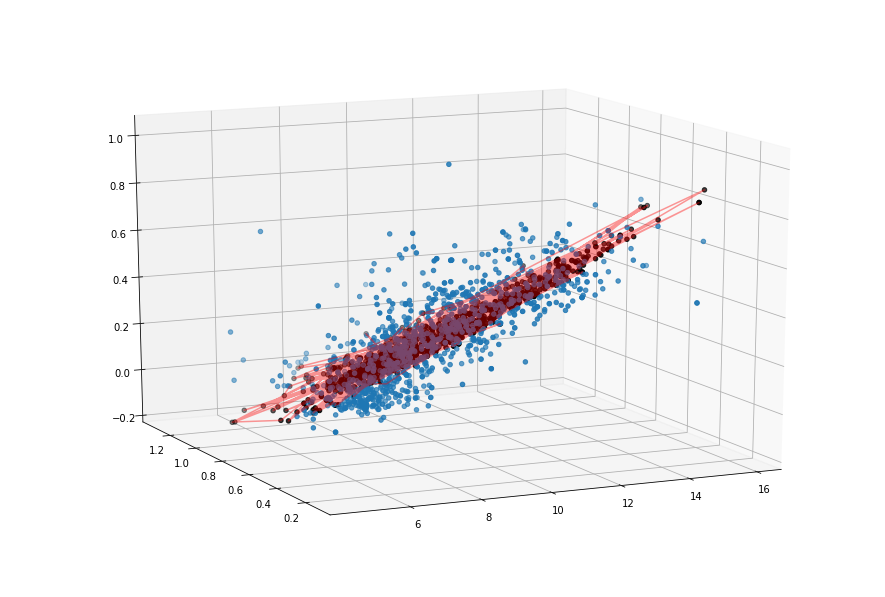

STEP: 5900, MSE: 0.0157, R2: 0.6019
Weights: [[ 0.07066396 -0.3479608 ]], Bias: [-0.13741395]


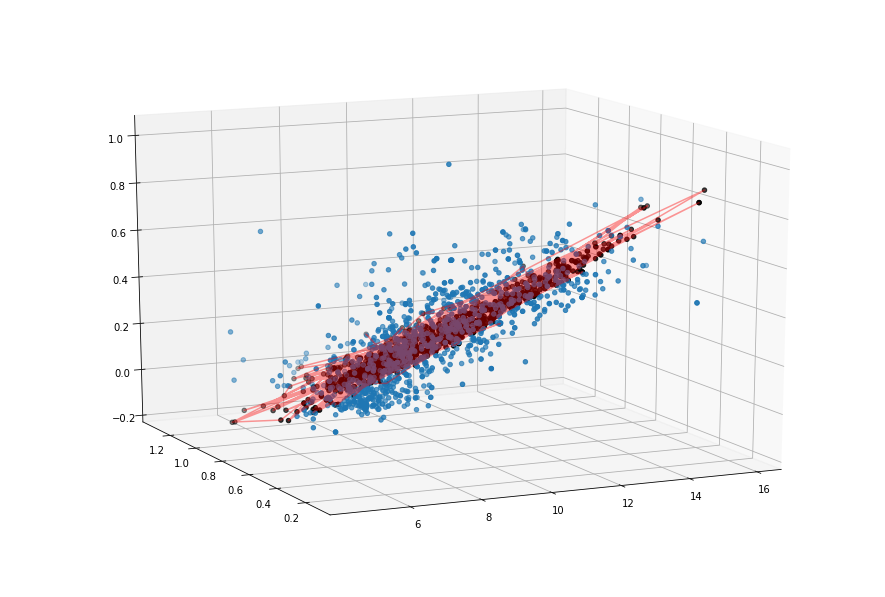

STEP: 6000, MSE: 0.0157, R2: 0.6024
Weights: [[ 0.07045327 -0.35069153]], Bias: [-0.13411088]


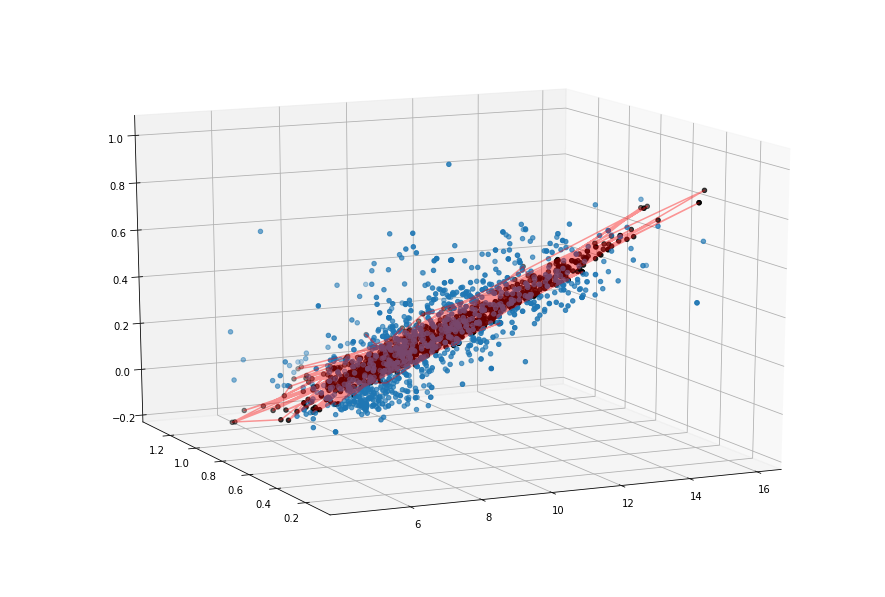

STEP: 6100, MSE: 0.0157, R2: 0.6028
Weights: [[ 0.07024878 -0.35333824]], Bias: [-0.13090682]


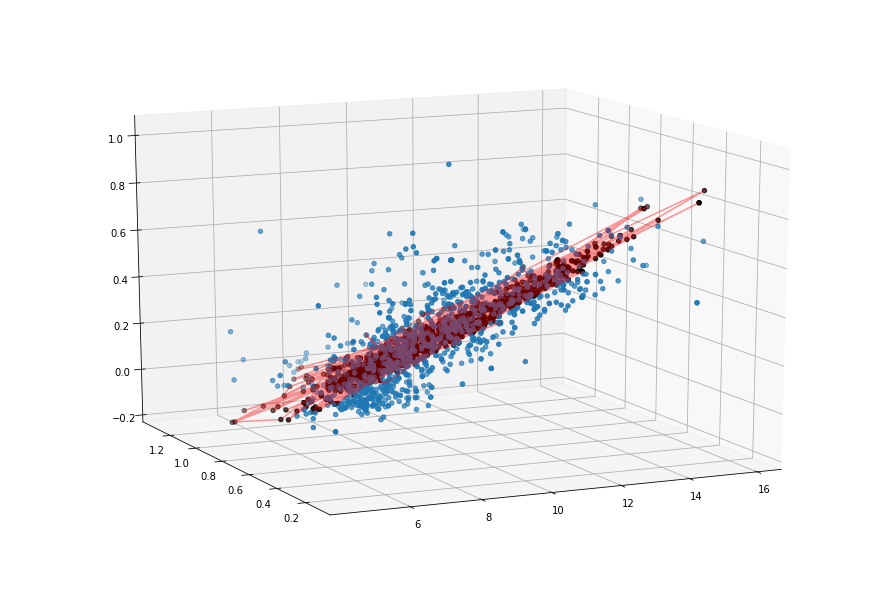

STEP: 6200, MSE: 0.0157, R2: 0.6032
Weights: [[ 0.07005032 -0.35590371]], Bias: [-0.12779894]


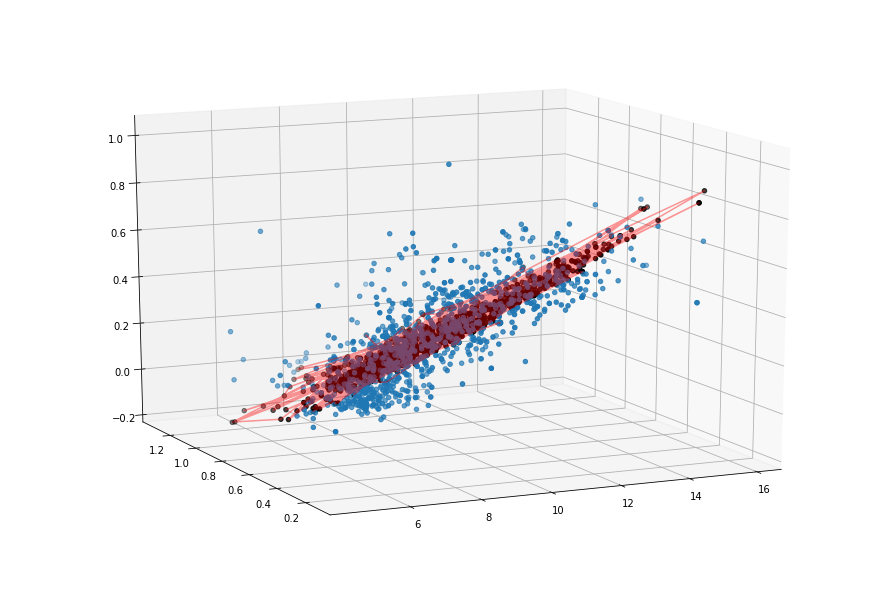

STEP: 6300, MSE: 0.0157, R2: 0.6036
Weights: [[ 0.06985775 -0.35839051]], Bias: [-0.12478448]


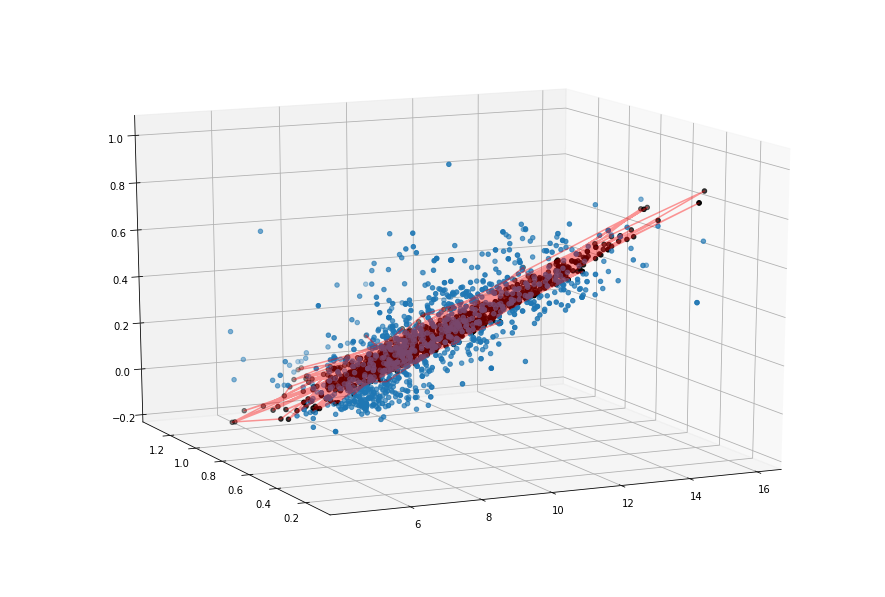

STEP: 6400, MSE: 0.0156, R2: 0.6040
Weights: [[ 0.06967087 -0.36080101]], Bias: [-0.1218607]


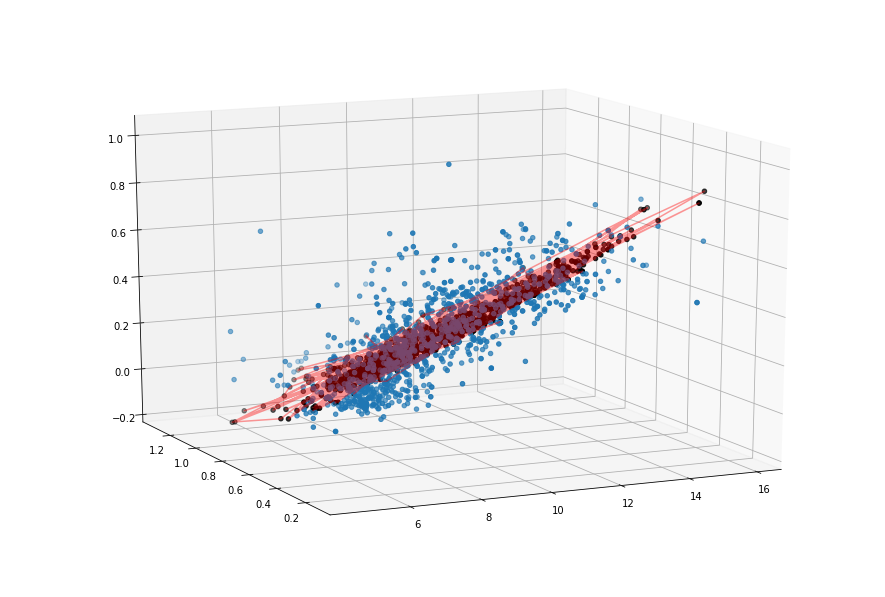

STEP: 6500, MSE: 0.0156, R2: 0.6043
Weights: [[ 0.06948958 -0.36313796]], Bias: [-0.11902493]


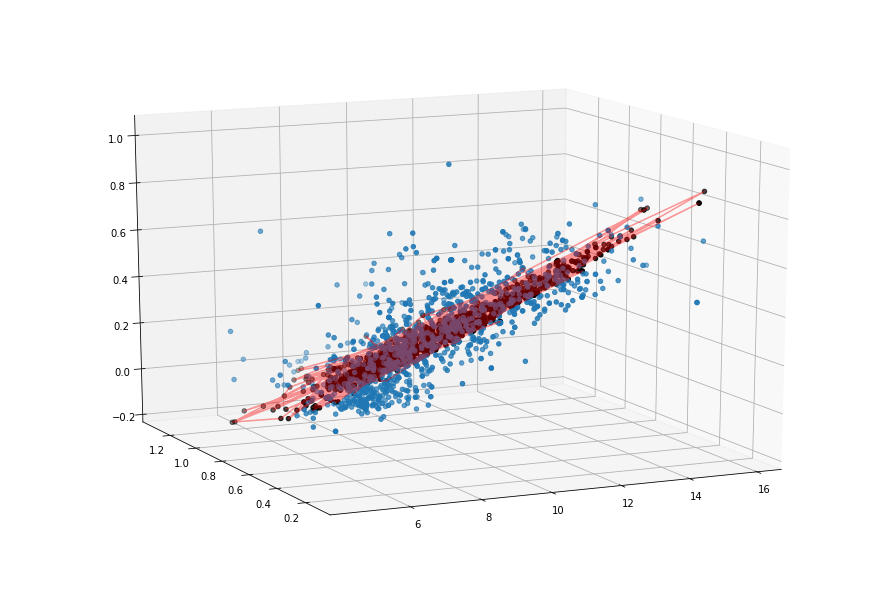

STEP: 6600, MSE: 0.0156, R2: 0.6046
Weights: [[ 0.06931368 -0.36540353]], Bias: [-0.11627458]


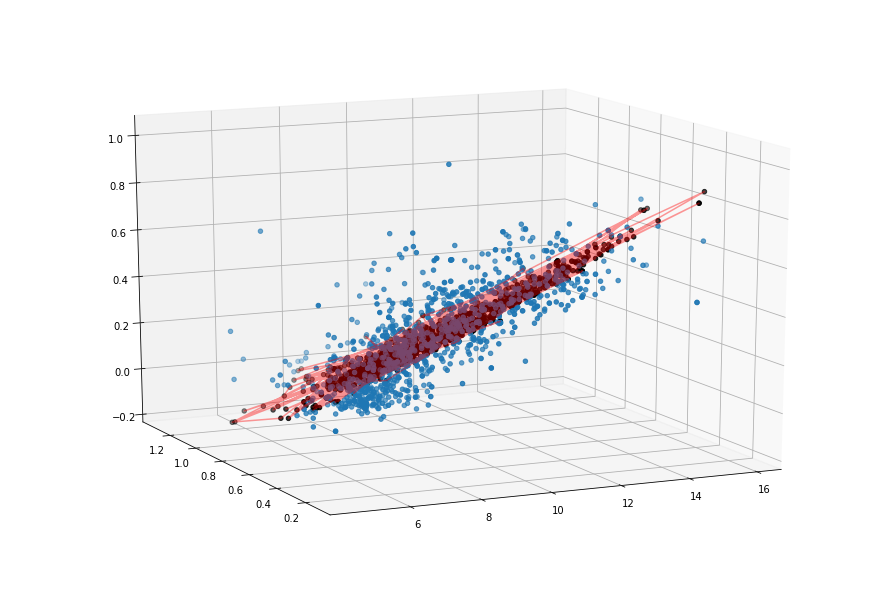

STEP: 6700, MSE: 0.0156, R2: 0.6049
Weights: [[ 0.06914303 -0.3675999 ]], Bias: [-0.11360713]


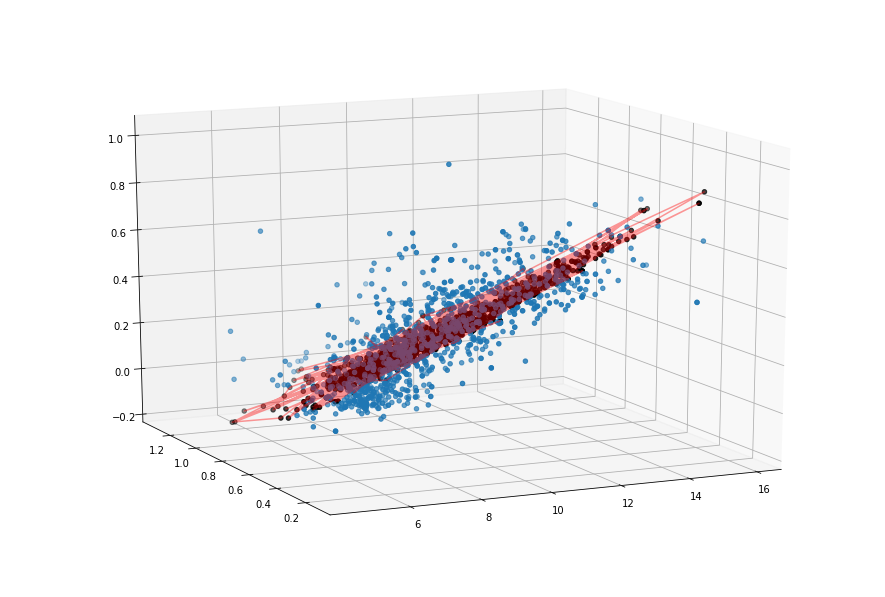

STEP: 6800, MSE: 0.0156, R2: 0.6052
Weights: [[ 0.0689775  -0.36972937]], Bias: [-0.11102016]


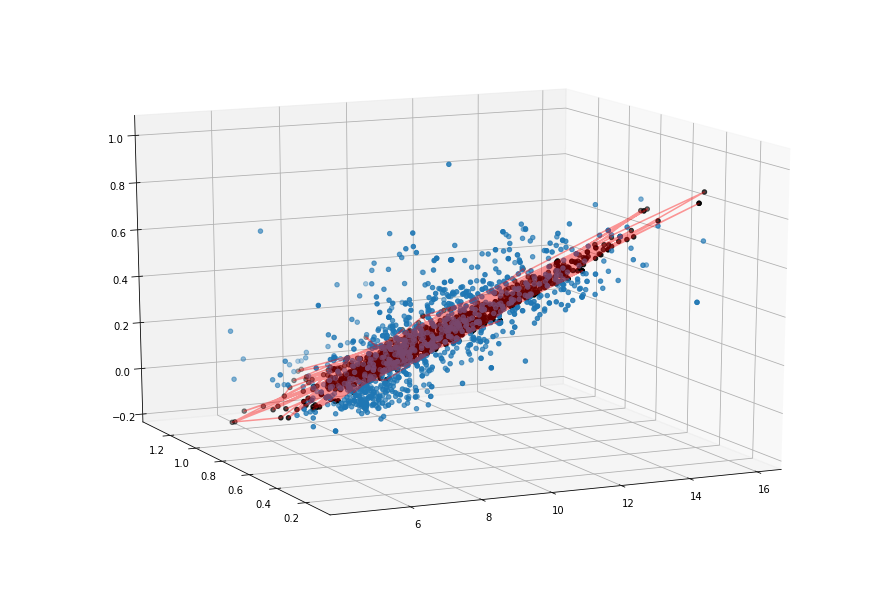

STEP: 6900, MSE: 0.0156, R2: 0.6055
Weights: [[ 0.06881692 -0.3717939 ]], Bias: [-0.10851124]


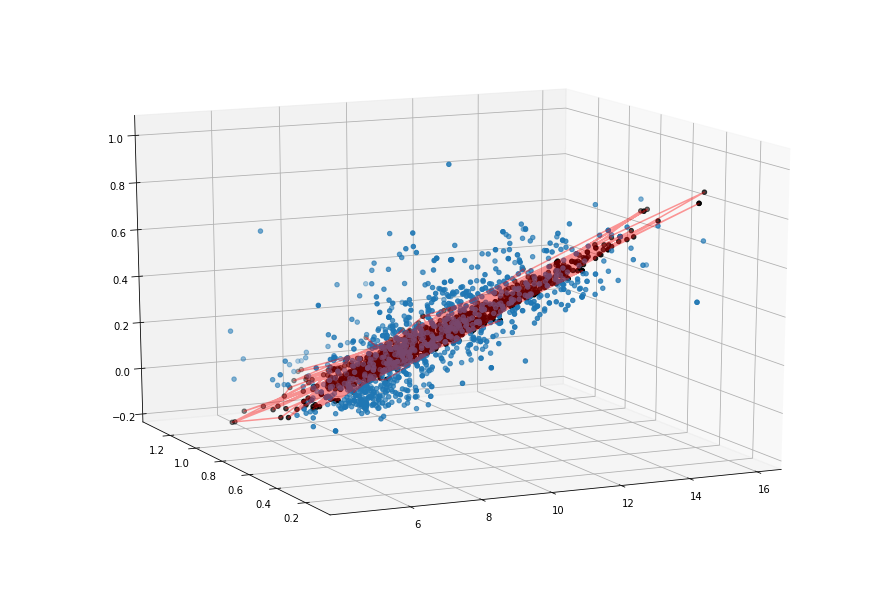

STEP: 7000, MSE: 0.0156, R2: 0.6058
Weights: [[ 0.06866118 -0.3737956 ]], Bias: [-0.10607822]


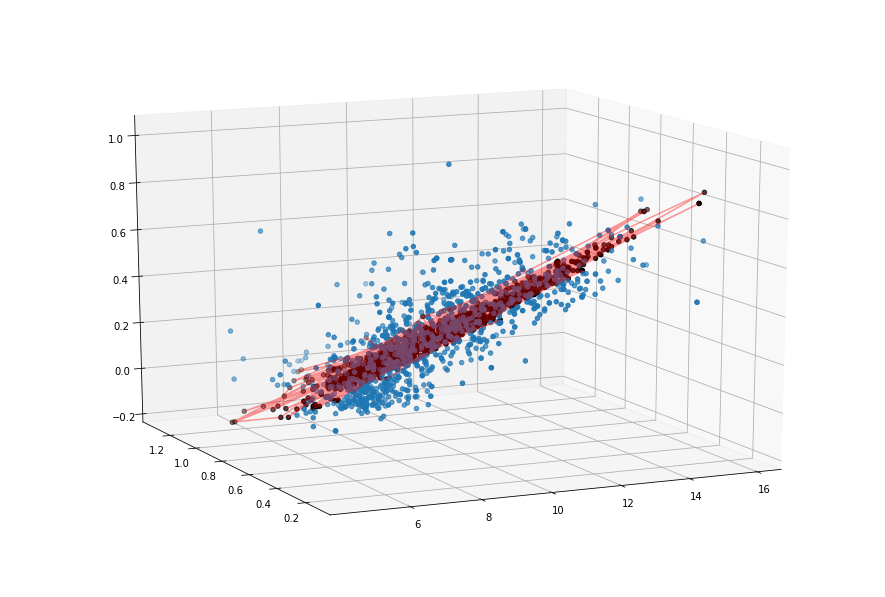

STEP: 7100, MSE: 0.0156, R2: 0.6060
Weights: [[ 0.06851011 -0.37573642]], Bias: [-0.10371855]


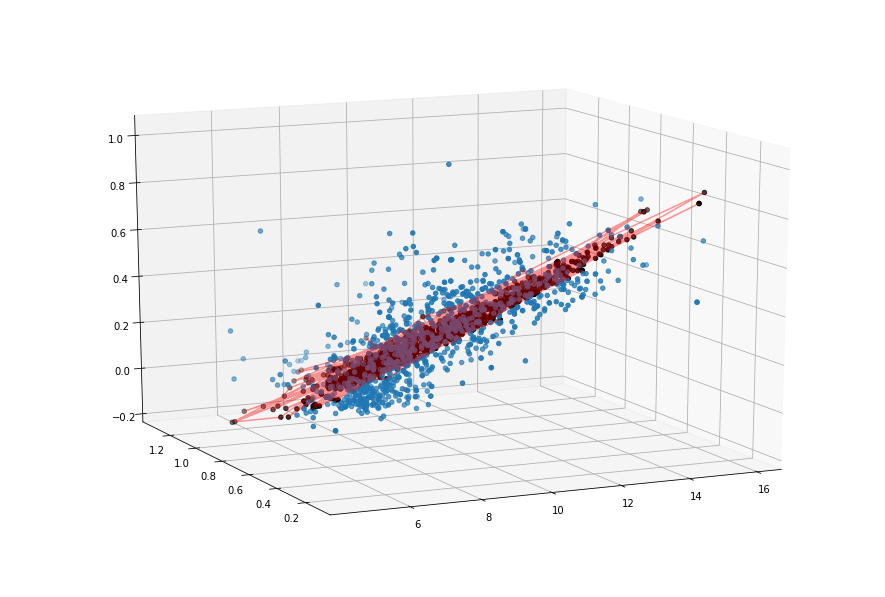

STEP: 7200, MSE: 0.0156, R2: 0.6062
Weights: [[ 0.06836356 -0.37761822]], Bias: [-0.10143016]


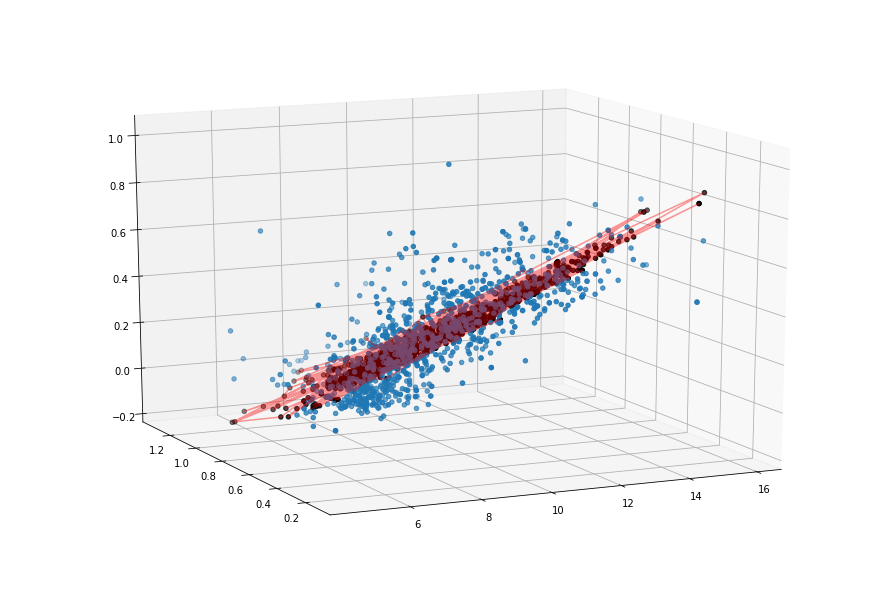

STEP: 7300, MSE: 0.0155, R2: 0.6064
Weights: [[ 0.06822145 -0.37944278]], Bias: [-0.09921096]


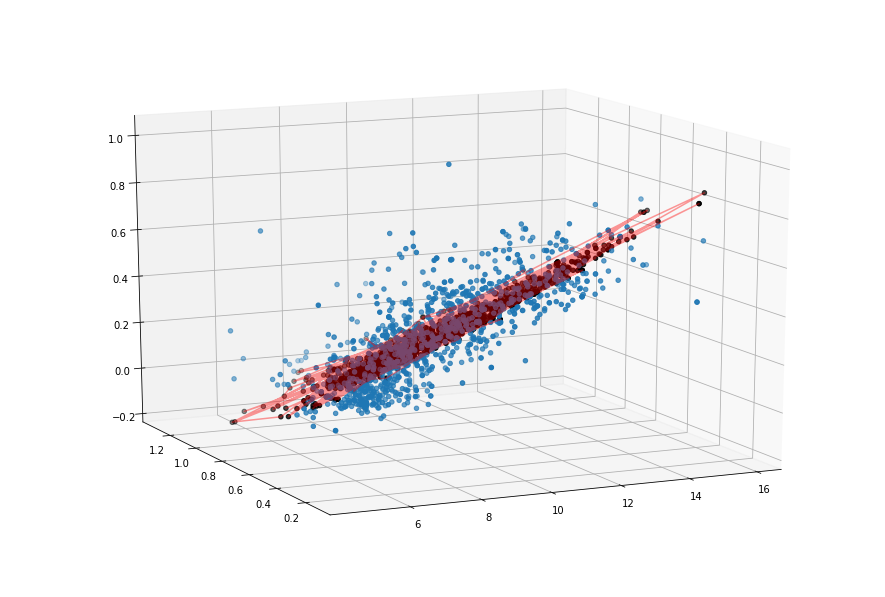

STEP: 7400, MSE: 0.0155, R2: 0.6066
Weights: [[ 0.06808361 -0.38121197]], Bias: [-0.09705884]


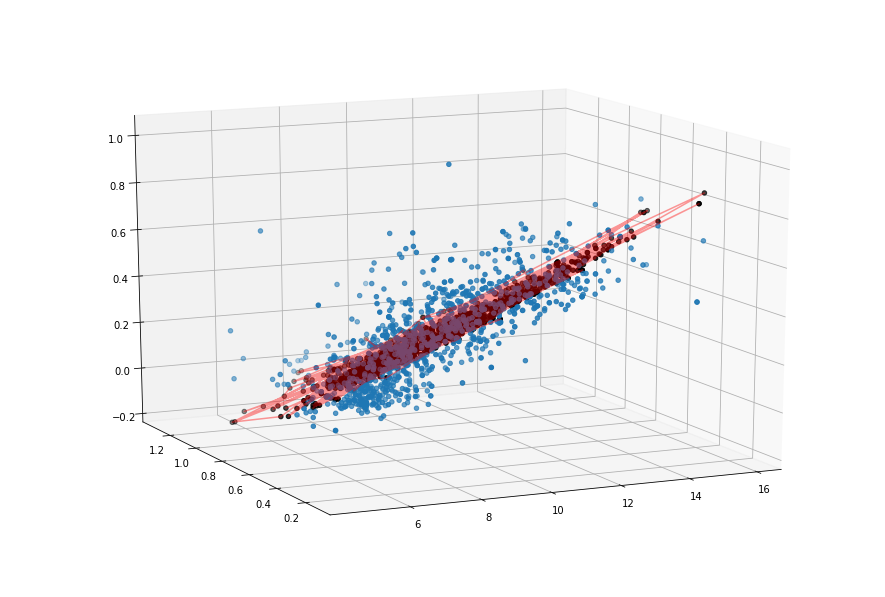

STEP: 7500, MSE: 0.0155, R2: 0.6068
Weights: [[ 0.06794991 -0.38292733]], Bias: [-0.09497179]


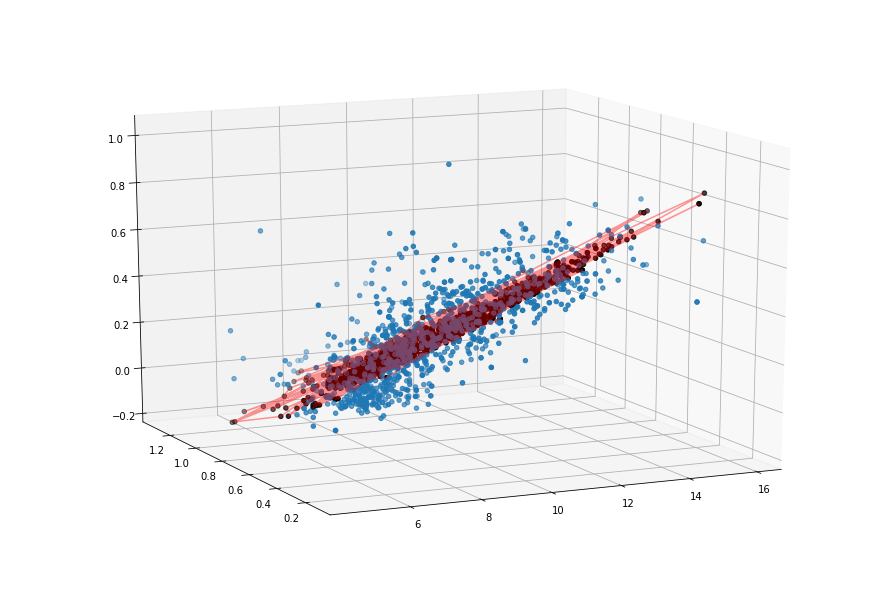

STEP: 7600, MSE: 0.0155, R2: 0.6070
Weights: [[ 0.06782026 -0.38459066]], Bias: [-0.09294789]


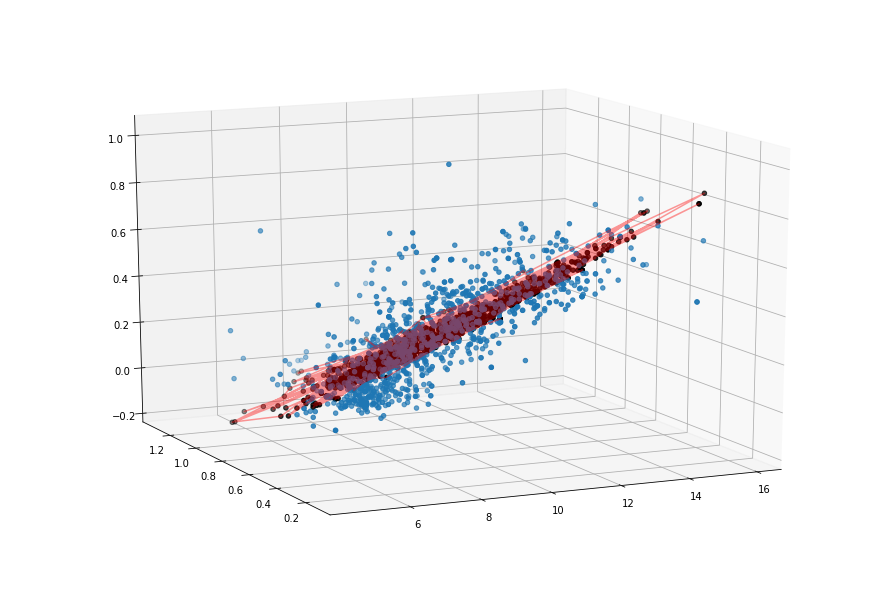

STEP: 7700, MSE: 0.0155, R2: 0.6071
Weights: [[ 0.06769451 -0.38620344]], Bias: [-0.09098521]


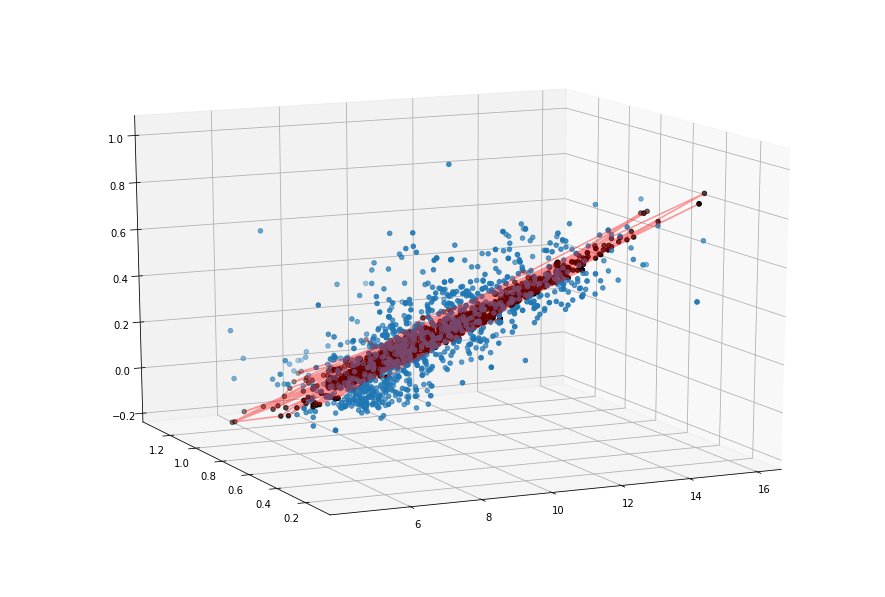

STEP: 7800, MSE: 0.0155, R2: 0.6073
Weights: [[ 0.06757256 -0.38776729]], Bias: [-0.08908193]


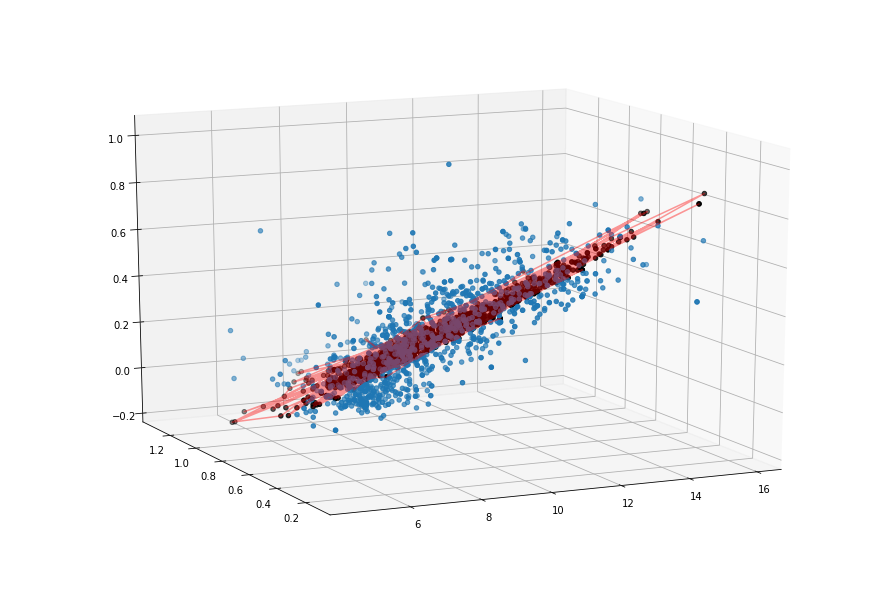

STEP: 7900, MSE: 0.0155, R2: 0.6074
Weights: [[ 0.06745431 -0.38928369]], Bias: [-0.08723623]


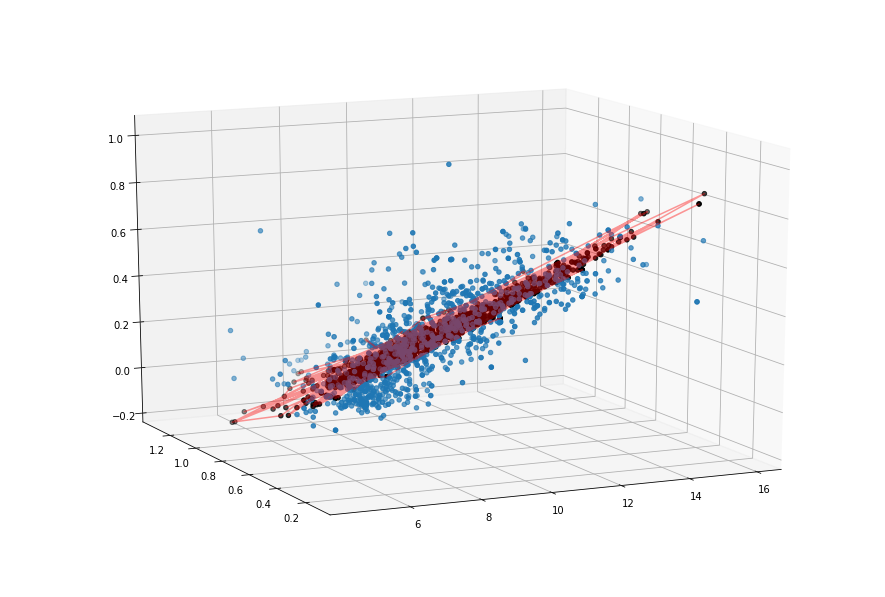

STEP: 8000, MSE: 0.0155, R2: 0.6076
Weights: [[ 0.06733961 -0.3907541 ]], Bias: [-0.08544639]


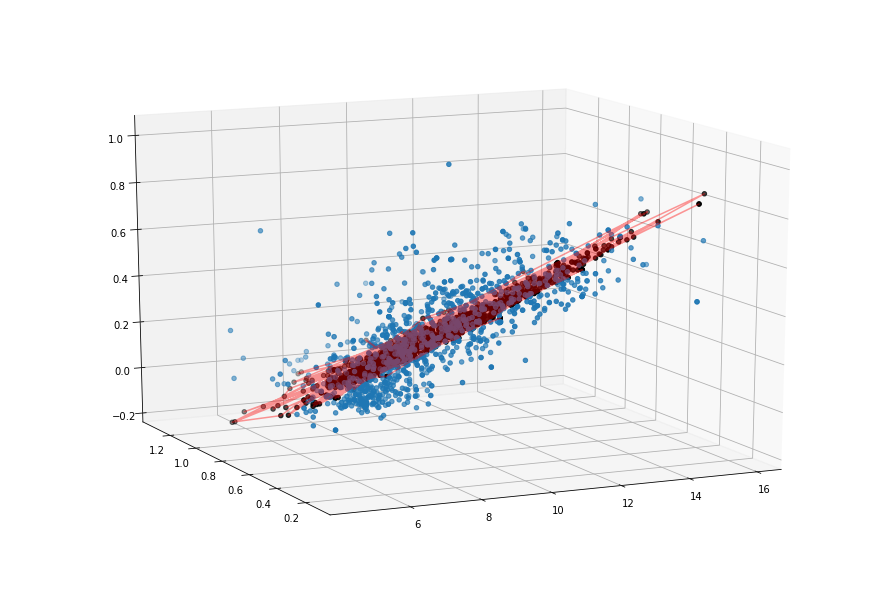

STEP: 8100, MSE: 0.0155, R2: 0.6077
Weights: [[ 0.06722838 -0.39217991]], Bias: [-0.08371075]


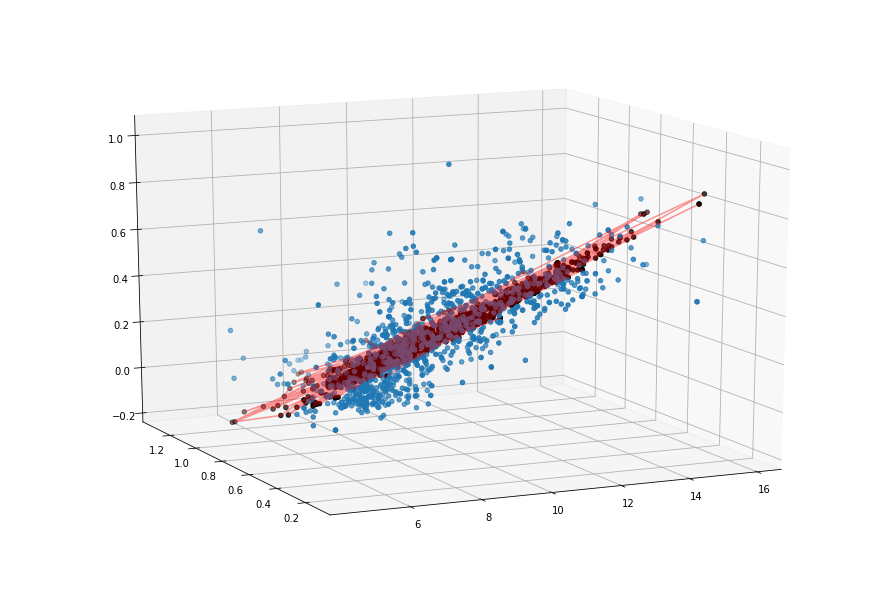

STEP: 8200, MSE: 0.0155, R2: 0.6078
Weights: [[ 0.06712053 -0.39356253]], Bias: [-0.08202762]


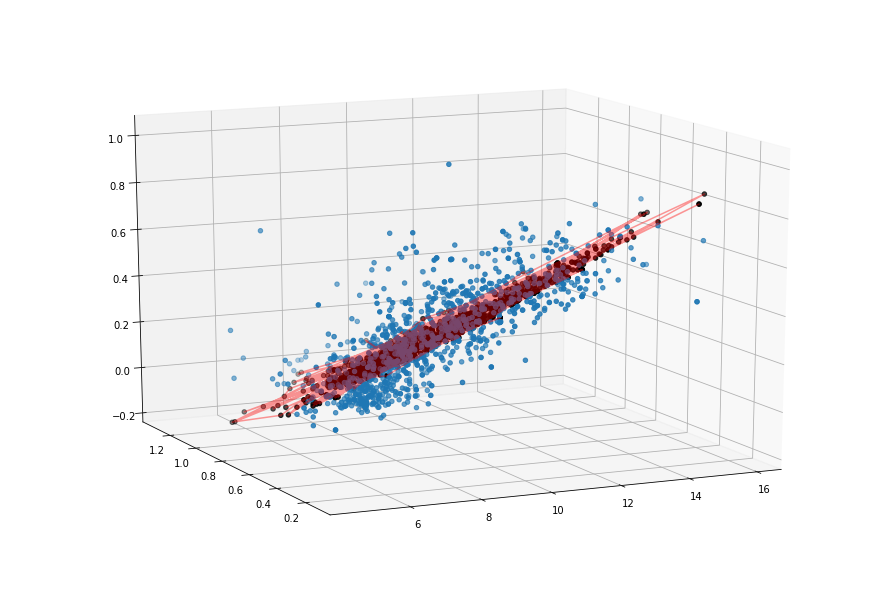

STEP: 8300, MSE: 0.0155, R2: 0.6079
Weights: [[ 0.06701592 -0.39490315]], Bias: [-0.08039543]


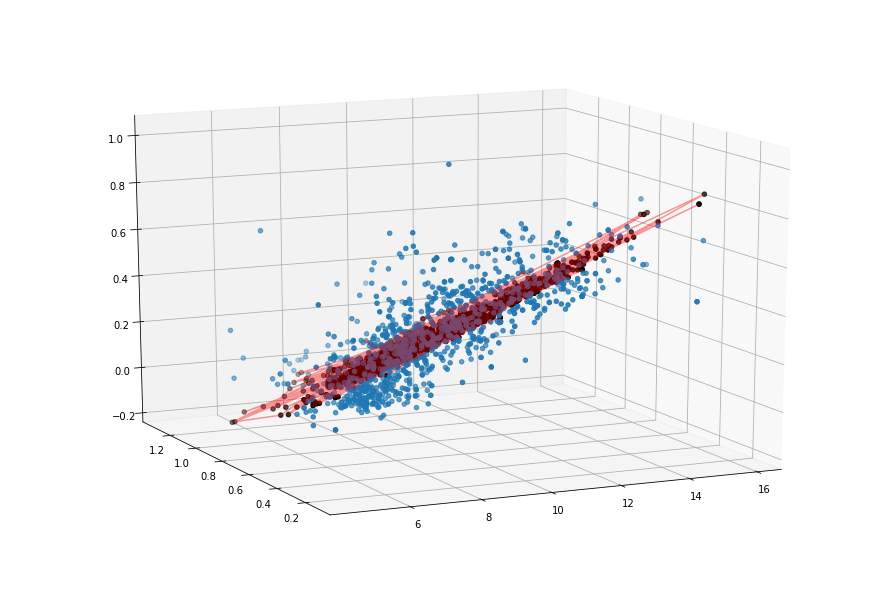

STEP: 8400, MSE: 0.0155, R2: 0.6080
Weights: [[ 0.06691449 -0.39620319]], Bias: [-0.07881268]


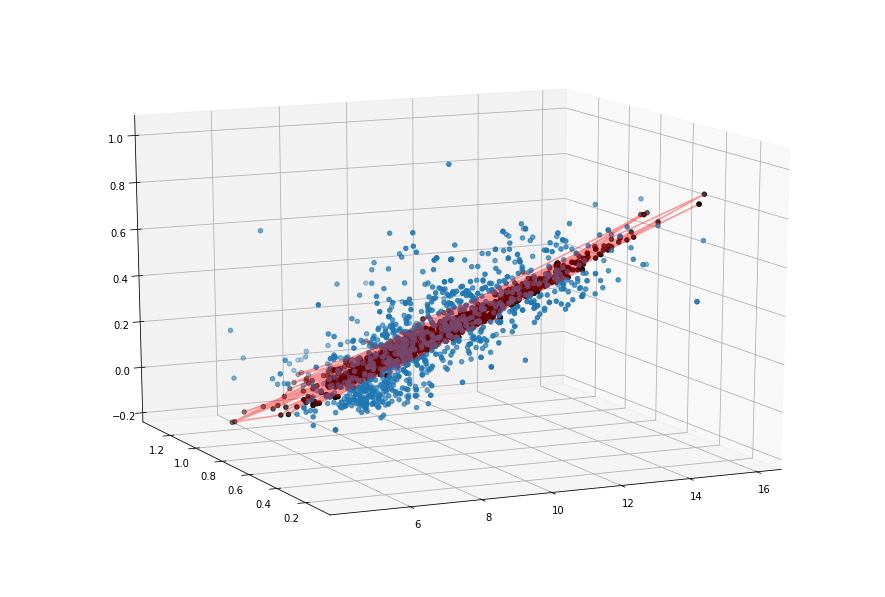

STEP: 8500, MSE: 0.0155, R2: 0.6081
Weights: [[ 0.06681612 -0.39746374]], Bias: [-0.07727785]


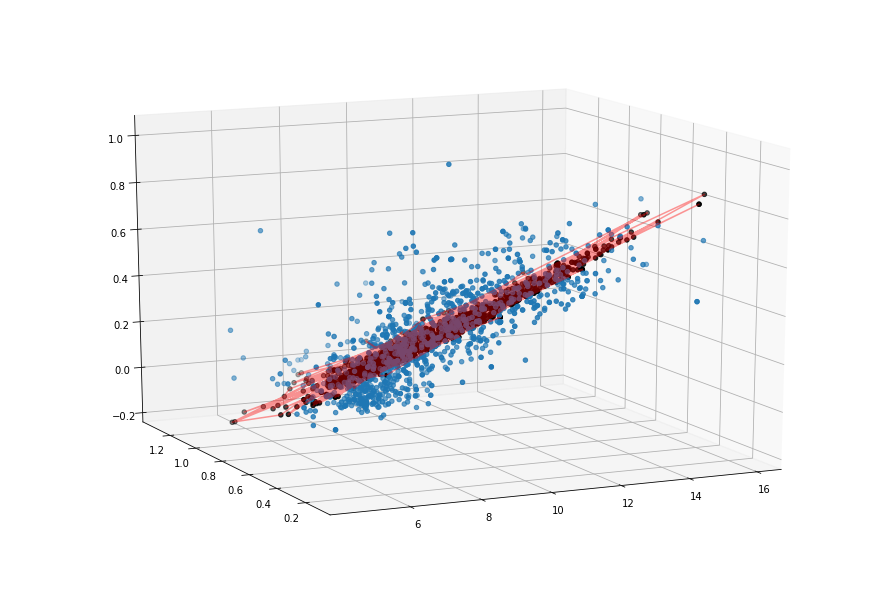

STEP: 8600, MSE: 0.0155, R2: 0.6082
Weights: [[ 0.06672072 -0.39868608]], Bias: [-0.07578951]


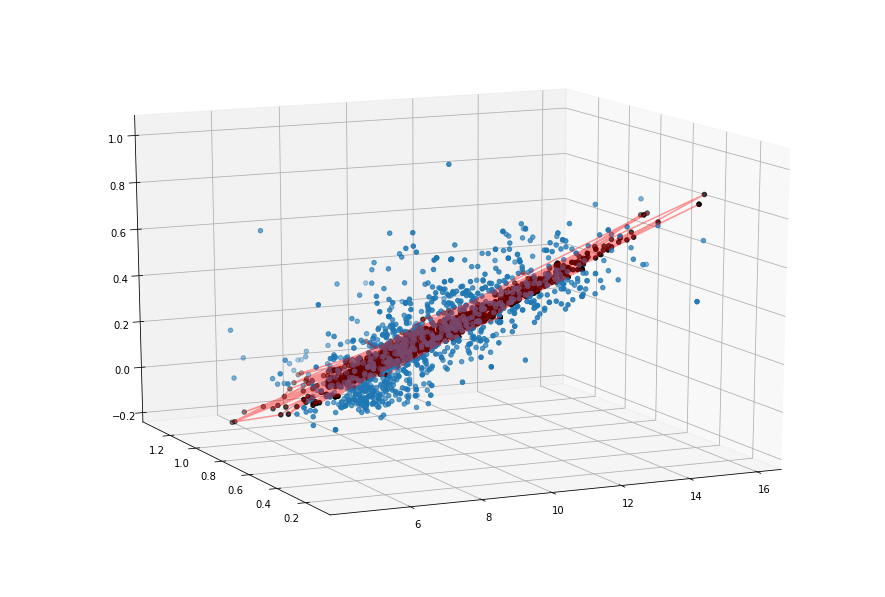

STEP: 8700, MSE: 0.0155, R2: 0.6083
Weights: [[ 0.06662822 -0.39987138]], Bias: [-0.07434621]


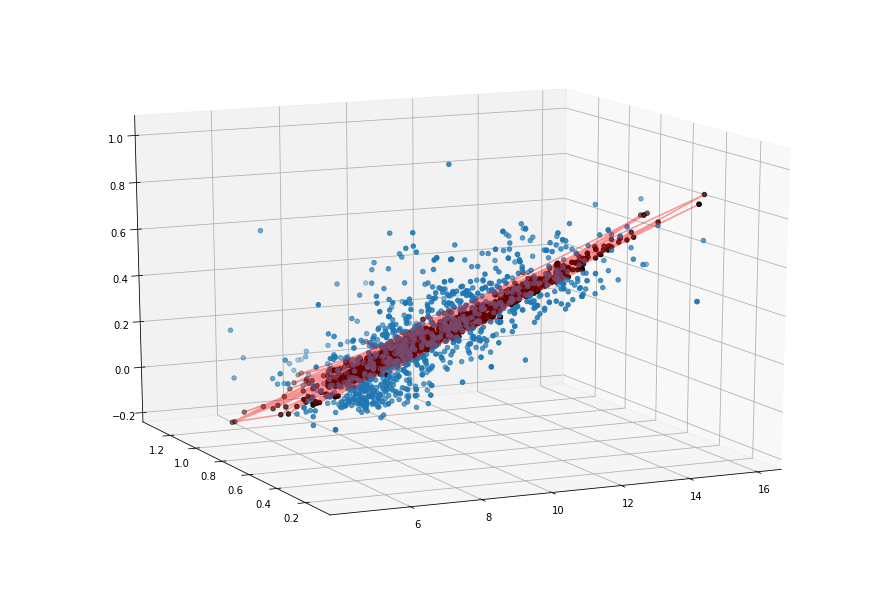

STEP: 8800, MSE: 0.0155, R2: 0.6084
Weights: [[ 0.06653851 -0.40102077]], Bias: [-0.07294663]


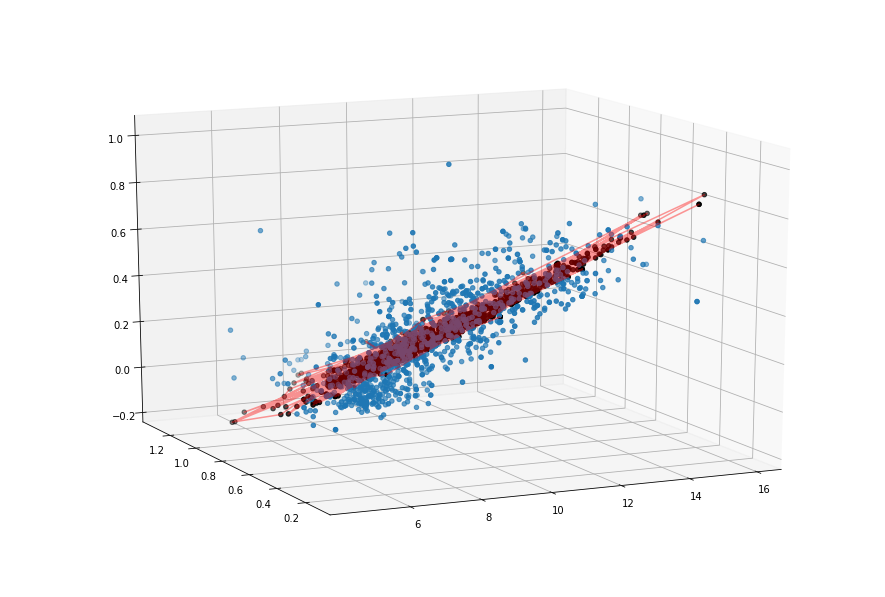

STEP: 8900, MSE: 0.0155, R2: 0.6085
Weights: [[ 0.06645152 -0.40213531]], Bias: [-0.07158945]


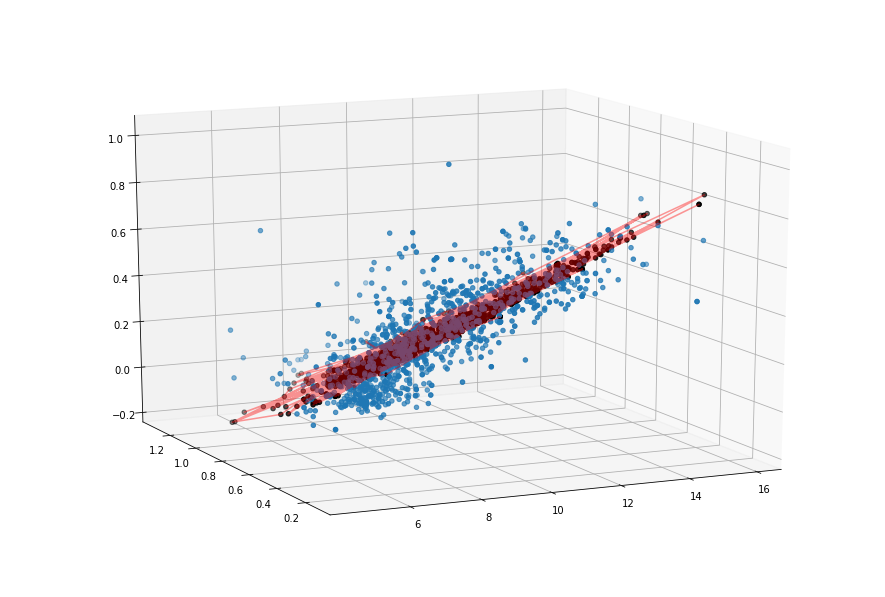

STEP: 9000, MSE: 0.0155, R2: 0.6086
Weights: [[ 0.06636716 -0.403216  ]], Bias: [-0.07027335]


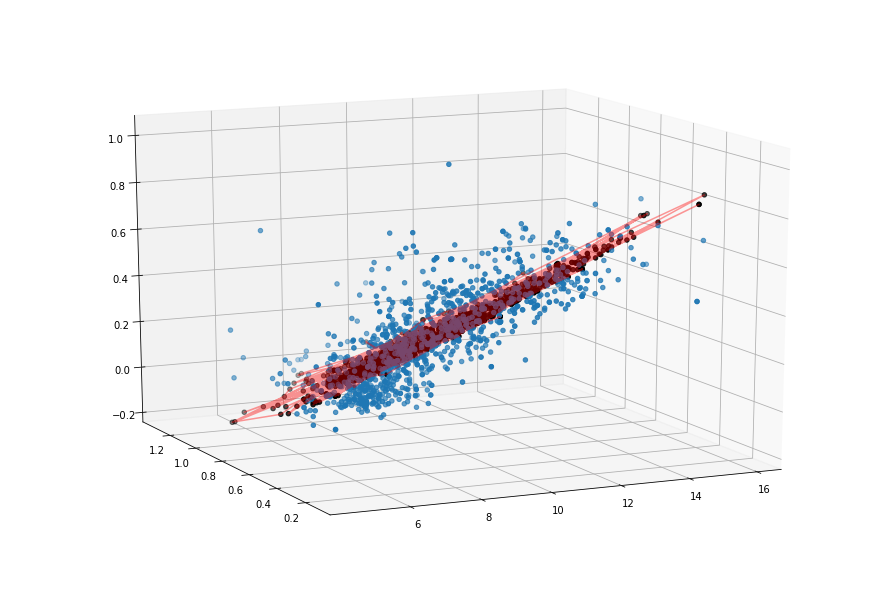

STEP: 9100, MSE: 0.0155, R2: 0.6086
Weights: [[ 0.06628535 -0.40426406]], Bias: [-0.0689971]


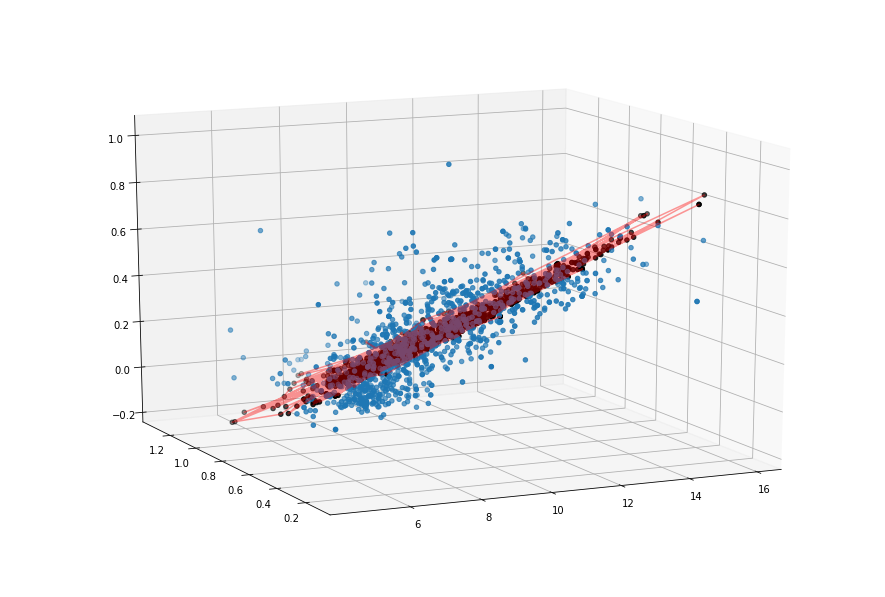

STEP: 9200, MSE: 0.0155, R2: 0.6087
Weights: [[ 0.06620603 -0.40528035]], Bias: [-0.06775956]


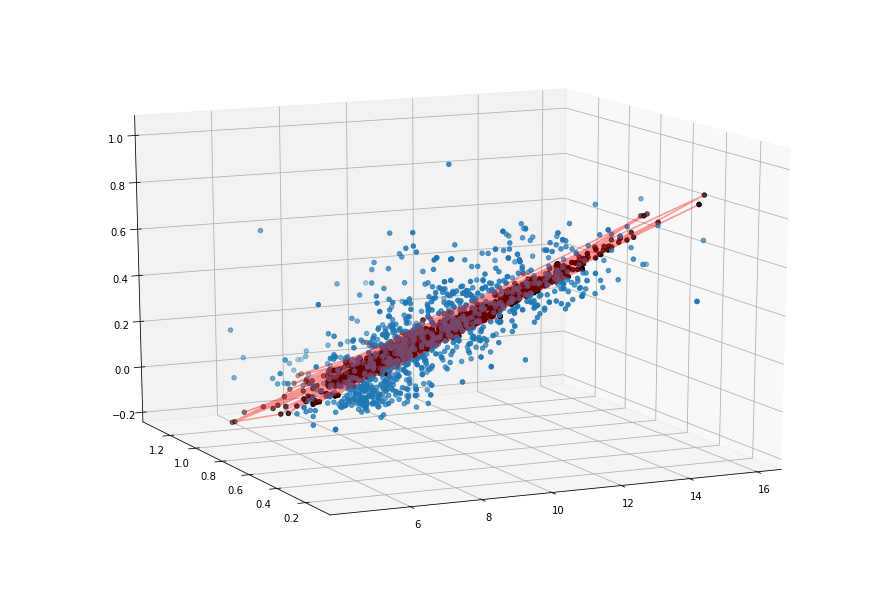

STEP: 9300, MSE: 0.0155, R2: 0.6088
Weights: [[ 0.0661291  -0.40626585]], Bias: [-0.06655949]


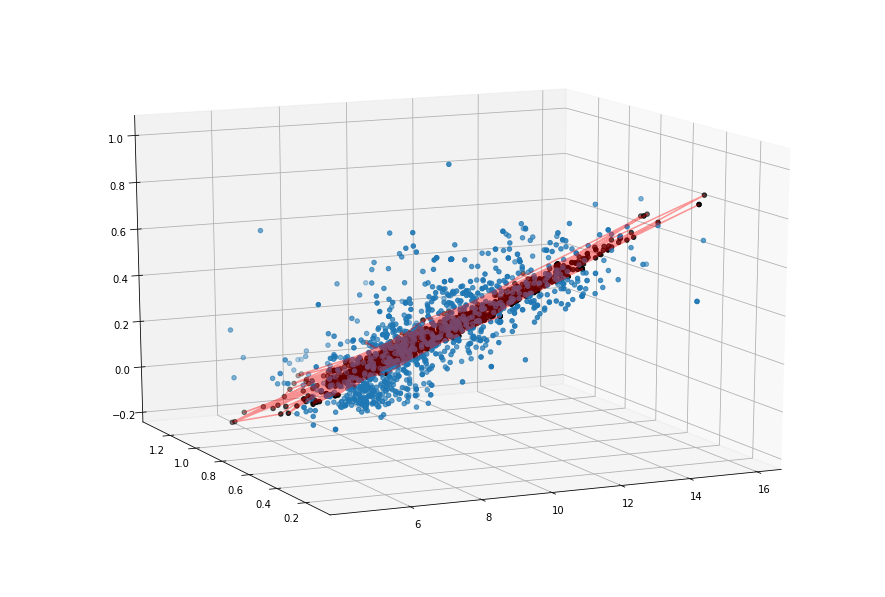

STEP: 9400, MSE: 0.0154, R2: 0.6088
Weights: [[ 0.0660545  -0.40722141]], Bias: [-0.06539576]


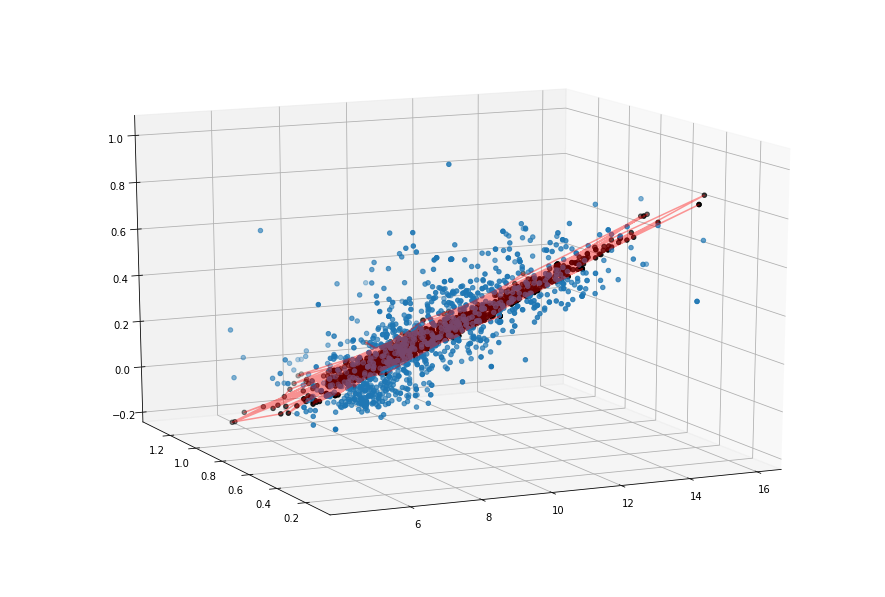

STEP: 9500, MSE: 0.0154, R2: 0.6089
Weights: [[ 0.06598218 -0.40814811]], Bias: [-0.06426726]


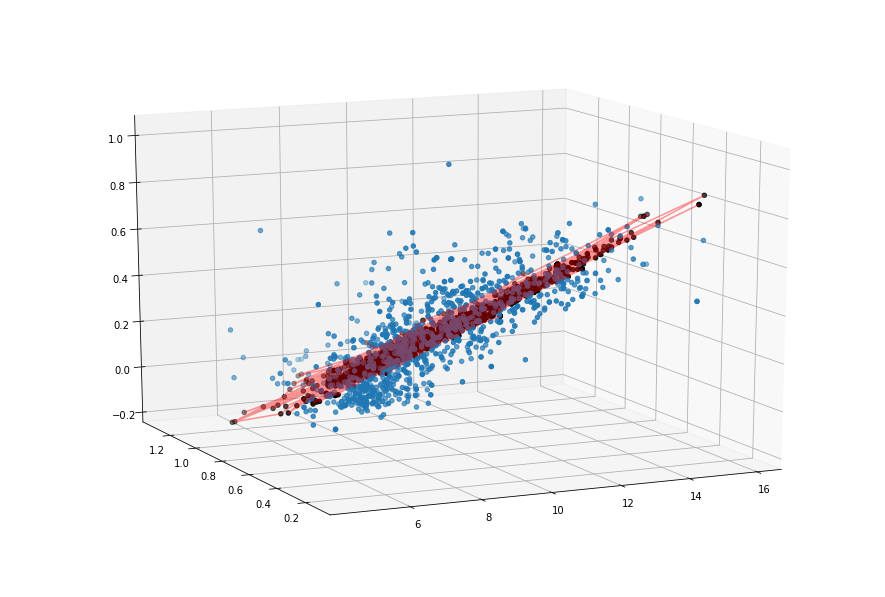

STEP: 9600, MSE: 0.0154, R2: 0.6089
Weights: [[ 0.06591202 -0.40904665]], Bias: [-0.06317296]


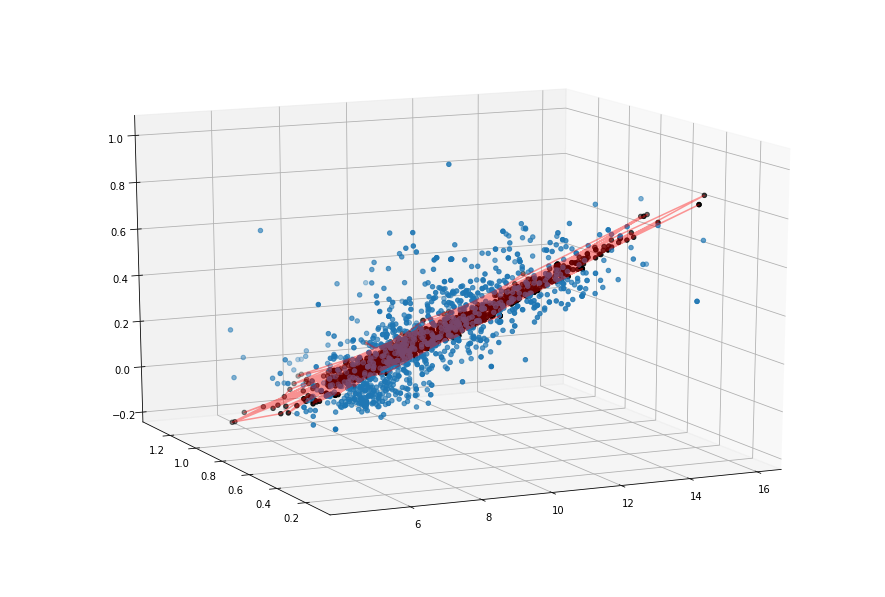

STEP: 9700, MSE: 0.0154, R2: 0.6090
Weights: [[ 0.065844   -0.40991801]], Bias: [-0.06211179]


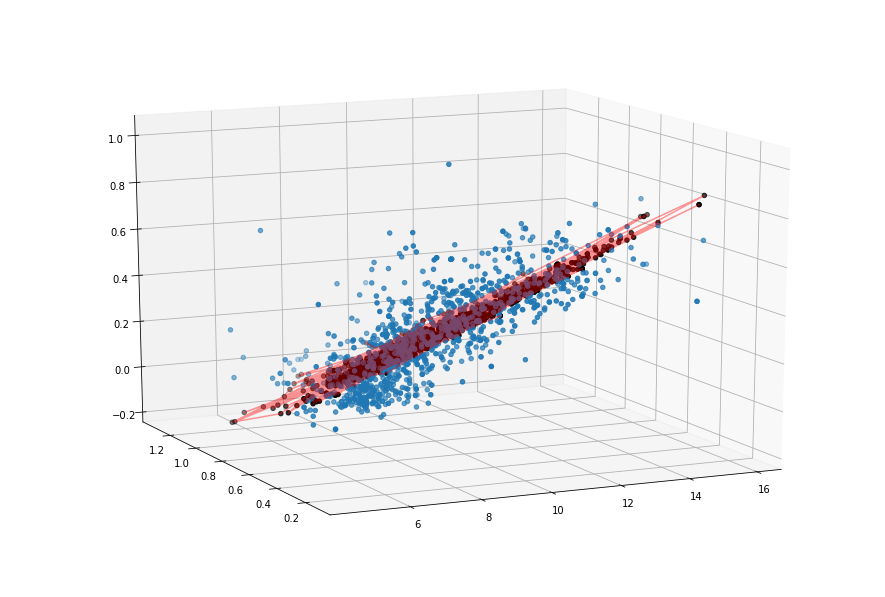

STEP: 9800, MSE: 0.0154, R2: 0.6090
Weights: [[ 0.06577804 -0.410763  ]], Bias: [-0.06108277]


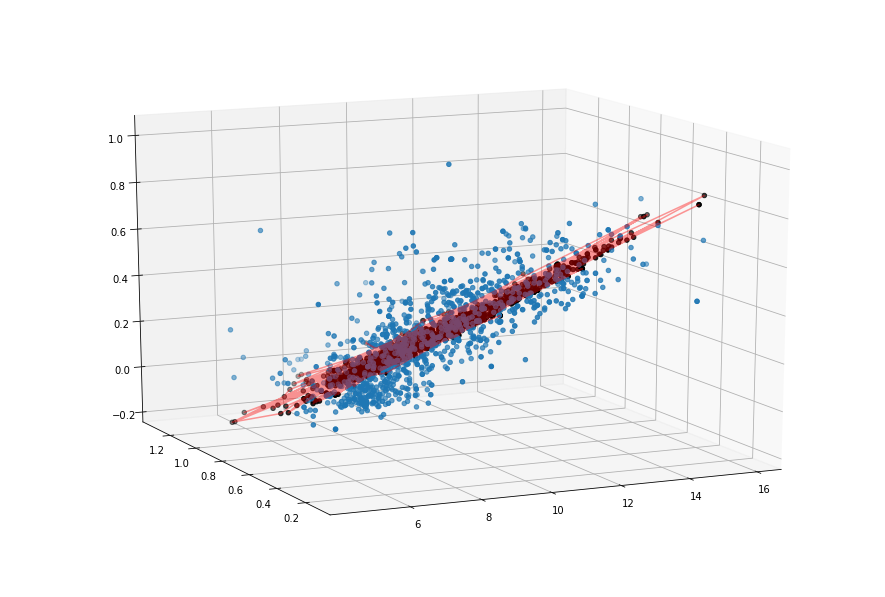

STEP: 9900, MSE: 0.0154, R2: 0.6091
Weights: [[ 0.06571408 -0.41158238]], Bias: [-0.0600849]


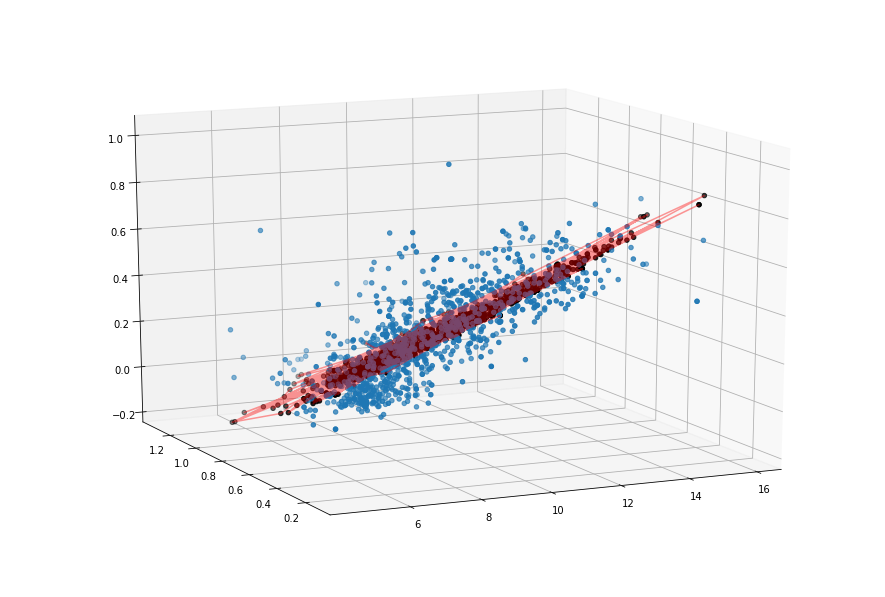

In [22]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X1: trainX1, Y_train: trainY}
        #sess.run(model1, feed_dict=feedDict)
        model1.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W1).reshape((1,nDim1)), sess.run(b1))
            print(msg0)
            print(msg1)
            
            fig = plt.figure(figsize=(12, 8))
            #ax = fig.add_subplot(111, projection='3d')
            ax = Axes3D(fig, azim=-115, elev=15)
            Z1 = trainX1 @ sess.run(W1) + sess.run(b1)
            
            ax.scatter(trainX1.T[0], trainX1.T[1], trainY)
            ax.scatter(trainX1.T[0], trainX1.T[1], Z1.T[0], color='black')
            ax.plot(trainX1.T[0], trainX1.T[1], Z1.T[0], color='red', alpha=.4)
            plt.show()
            #print(trainX1 @ sess.run(W1) + sess.run(b1))
            #plt.plot(trainX1[0], trainX1[1], trainY, c='r', marker='o', label='STEP: {step}'.format(step=step))
            #plt.plot(trainX1, trainX1 @sess.run(W1) + sess.run(b1))
            #plt.show()

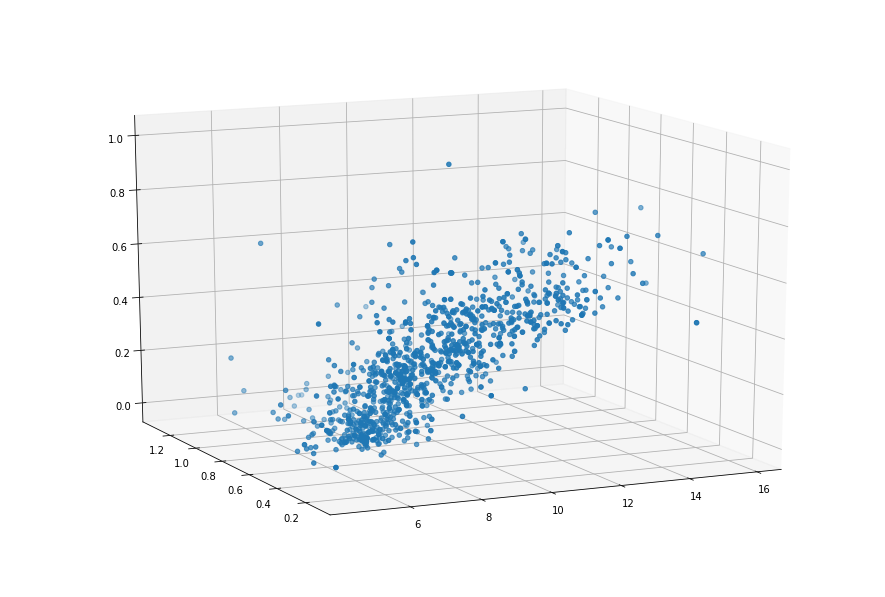

In [24]:
fig = plt.figure(figsize=(12, 8))
ax = Axes3D(fig, azim=-115, elev=15)

ax.scatter(trainX1.T[0], trainX1.T[1], trainY)
plt.show()

### Using `tf.placeholder`, 3 columns

In [25]:
# Variables
X2 = tf.placeholder(tf.float32, [None, nDim2])
Y_train = tf.placeholder(tf.float32, [None, 1])

W2 = tf.Variable(tf.random_normal([nDim2, 1]), name='weight')
b2 = tf.Variable(tf.random_normal([1]), name='bias')

In [27]:
y_pred_2 = tf.add(tf.matmul(X2, W2), b2)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred_2))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred_2)) / tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model2 = optimizer.minimize(costFunc)

In [30]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X2: trainX2, Y_train: trainY}
        #sess.run(model1, feed_dict=feedDict)
        model2.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W2).reshape((1,nDim2)), sess.run(b2))
            print(msg0)
            print(msg1)

STEP:   0, MSE: 2.6498, R2: -66.0960
Weights: [[-0.00401714 -0.80501282  0.99142623]], Bias: [-0.91403085]
STEP: 100, MSE: 0.0472, R2: -0.1956
Weights: [[ 0.00400219 -0.86972821  0.53619492]], Bias: [-1.0278132]
STEP: 200, MSE: 0.0259, R2: 0.3430
Weights: [[ 0.05328938 -0.86877608  0.40957528]], Bias: [-1.05639648]
STEP: 300, MSE: 0.0233, R2: 0.4089
Weights: [[ 0.06869192 -0.85134882  0.36691716]], Bias: [-1.0639962]
STEP: 400, MSE: 0.0226, R2: 0.4289
Weights: [[ 0.0736903  -0.82981431  0.35017982]], Bias: [-1.06512618]
STEP: 500, MSE: 0.0220, R2: 0.4430
Weights: [[ 0.07548252 -0.80791181  0.3415629 ]], Bias: [-1.0642364]
STEP: 600, MSE: 0.0215, R2: 0.4554
Weights: [[ 0.07627597 -0.78673875  0.33560035]], Bias: [-1.06269276]
STEP: 700, MSE: 0.0211, R2: 0.4664
Weights: [[ 0.07674799 -0.76658469  0.33060795]], Bias: [-1.0609163]
STEP: 800, MSE: 0.0207, R2: 0.4762
Weights: [[ 0.07710722 -0.747495    0.32606056]], Bias: [-1.05903816]
STEP: 900, MSE: 0.0203, R2: 0.4850
Weights: [[ 0.0774182

Done.